# Crime Data Analysis for Baltimore, MD


# Overview  

In this project I am working with data from the Baltimore Open Data website, which can be seen at this webpage; [https://data.baltimorecity.gov/Public-Safety/BPD-Part-1-Victim-Based-Crime-Data/wsfq-mvij](https://data.baltimorecity.gov/Public-Safety/BPD-Part-1-Victim-Based-Crime-Data/wsfq-mvij).  

I am trying to predict which areas and what times crimes are most likely to occur, in order to know where to deploy law enforcement to prevent them.

This is based on a report done which showed that on average, crimes that occur outside were reduced by about 15% when there was an increase of about 50% in the law enforcement on the streets.  
That report can be read in this PDF; [https://mason.gmu.edu/~atabarro/TerrorAlertProofs.pdf](https://mason.gmu.edu/~atabarro/TerrorAlertProofs.pdf)


### City of Baltimore, MD

I will be looking at crime by neighborhood in the city of Baltimore, MD, of which there are 278 neighborhoods.   

<details><summary>Map of Neighborhoods in Baltimore, MD</summary>
<img src='Map_of_Baltimore.png'>
</details>


## Findings

With the data I had or was able to look up and find, I was unable to predict the area or time a crime would occur. I do believe that further work into this with more data about crime, may be able to get a good enough prediction to help deploy law enforcement to be able to reduce crimes that occur outside. Unfortunately, it was not something I was currently able to do with the data I had.  

**Due to this, I have added hyperlinks in the EDA section so you can navigate to the different parts of it if you would like to.**  

## Dashboard

I made a dashboard for this information with Tableau, which can be seen at this link: [https://public.tableau.com/profile/levi.raichik#!/vizhome/BaltimoreMDCrimeData/Dashboard1](https://public.tableau.com/profile/levi.raichik#!/vizhome/BaltimoreMDCrimeData/Dashboard1).  
It allows you to filter based on crime, date, time, neighborhood and whether a crime occured inside or outside.  
There is a map there which will then shade neighborhoods based on the amount of crime that occured there.  
You will also see a line plot underneath that about the information you are viewing.  
Both are clickable to be able to see only one neighborhood, or only one date for the map.  
  
Here is what it looks like:  
<img src='Dashboard.png'>

# Table of Contents
- [Import Libraries](#Import-Libraries)

- [Obtain Data](#Obtain-Data)
    - [Import data](#Import-data)
- [Scrub Data](#Scrub-Data)
- [EDA](#EDA)
    * [Check which neighborhoods have the most crime occuring outside](#Check-which-neighborhoods-have-the-most-crime-occuring-outside)
    * [Checkout neigborhoods by time slot](#Checkout-neigborhoods-by-time-slot)
    * [Put the information into an easier dataframe to work with](#Put-the-information-into-an-easier-dataframe-to-work-with)
    * [Make a dataframe with date and time as a datetime index](#Make-a-dataframe-with-date-and-time-as-a-datetime-index)
    * [Checkout Crime in each neighborhood with date and time slot in a time series plot](#Checkout-Crime-in-each-neighborhood-with-date-and-time-slot-in-a-time-series-plot)
    * [Zeroing in on downtown area, the highest crime area](#Zeroing-in-on-downtown-area,-the-highest-crime-area)
    * [Trying to find trends for the entire city overall](#Trying-to-find-trends-for-the-entire-city-overall)
    * [Checking trends for each neighborhood separately](#Checking-trends-for-each-neighborhood-separately)
    * [Finding neighborhoods with more overall crime](#Finding-neighborhoods-with-more-overall-crime)
    * [Make a DataFrame for Downtown with date and time information to try to find out what I can from it](#Make-a-DataFrame-for-Downtown-with-date-and-time-information-to-try-to-find-out-what-I-can-from-it)
    * [Zeroing in on a few months in which there were spikes of crime](#Zeroing-in-on-a-few-months-in-which-there-were-spikes-of-crime)
    * [Using FaceBook Prophet to see what trends I can find](#Using-FaceBook-Prophet-to-see-what-trends-I-can-find)
- [Modeling](#Modeling)

# Import Libraries

In [214]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import datetime as dt
from shapely.geometry import Point, Polygon, MultiPolygon
import geopandas as gpd
from opencage.geocoder import OpenCageGeocode, InvalidInputError, RateLimitExceededError, UnknownError
from pprint import pprint
import json
import requests
import time
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from fbprophet import Prophet as proph
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold
from sklearn.metrics import classification_report, confusion_matrix, recall_score, precision_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import OneHotEncoder, label_binarize, LabelEncoder

[Return to contents](#Table-of-Contents)

# Functions

[Return to contents](#Table-of-Contents)

# Obtain Data

[Return to contents](#Table-of-Contents)

# Scrub Data

[Return to contents](#Table-of-Contents)

# EDA

### Read in the cleaned data

In [393]:
df = pd.read_csv('Baltimore_crime_cleaned.csv')
df.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise
0,09/07/2019,08:53:00,4E,1000 N MOUNT ST,COMMON ASSAULT,I,none,743.0,WESTERN,Sandtown-Winchester,-76.644485,39.300357,ROW/TOWNHOUSE-OCC
1,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET
2,09/07/2019,23:22:33,9S,2900 JEFFERSON ST,SHOOTING,O,FIREARM,224.0,SOUTHEAST,Ellwood Park/Monument,-76.576075,39.297009,STREET
3,09/07/2019,22:59:00,7A,1100 N PATTERSON PARK AVE,AUTO THEFT,O,none,322.0,EASTERN,Middle East,-76.585487,39.303928,STREET
4,09/07/2019,00:15:00,6G,100 ALLENDALE ST,LARCENY,I,none,843.0,SOUTHWEST,Allendale,-76.678216,39.290278,ROW/TOWNHOUSE-OCC


In [394]:
for index, row in df[df['Neighborhood'] == 'CARE'].iterrows():
    df.at[index, 'Neighborhood'] = 'Care'

In [395]:
index_to_drop = df[df.Neighborhood.str.isupper()].index

In [396]:
df.drop(index_to_drop, axis= 0, inplace=True)

### Group time into a new column with categories

In [397]:
df['TimeSlot'] = '100'

In [398]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 273523 entries, 0 to 273802
Data columns (total 14 columns):
CrimeDate         273523 non-null object
CrimeTime         273523 non-null object
CrimeCode         273523 non-null object
Location          273523 non-null object
Description       273523 non-null object
Inside/Outside    273523 non-null object
Weapon            273523 non-null object
Post              273523 non-null object
District          273523 non-null object
Neighborhood      273523 non-null object
Longitude         273523 non-null float64
Latitude          273523 non-null float64
Premise           273523 non-null object
TimeSlot          273523 non-null object
dtypes: float64(2), object(12)
memory usage: 31.3+ MB


In [399]:
int(df.CrimeTime[0][:2]) >= 6 and int(df.CrimeTime[0][:2]) <= 8

True

In [478]:
"{:02d}".format(12)

for i in range(24):
    k = "{:02d}".format(i)
    v = i//3*3
    v = "{:02d}:00:00".format(v)
    print(k, v)

00 00:00:00
01 00:00:00
02 00:00:00
03 03:00:00
04 03:00:00
05 03:00:00
06 06:00:00
07 06:00:00
08 06:00:00
09 09:00:00
10 09:00:00
11 09:00:00
12 12:00:00
13 12:00:00
14 12:00:00
15 15:00:00
16 15:00:00
17 15:00:00
18 18:00:00
19 18:00:00
20 18:00:00
21 21:00:00
22 21:00:00
23 21:00:00


In [ ]:
time_slots = {'00': '00:00:00', '01': '00:00:00'}

df['CrimeTime'].apply(lambda v: time_slots[v])

In [400]:
for index, row in df.iterrows():
    if int(row['CrimeTime'][:2]) >= 0 and int(row['CrimeTime'][:2]) <= 2:
        df.at[index, 'TimeSlot'] = '00:00:00'
    
    elif int(row['CrimeTime'][:2]) >= 3 and int(row['CrimeTime'][:2]) <= 5:
        df.at[index, 'TimeSlot'] = '03:00:00'
    
    elif int(row['CrimeTime'][:2]) >= 6 and int(row['CrimeTime'][:2]) <= 8:
        df.at[index, 'TimeSlot'] = '06:00:00'
    
    elif int(row['CrimeTime'][:2]) >= 9 and int(row['CrimeTime'][:2]) <= 11:
        df.at[index, 'TimeSlot'] = '09:00:00'

    elif int(row['CrimeTime'][:2]) >= 12 and int(row['CrimeTime'][:2]) <= 14:
        df.at[index, 'TimeSlot'] = '12:00:00'

    elif int(row['CrimeTime'][:2]) >= 15 and int(row['CrimeTime'][:2]) <= 17:
        df.at[index, 'TimeSlot'] = '15:00:00'

    elif int(row['CrimeTime'][:2]) >= 18 and int(row['CrimeTime'][:2]) <= 20:
        df.at[index, 'TimeSlot'] = '18:00:00'

    elif int(row['CrimeTime'][:2]) >= 21 and int(row['CrimeTime'][:2]) <= 23:
        df.at[index, 'TimeSlot'] = '21:00:00'
    
    else:
        print(index)

In [401]:
df.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot
0,09/07/2019,08:53:00,4E,1000 N MOUNT ST,COMMON ASSAULT,I,none,743.0,WESTERN,Sandtown-Winchester,-76.644485,39.300357,ROW/TOWNHOUSE-OCC,06:00:00
1,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET,15:00:00
2,09/07/2019,23:22:33,9S,2900 JEFFERSON ST,SHOOTING,O,FIREARM,224.0,SOUTHEAST,Ellwood Park/Monument,-76.576075,39.297009,STREET,21:00:00
3,09/07/2019,22:59:00,7A,1100 N PATTERSON PARK AVE,AUTO THEFT,O,none,322.0,EASTERN,Middle East,-76.585487,39.303928,STREET,21:00:00
4,09/07/2019,00:15:00,6G,100 ALLENDALE ST,LARCENY,I,none,843.0,SOUTHWEST,Allendale,-76.678216,39.290278,ROW/TOWNHOUSE-OCC,00:00:00


In [402]:
df['DateTime'] = df['CrimeDate'] + ' ' +  df['TimeSlot']

In [403]:
df.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,DateTime
0,09/07/2019,08:53:00,4E,1000 N MOUNT ST,COMMON ASSAULT,I,none,743.0,WESTERN,Sandtown-Winchester,-76.644485,39.300357,ROW/TOWNHOUSE-OCC,06:00:00,09/07/2019 06:00:00
1,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET,15:00:00,09/07/2019 15:00:00
2,09/07/2019,23:22:33,9S,2900 JEFFERSON ST,SHOOTING,O,FIREARM,224.0,SOUTHEAST,Ellwood Park/Monument,-76.576075,39.297009,STREET,21:00:00,09/07/2019 21:00:00
3,09/07/2019,22:59:00,7A,1100 N PATTERSON PARK AVE,AUTO THEFT,O,none,322.0,EASTERN,Middle East,-76.585487,39.303928,STREET,21:00:00,09/07/2019 21:00:00
4,09/07/2019,00:15:00,6G,100 ALLENDALE ST,LARCENY,I,none,843.0,SOUTHWEST,Allendale,-76.678216,39.290278,ROW/TOWNHOUSE-OCC,00:00:00,09/07/2019 00:00:00


In [404]:
df['Count'] = 1

### Check which neighborhoods have the most crime occuring outside

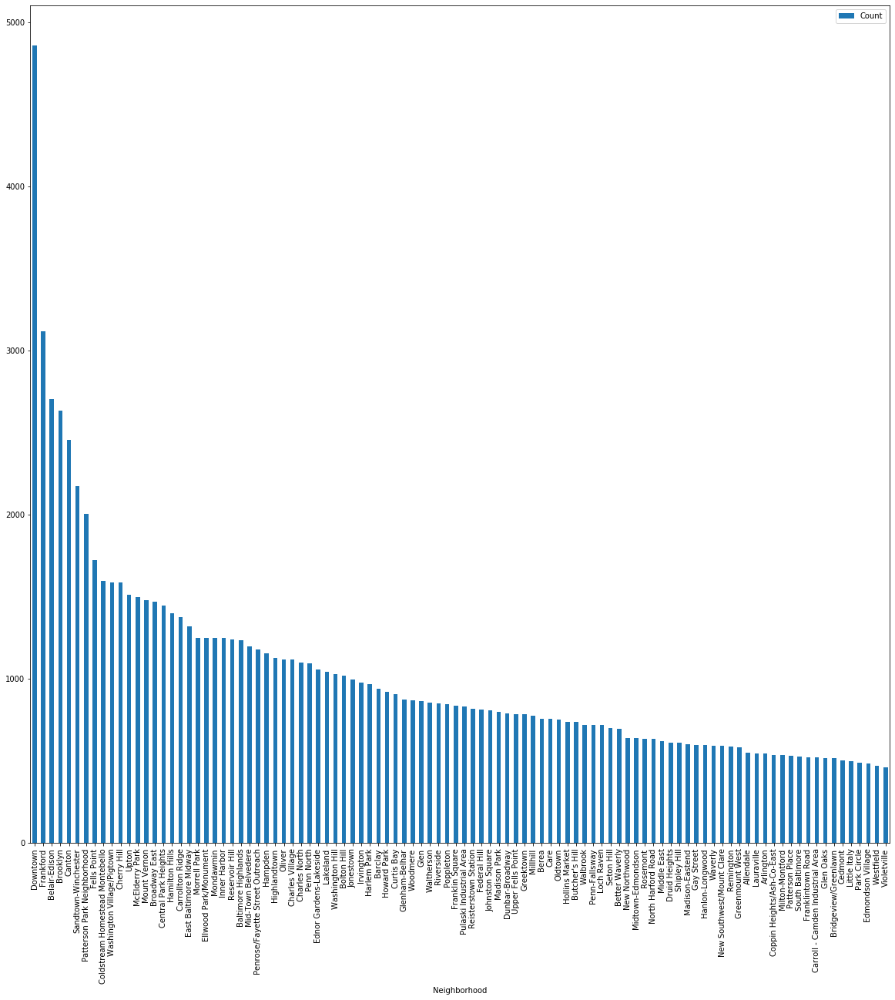

In [14]:
df[df['Inside/Outside'] == 'O'].groupby(['Neighborhood']).sum().drop(['Longitude', 'Latitude'], axis=1).sort_values(by='Count', ascending=False).head(100).plot.bar(figsize=(20,20))

In [15]:
count_df = df[df['Inside/Outside'] == 'O'].groupby(['Neighborhood']).sum().drop(['Longitude', 'Latitude'], axis=1).sort_values(by='Count', ascending=False)

In [16]:
count_df.describe()

,Count
count,277.000000
mean,513.335740
std,551.129676
min,3.000000
25%,186.000000
50%,360.000000
75%,640.000000
max,4860.000000


In [17]:
count_df.shape

(277, 1)

In [18]:
count_df[count_df['Count'] > 500][:50]

,Count
Neighborhood,
Downtown,4860
Frankford,3117
Belair-Edison,2703
Brooklyn,2632
Canton,2457
Sandtown-Winchester,2175
Patterson Park Neighborhood,2004
Fells Point,1722
Coldstream Homestead Montebello,1598


[Return to contents](#Table-of-Contents)

### Checkout neigborhoods by time slot

In [19]:
count_time_df = df[df['Inside/Outside'] == 'O'].groupby(['Neighborhood', 'TimeSlot']).sum().drop(['Longitude', 'Latitude'], axis=1).sort_values('Count')

In [20]:
count_time_df.unstack(fill_value=0)

Count                                               \
TimeSlot          00:00:00 03:00:00 06:00:00 09:00:00 12:00:00 15:00:00   
Neighborhood                                                              
Abell                   67       18        9       30       39       49   
Allendale               68       21       47       54       61       97   
Arcadia                 24        8        8       20       15       27   
Arlington               64       33       30       43       77       95   
Armistead Gardens       56       18       24       33       34       58   
...                    ...      ...      ...      ...      ...      ...   
Wrenlane                 8        0        6        4        5       16   
Wyman Park              15        8        9       19       12       33   
Wyndhurst                7        0        7        7       14       17   
Yale Heights            43       13       36       32       40       56   
York-Homeland            8        1        4        5       12       13   

                                     
TimeSlot          18:00:00 21:00:00  
Neighborhood                         
Abell                   67       74  
Allendale               94      107  
Arcadia                 37       39  
Arlington               92      110  
Armistead Gardens       69       90  
...                    ...      ...  
Wrenlane                15       20  
Wyman Park              53       37  
Wyndhurst               10       15  
Yale Heights            74       83  
York-Homeland           15       17  

[277 rows x 8 columns]

In [21]:
df.groupby(['Neighborhood', 'TimeSlot']).sum().drop(['Longitude', 'Latitude'], axis=1).sort_values('Count', ascending=False)

Count
Neighborhood      TimeSlot       
Downtown          15:00:00   1582
                  00:00:00   1391
                  12:00:00   1372
                  18:00:00   1265
                  21:00:00   1206
...                           ...
Mt Pleasant Park  03:00:00      1
Cedarcroft        03:00:00      1
The Orchards      00:00:00      1
Mt Pleasant Park  06:00:00      1
Loyola/Notre Dame 03:00:00      1

[2210 rows x 1 columns]

In [22]:
df[(df['Inside/Outside'] == 'O') & (df['Neighborhood'] == 'Downtown') & (df['TimeSlot'] == '00:00:00')]['Count'].sum()

806

In [23]:
count_time_df.describe()

,Count
count,2199.000000
mean,64.663029
std,79.955360
min,1.000000
25%,18.000000
50%,38.000000
75%,79.000000
max,867.000000


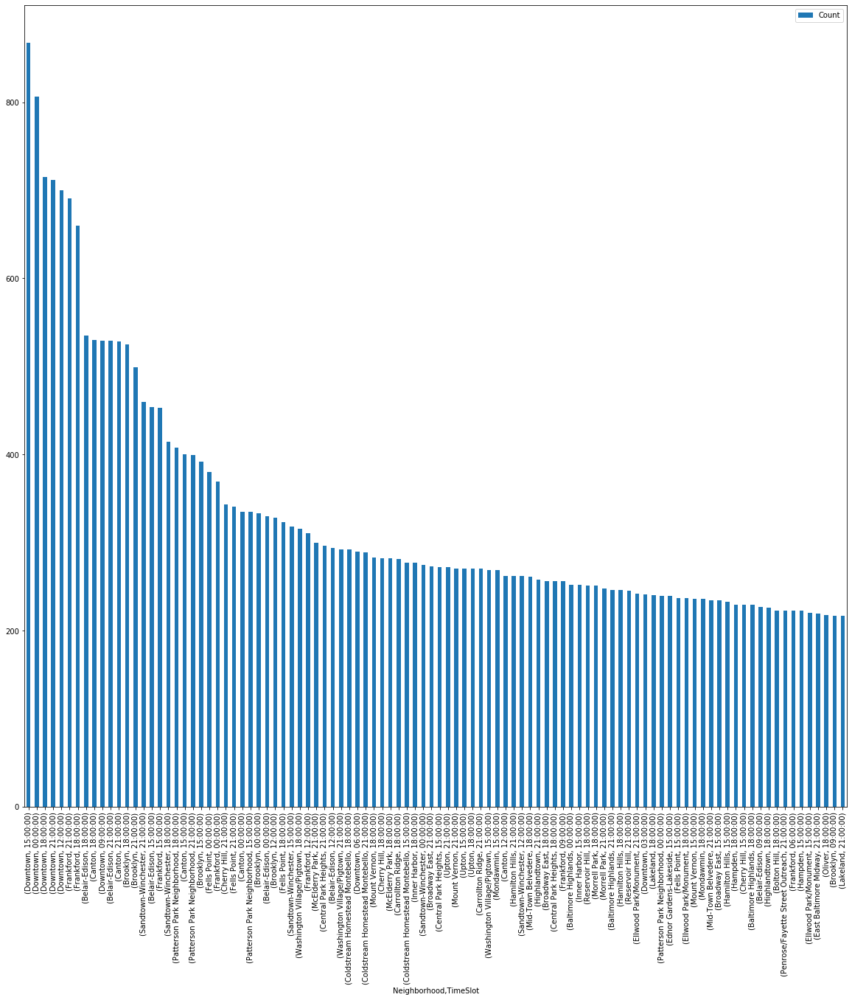

In [24]:
count_time_df.sort_values(by='Count', ascending=False).head(100).plot.bar(figsize=(20,20))

[Return to contents](#Table-of-Contents)

### Put the information into an easier dataframe to work with

In [25]:
neighborhoods = {}
times = {}
total = {}

for neighborhood in df.Neighborhood.unique():
    for time in df.TimeSlot.unique():
        total[f'{neighborhood}_{time}'] = df[(df['Neighborhood'] == neighborhood) & (df['TimeSlot'] == time)]['Count'].sum()
        neighborhoods[f'{neighborhood}_{time}'] = neighborhood
        times[f'{neighborhood}_{time}'] = time

count_by_time = pd.DataFrame()
count_by_time['Neighborhood'] = neighborhoods.values()
count_by_time['TimeSlot'] = times.values()
count_by_time['Count'] = total.values()

In [26]:
count_by_time['Neighborhood_with_time'] = count_by_time['Neighborhood'] + ' ' + count_by_time['TimeSlot']

In [27]:
count_by_time.head()

,Neighborhood,TimeSlot,Count,Neighborhood_with_time
0,Sandtown-Winchester,06:00:00,298,Sandtown-Winchester 06:00:00
1,Sandtown-Winchester,15:00:00,601,Sandtown-Winchester 15:00:00
2,Sandtown-Winchester,21:00:00,716,Sandtown-Winchester 21:00:00
3,Sandtown-Winchester,00:00:00,486,Sandtown-Winchester 00:00:00
4,Sandtown-Winchester,18:00:00,689,Sandtown-Winchester 18:00:00


In [28]:
count_by_time.describe()

,Count
count,2224.00000
mean,122.98696
std,148.45891
min,0.00000
25%,34.00000
50%,76.50000
75%,150.25000
max,1582.00000


Plot all crime by neighborhood and time

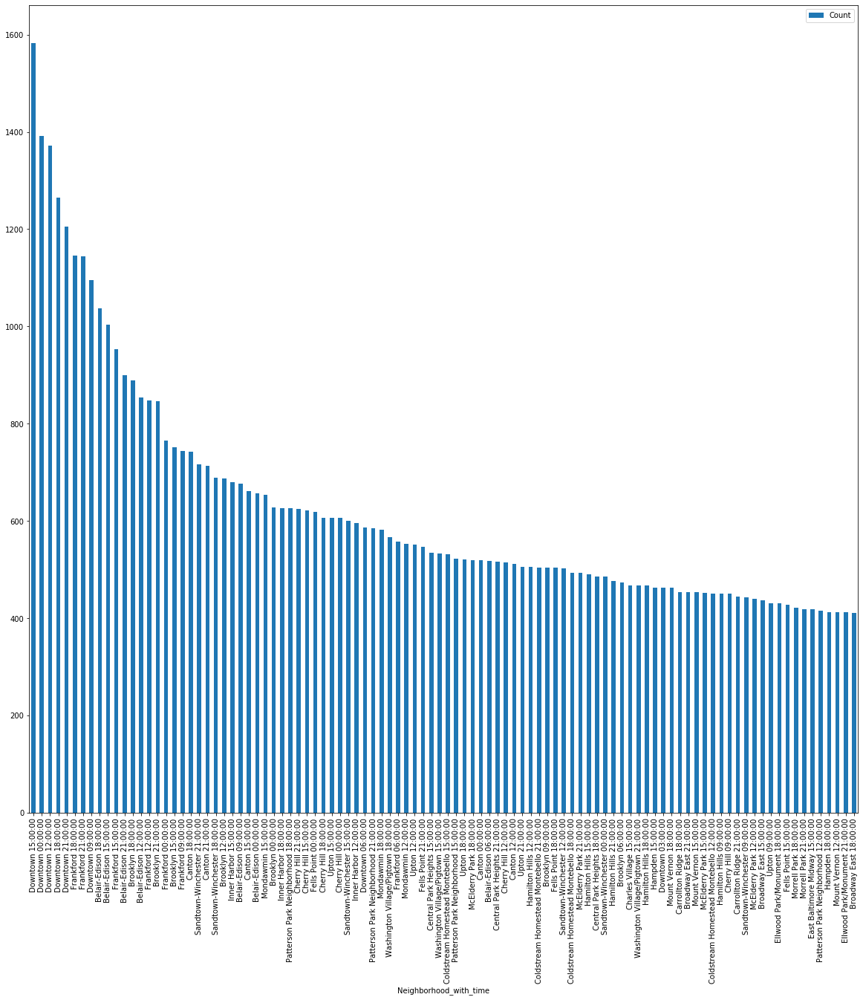

In [29]:
count_by_time.sort_values(by='Count', ascending=False).head(100).plot.bar(figsize=(20,20), x = 'Neighborhood_with_time')

Make a dataframe for only outside crime by time slot

In [30]:
neighborhoods_out = {}
times_out = {}
total_out = {}

for neighborhood in df.Neighborhood.unique():
    for time in df.TimeSlot.unique():
        total_out[f'{neighborhood}_{time}'] = df[(df['Inside/Outside'] == 'O') & (df['Neighborhood'] == neighborhood) & (df['TimeSlot'] == time)]['Count'].sum()
        neighborhoods_out[f'{neighborhood}_{time}'] = neighborhood
        times_out[f'{neighborhood}_{time}'] = time

count_by_time_out = pd.DataFrame()
count_by_time_out['Neighborhood'] = neighborhoods_out.values()
count_by_time_out['TimeSlot'] = times_out.values()
count_by_time_out['Count'] = total_out.values()

In [31]:
count_by_time_out['Neighborhood_with_time'] = count_by_time_out['Neighborhood'] + ' ' + count_by_time_out['TimeSlot']

In [32]:
count_by_time_out.describe()

,Count
count,2224.000000
mean,63.936151
std,79.796364
min,0.000000
25%,17.000000
50%,38.000000
75%,79.000000
max,867.000000


In [33]:
count_by_time_out.head()

,Neighborhood,TimeSlot,Count,Neighborhood_with_time
0,Sandtown-Winchester,06:00:00,141,Sandtown-Winchester 06:00:00
1,Sandtown-Winchester,15:00:00,318,Sandtown-Winchester 15:00:00
2,Sandtown-Winchester,21:00:00,460,Sandtown-Winchester 21:00:00
3,Sandtown-Winchester,00:00:00,275,Sandtown-Winchester 00:00:00
4,Sandtown-Winchester,18:00:00,414,Sandtown-Winchester 18:00:00


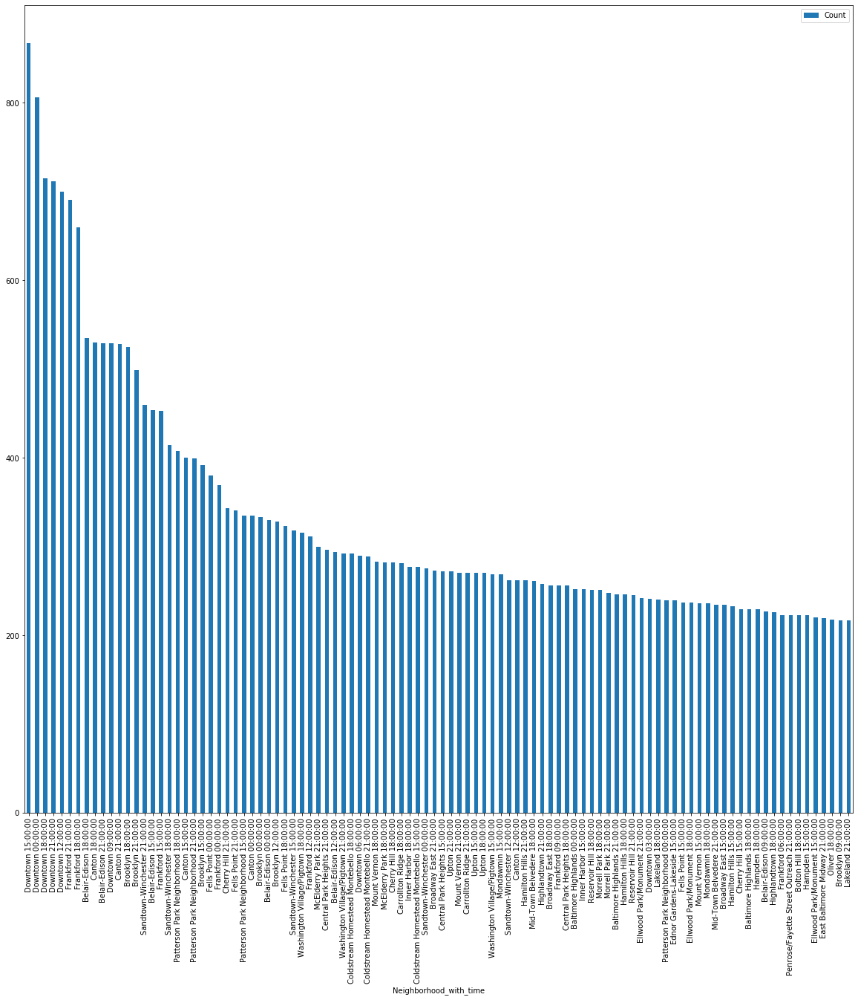

In [34]:
count_by_time_out.sort_values(by='Count', ascending=False).head(100).plot.bar(figsize=(20,20), x = 'Neighborhood_with_time')

[Return to contents](#Table-of-Contents)

### Make a dataframe with date and time as a datetime index

In [405]:
df['DateTime'] = pd.to_datetime(df['DateTime'], format='%m/%d/%Y %H:%M:%S')

In [36]:
df_datetime = df.set_index('DateTime')

In [37]:
df_datetime.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,Count
DateTime,,,,,,,,,,,,,,,
2019-09-07 06:00:00,09/07/2019,08:53:00,4E,1000 N MOUNT ST,COMMON ASSAULT,I,none,743.0,WESTERN,Sandtown-Winchester,-76.644485,39.300357,ROW/TOWNHOUSE-OCC,06:00:00,1
2019-09-07 15:00:00,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET,15:00:00,1
2019-09-07 21:00:00,09/07/2019,23:22:33,9S,2900 JEFFERSON ST,SHOOTING,O,FIREARM,224.0,SOUTHEAST,Ellwood Park/Monument,-76.576075,39.297009,STREET,21:00:00,1
2019-09-07 21:00:00,09/07/2019,22:59:00,7A,1100 N PATTERSON PARK AVE,AUTO THEFT,O,none,322.0,EASTERN,Middle East,-76.585487,39.303928,STREET,21:00:00,1
2019-09-07 00:00:00,09/07/2019,00:15:00,6G,100 ALLENDALE ST,LARCENY,I,none,843.0,SOUTHWEST,Allendale,-76.678216,39.290278,ROW/TOWNHOUSE-OCC,00:00:00,1


[Return to contents](#Table-of-Contents)

### Checkout Crime in each neighborhood with date and time slot in a time series plot

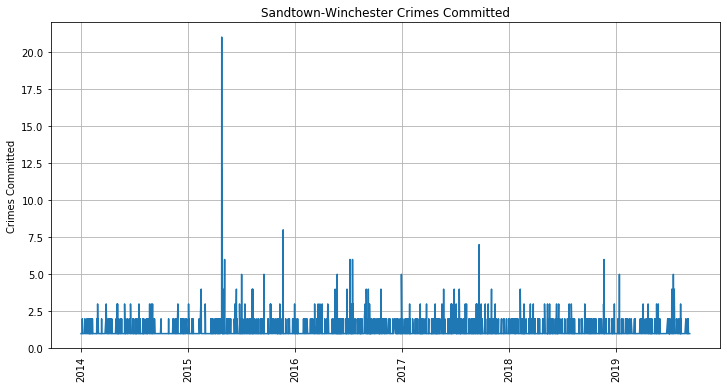

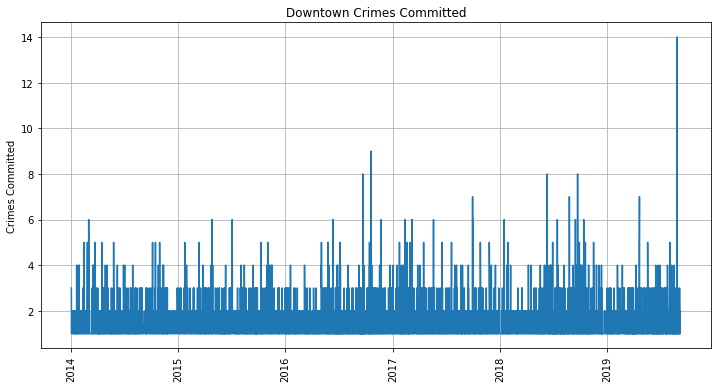

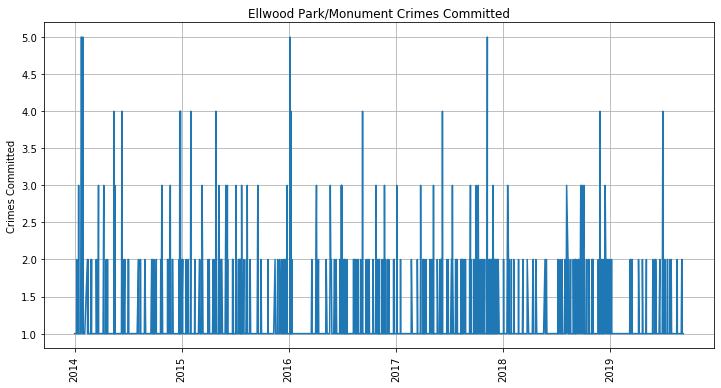

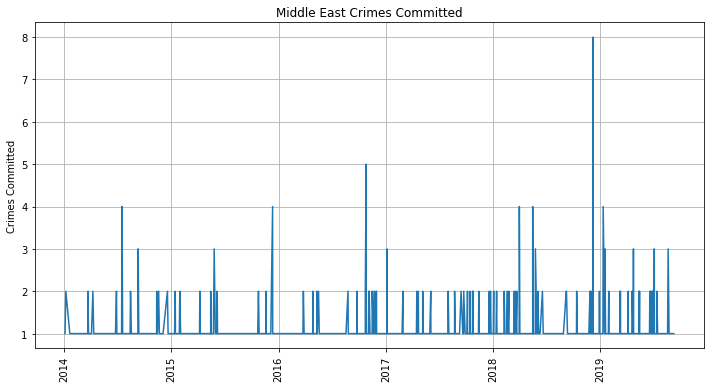

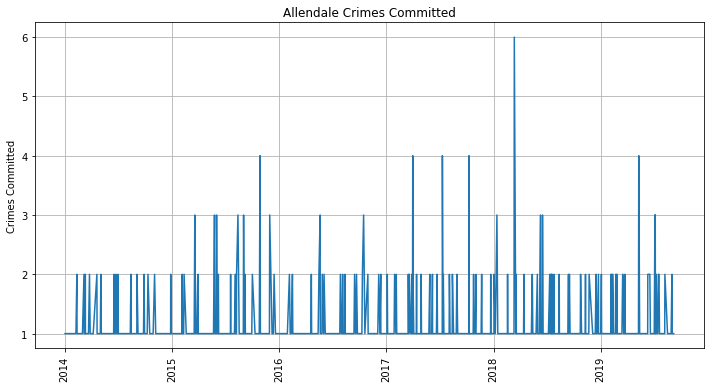

...

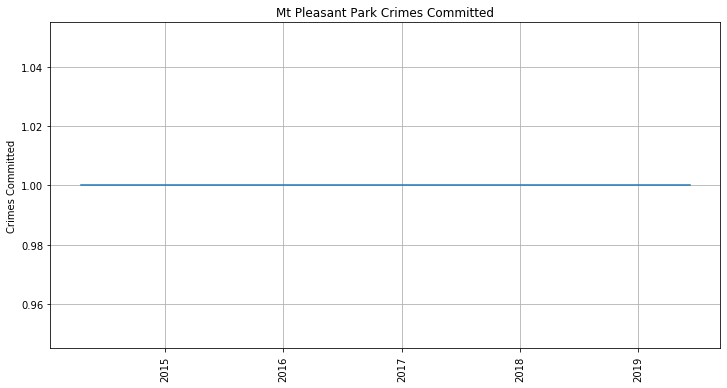

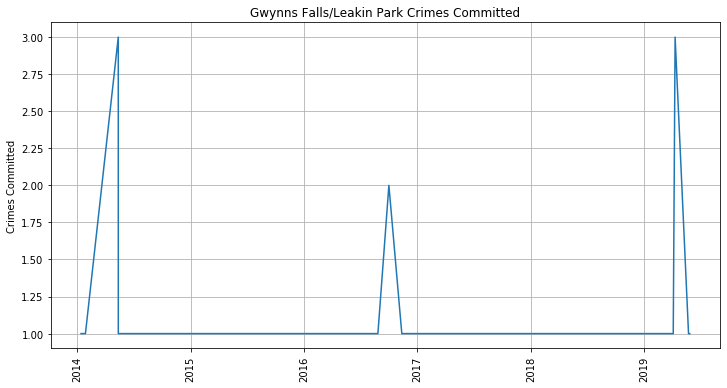

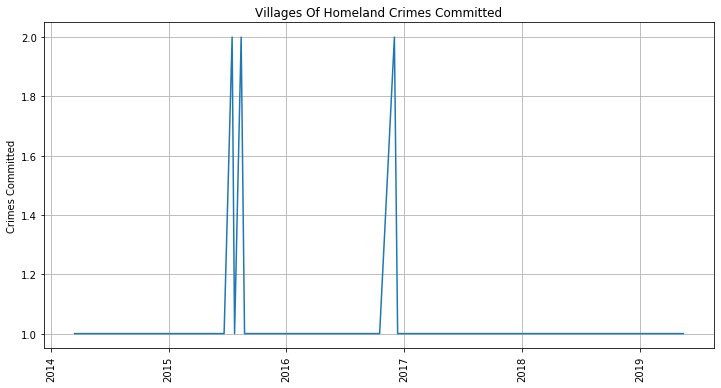

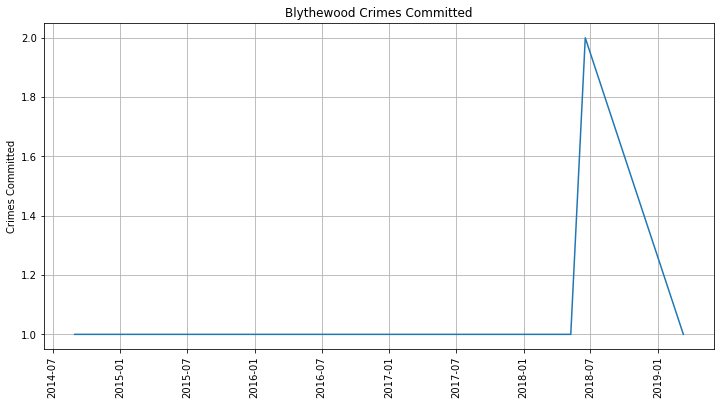

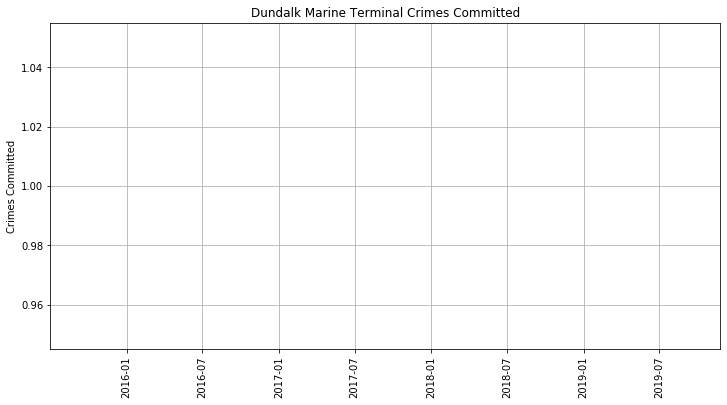

In [445]:
for neighborhood in df_datetime.Neighborhood.unique():
    sliced = df_datetime[df_datetime['Neighborhood'] == neighborhood].groupby('DateTime').sum()['Count']['2014':]
    plt.figure(figsize=(12,6))
    plt.plot(sliced)
    plt.title(f'{neighborhood} Crimes Committed')
    plt.ylabel('Crimes Committed')
    plt.xticks(rotation=90)
    plt.grid()
    plt.show()

[Return to contents](#Table-of-Contents)

### Zeroing in on downtown area, the highest crime area

I will be zeroing in on the Downtown area as it is the highest crime area to see what I can learn from it

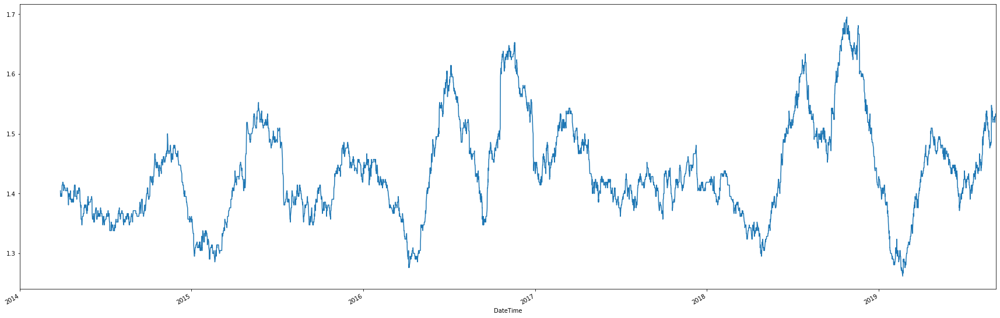

In [39]:
df_datetime[df_datetime['Neighborhood'] == 'Downtown'].groupby('DateTime').sum()['Count']['2014':].rolling(window=7*30, center=False).mean().plot(figsize=(30,10))

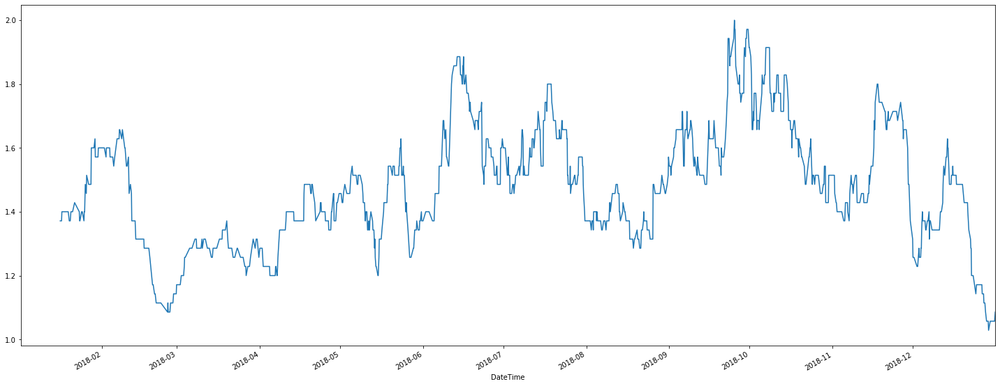

In [40]:
df_datetime[df_datetime['Neighborhood'] == 'Downtown'].groupby('DateTime').sum()['Count']['2018'].rolling(window=35, center=False).mean().plot(figsize=(25,10))

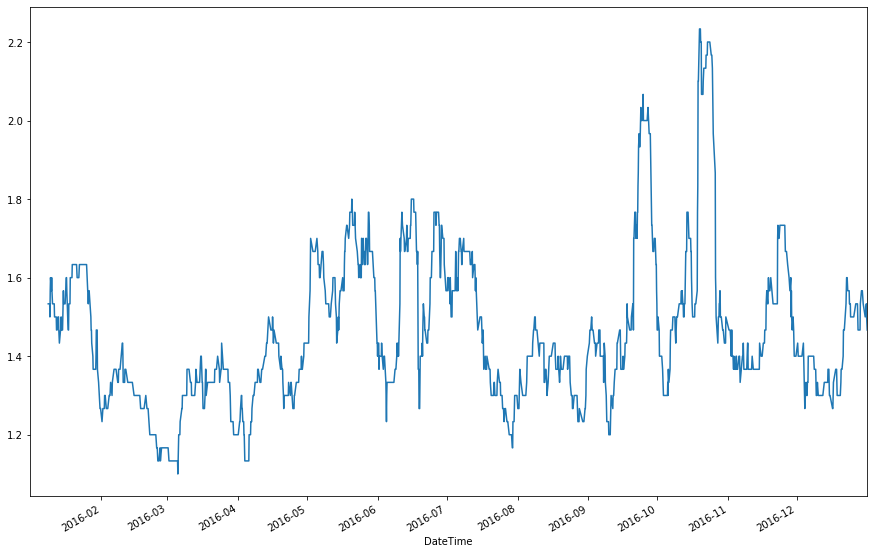

In [41]:
df_datetime[df_datetime['Neighborhood'] == 'Downtown'].groupby('DateTime').sum()['Count']['2016'].rolling(window=30, center=False).mean().plot(figsize=(15,10))

Creating a dataframe with just total by date, not time

In [42]:
neighborhoods_out = {}
total_out = {}
dates = {}

for neighborhood in df.Neighborhood.unique():
    for date in df.CrimeDate.unique():
        total_out[f'{neighborhood}_{date}'] = df[(df['Inside/Outside'] == 'O') & (df['Neighborhood'] == neighborhood) & (df['CrimeDate'] == date)]['Count'].sum()
        neighborhoods_out[f'{neighborhood}_{date}'] = neighborhood
        dates[f'{neighborhood}_{date}'] = date

count_by_date = pd.DataFrame()
count_by_date['Neighborhood'] = neighborhoods_out.values()
count_by_date['Count'] = total_out.values()
count_by_date['Date'] = dates.values()

In [43]:
count_by_date.head()

,Neighborhood,Count,Date
0,Sandtown-Winchester,1,09/07/2019
1,Sandtown-Winchester,0,09/06/2019
2,Sandtown-Winchester,0,09/05/2019
3,Sandtown-Winchester,0,09/04/2019
4,Sandtown-Winchester,0,09/03/2019


In [44]:
count_by_date['Date'] = pd.to_datetime(count_by_date['Date'], format='%m/%d/%Y')

In [45]:
count_by_date.set_index('Date')

,Neighborhood,Count
Date,,
2019-09-07,Sandtown-Winchester,1
2019-09-06,Sandtown-Winchester,0
2019-09-05,Sandtown-Winchester,0
2019-09-04,Sandtown-Winchester,0
2019-09-03,Sandtown-Winchester,0
...,...,...
1980-07-01,Dundalk Marine Terminal,0
1978-01-01,Dundalk Marine Terminal,0
1977-05-01,Dundalk Marine Terminal,0


Make this a dataframe indexed by a datetime column as well as make a column with just the year and month information

In [47]:
count_by_date_indexed = count_by_date.copy()

In [48]:
count_by_date_indexed = count_by_date_indexed.set_index('Date')

In [49]:
count_by_date_indexed['Year'] = count_by_date_indexed.index.year
count_by_date_indexed['Month'] = count_by_date_indexed.index.month

In [50]:
count_by_date_indexed['Year-Month'] = pd.to_datetime([f'{y}-{m}-01' for y, m in zip(count_by_date_indexed.Year, count_by_date_indexed.Month)])

In [51]:
count_by_date_indexed.drop(['Year', 'Month'], axis=1, inplace=True)

In [52]:
count_by_date_indexed = count_by_date_indexed['2014':]

In [53]:
count_by_date_indexed.head()

,Neighborhood,Count,Year-Month
Date,,,
2019-09-07,Sandtown-Winchester,1,2019-09-01
2019-09-06,Sandtown-Winchester,0,2019-09-01
2019-09-05,Sandtown-Winchester,0,2019-09-01
2019-09-04,Sandtown-Winchester,0,2019-09-01
2019-09-03,Sandtown-Winchester,0,2019-09-01


In [54]:
count_by_date_indexed

,Neighborhood,Count,Year-Month
Date,,,
2019-09-07,Sandtown-Winchester,1,2019-09-01
2019-09-06,Sandtown-Winchester,0,2019-09-01
2019-09-05,Sandtown-Winchester,0,2019-09-01
2019-09-04,Sandtown-Winchester,0,2019-09-01
2019-09-03,Sandtown-Winchester,0,2019-09-01
...,...,...,...
2014-01-05,Dundalk Marine Terminal,0,2014-01-01
2014-01-04,Dundalk Marine Terminal,0,2014-01-01
2014-01-03,Dundalk Marine Terminal,0,2014-01-01


In [55]:
count_by_date_indexed.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 577128 entries, 2019-09-07 to 2014-01-01
Data columns (total 3 columns):
Neighborhood    577128 non-null object
Count           577128 non-null int64
Year-Month      577128 non-null datetime64[ns]
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 17.6+ MB


In [453]:
downtowntest = count_by_date_indexed[count_by_date_indexed['Neighborhood'] == 'Downtown'].groupby('Year-Month').sum()

In [57]:
downtowntest.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 69 entries, 2014-01-01 to 2019-09-01
Data columns (total 1 columns):
Count    69 non-null int64
dtypes: int64(1)
memory usage: 1.1 KB


In [58]:
downtowntest.head()

,Count
Year-Month,
2014-01-01,48
2014-02-01,39
2014-03-01,53
2014-04-01,66
2014-05-01,70


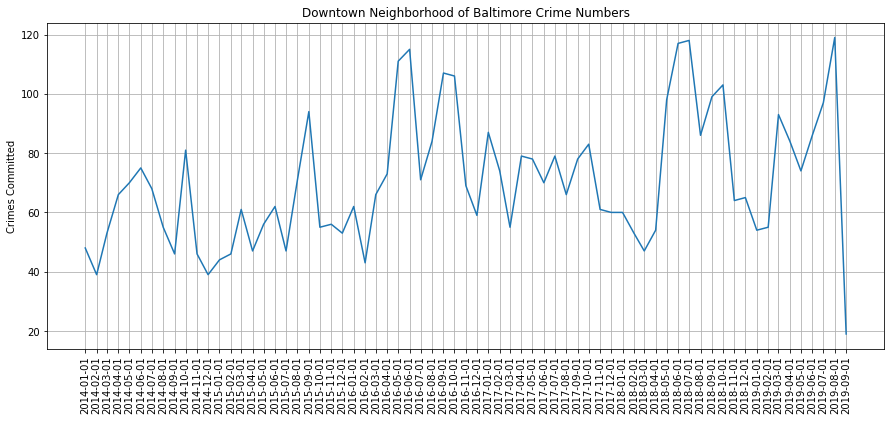

In [454]:
plt.figure(figsize=(15,6))
plt.plot(downtowntest)
plt.xticks(downtowntest.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

Checking for trends in this neighborhood

In [455]:
deomposition = seasonal_decompose(downtowntest)

In [456]:
decomplist = [deomposition.observed, deomposition.seasonal, deomposition.trend, deomposition.resid]
decomplabels = ['observed', 'seasonal', 'trend', 'resid']

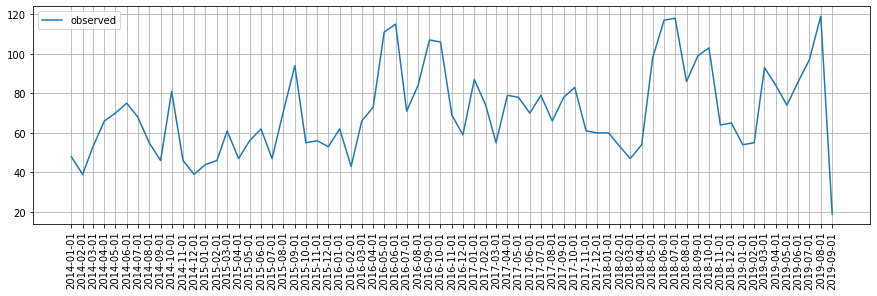

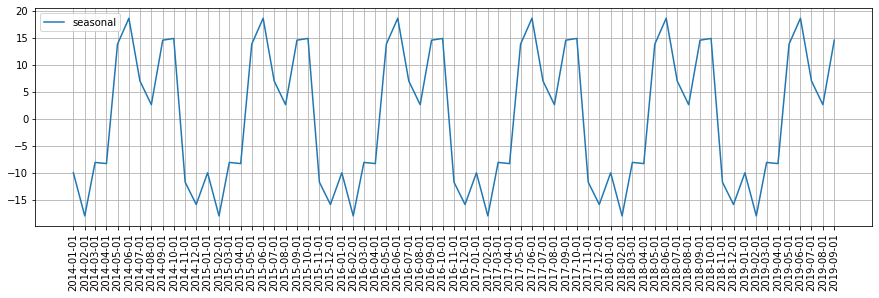

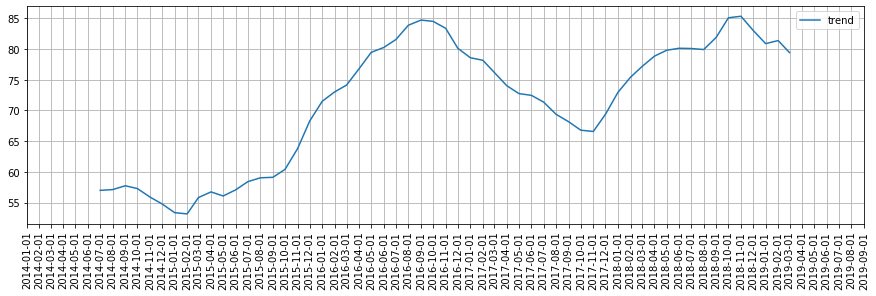

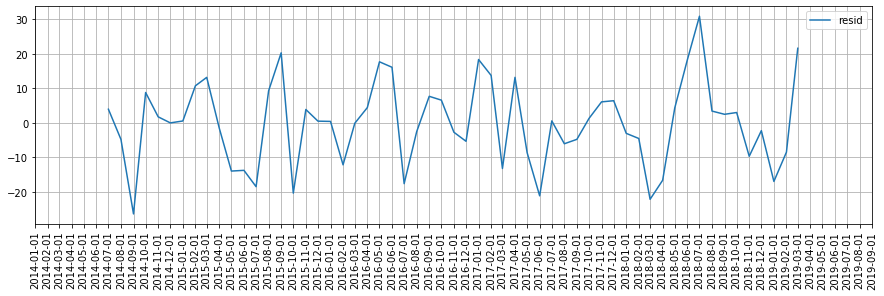

In [460]:
for item, name in zip(decomplist, decomplabels):
    plt.figure(figsize=(15,4))
    plt.plot(item, label=name)
    plt.xticks(downtowntest.index, rotation=90)
    plt.grid()
    plt.legend()
    plt.show()

[Return to contents](#Table-of-Contents)

### Trying to find trends for the entire city overall

In [461]:
alltest = count_by_date_indexed.groupby('Year-Month').sum()

In [462]:
deomposition = seasonal_decompose(alltest)

In [463]:
decomplist = [deomposition.observed, deomposition.seasonal, deomposition.trend, deomposition.resid]
decomplabels = ['observed', 'seasonal', 'trend', 'resid']

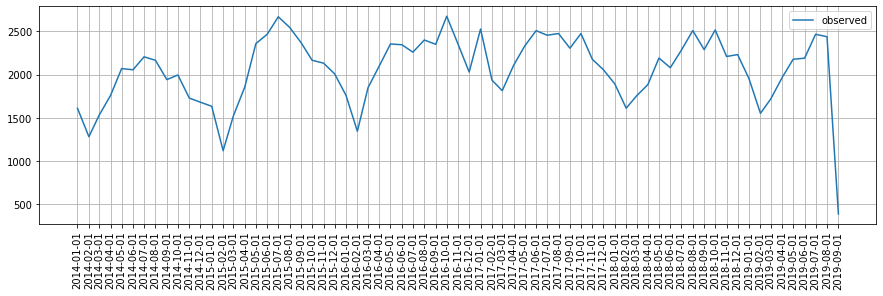

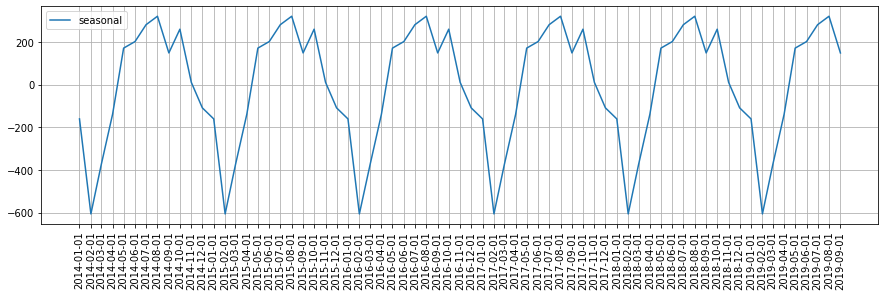

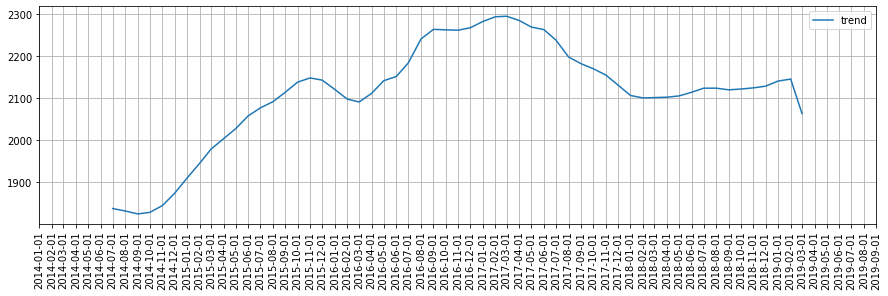

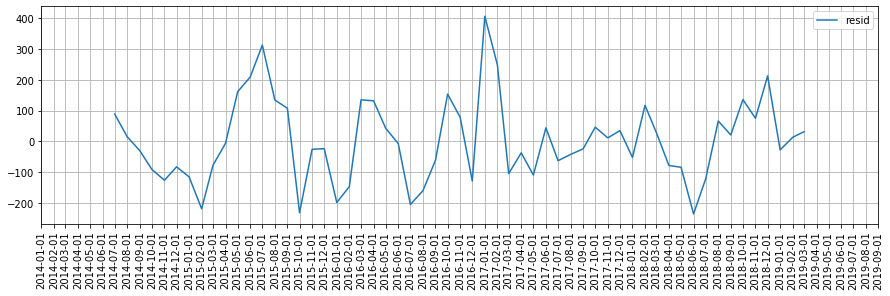

In [464]:
for item, name in zip(decomplist, decomplabels):
    plt.figure(figsize=(15,4))
    plt.plot(item, label=name)
    plt.xticks(alltest.index, rotation=90)
    plt.grid()
    plt.legend()
    plt.show()

[Return to contents](#Table-of-Contents)

### Checking trends for each neighborhood separately 

Sandtown-Winchester


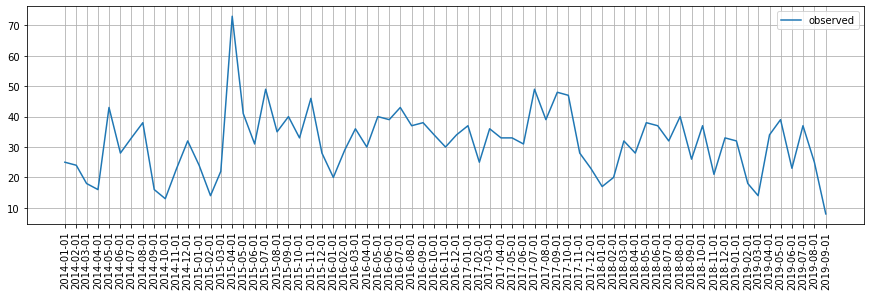

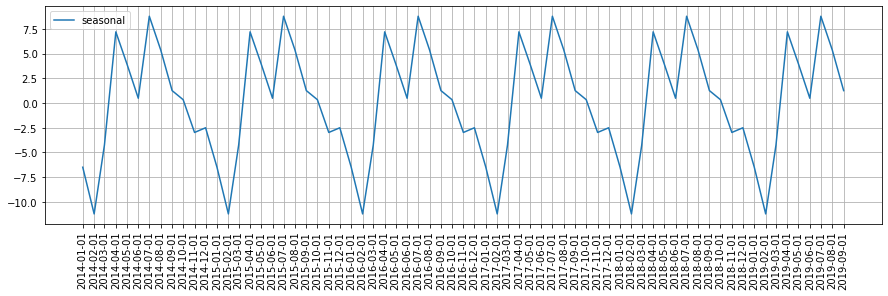

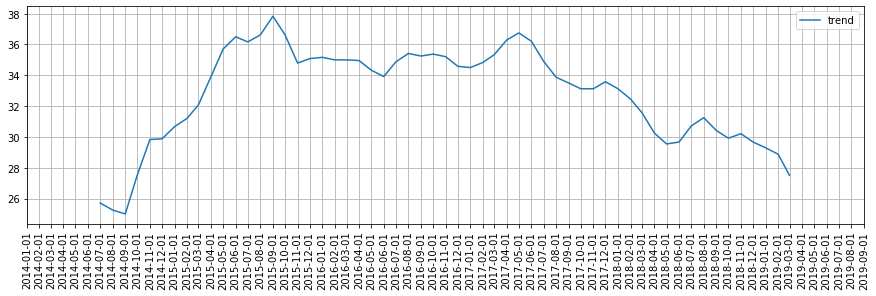

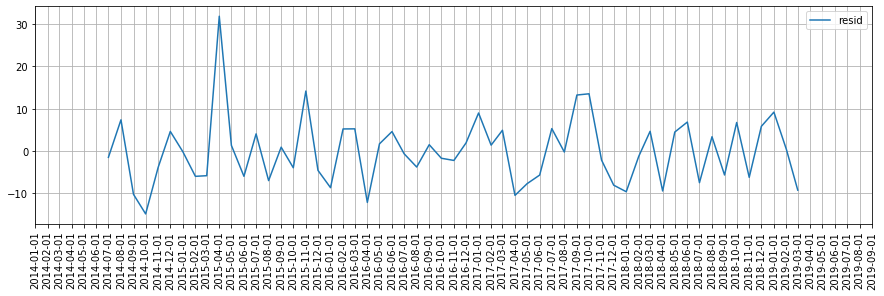



Downtown


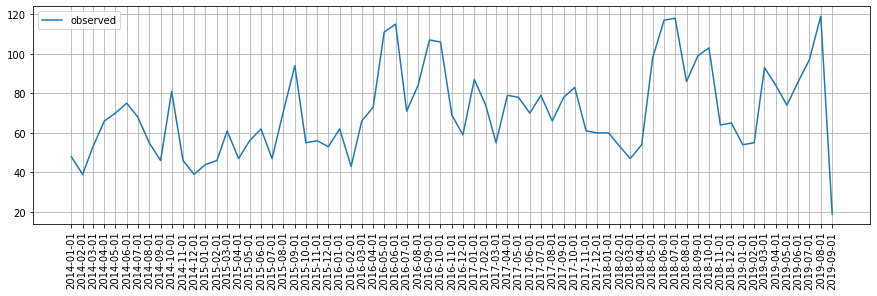

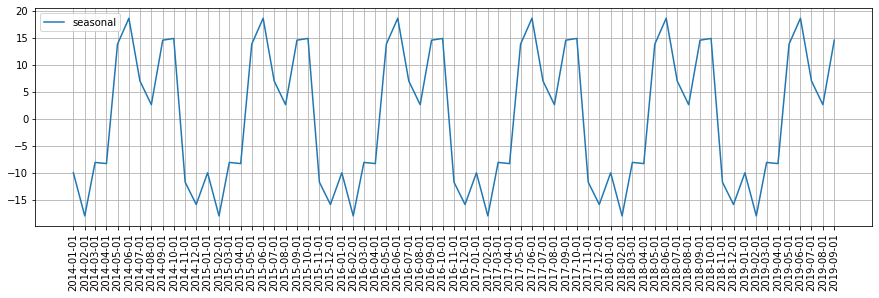

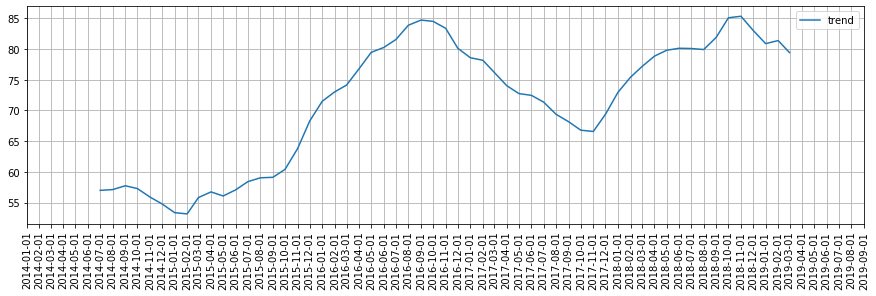

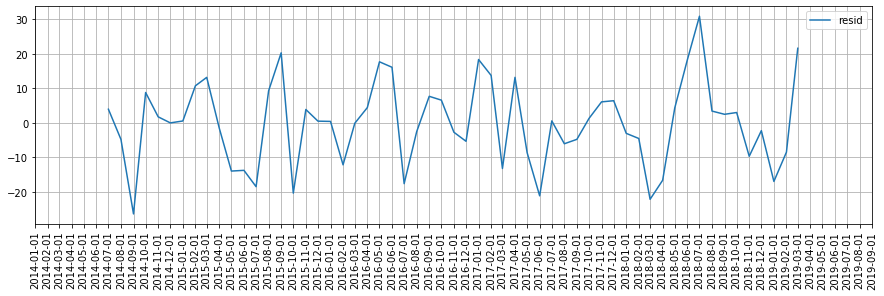



Ellwood Park/Monument


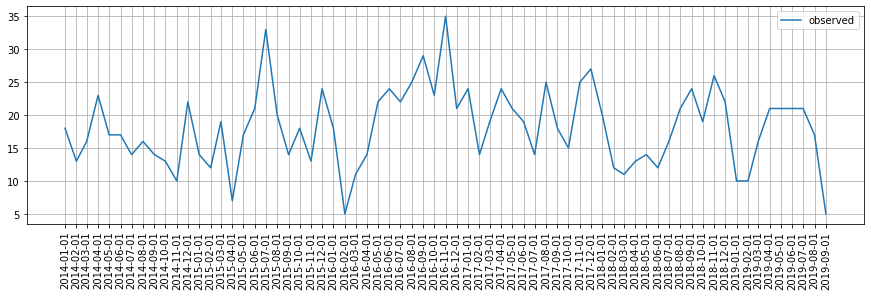

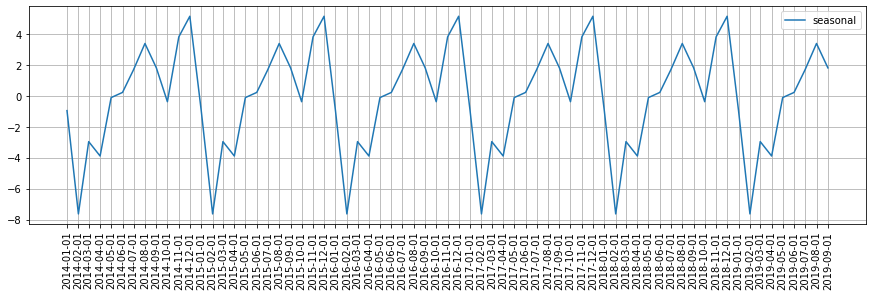

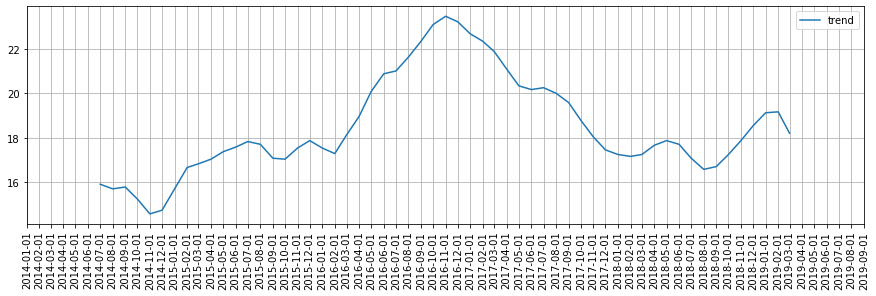

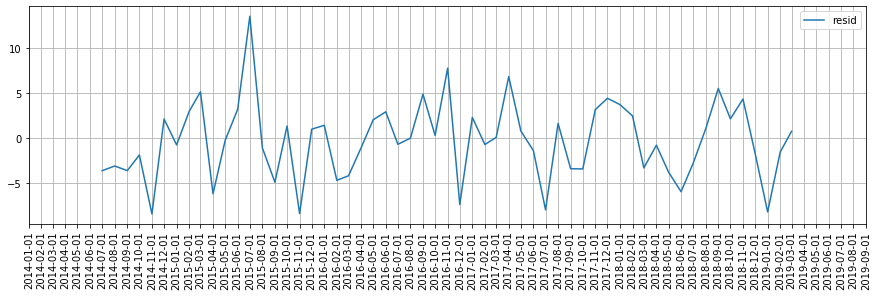



Middle East


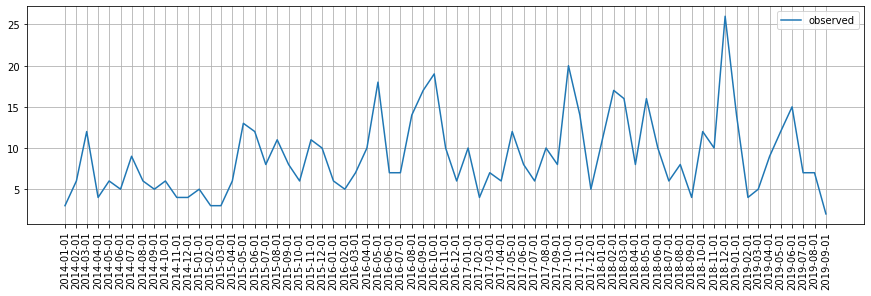

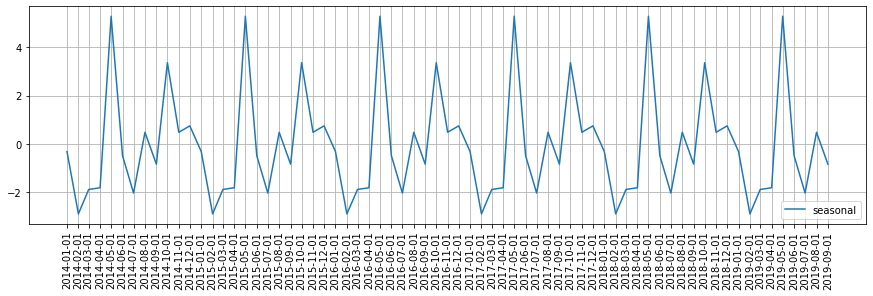

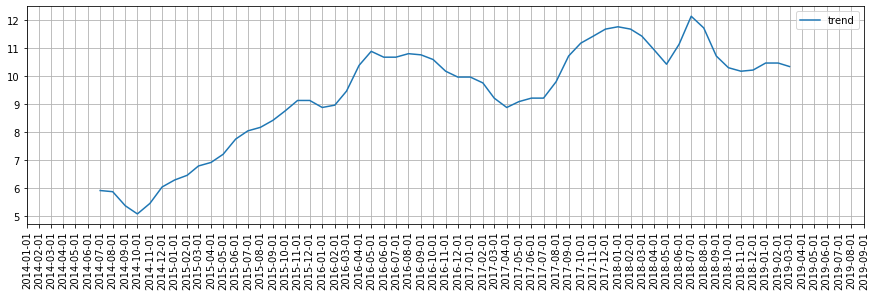

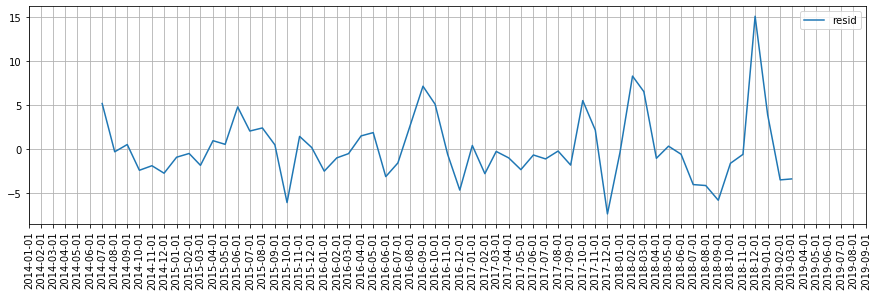



Allendale


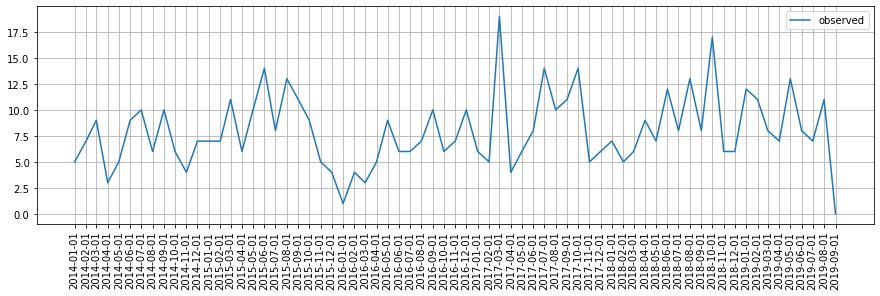

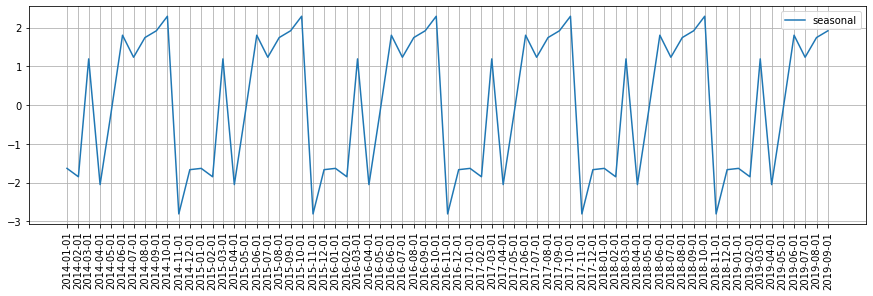

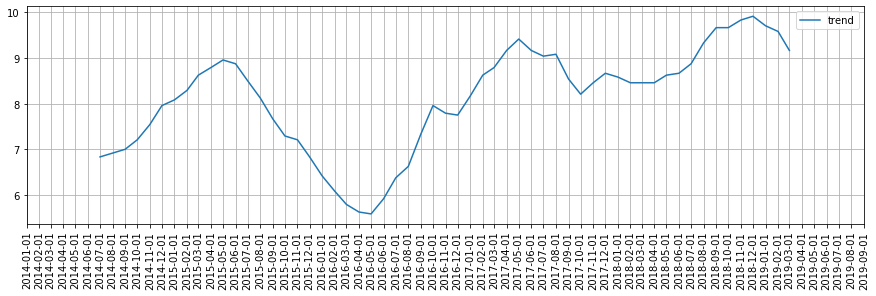

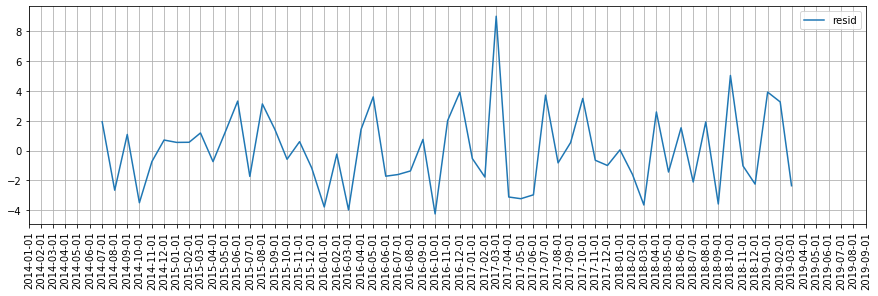



Pimlico Good Neighbors


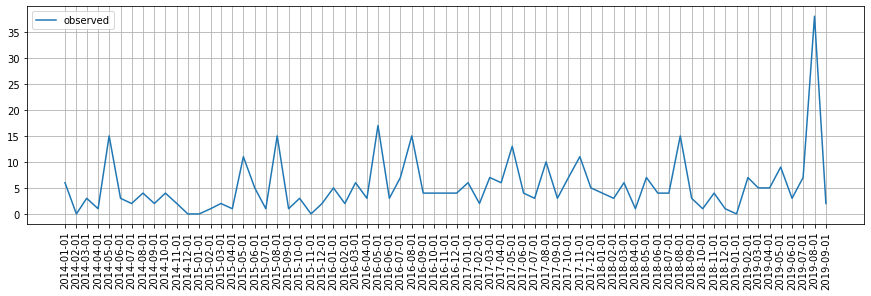

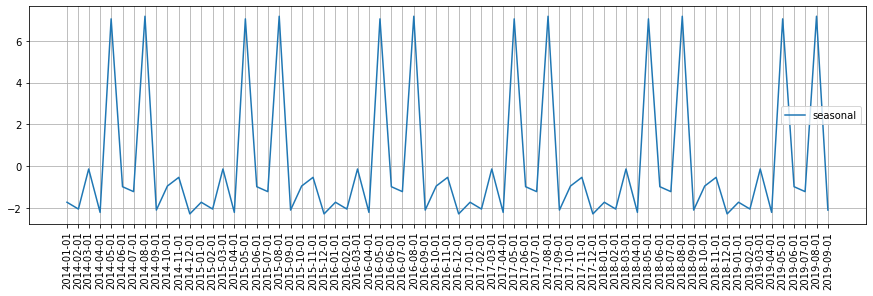

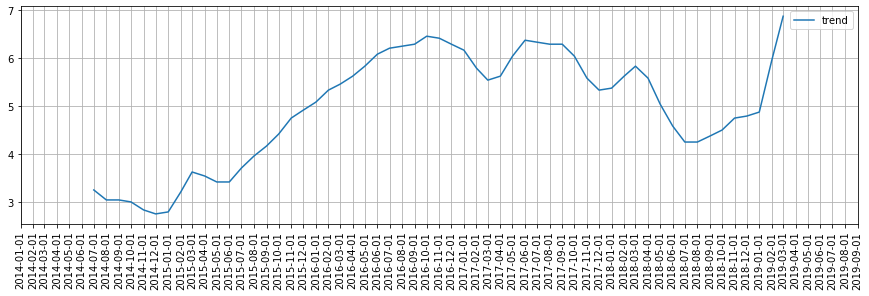

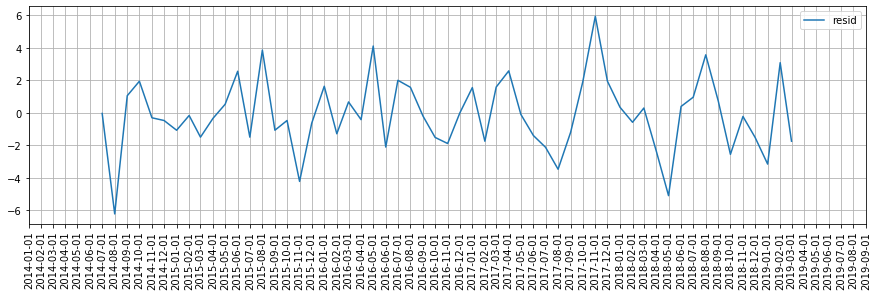



Reisterstown Station


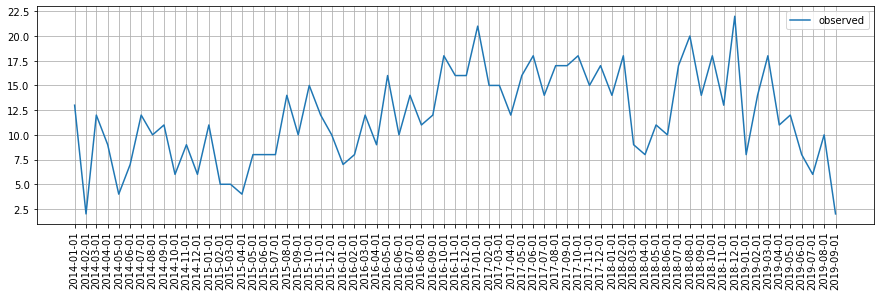

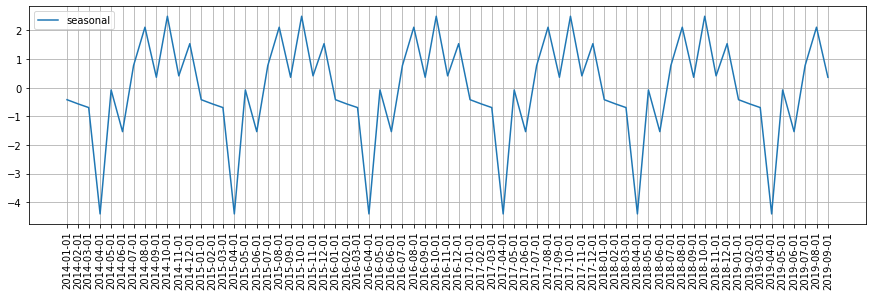

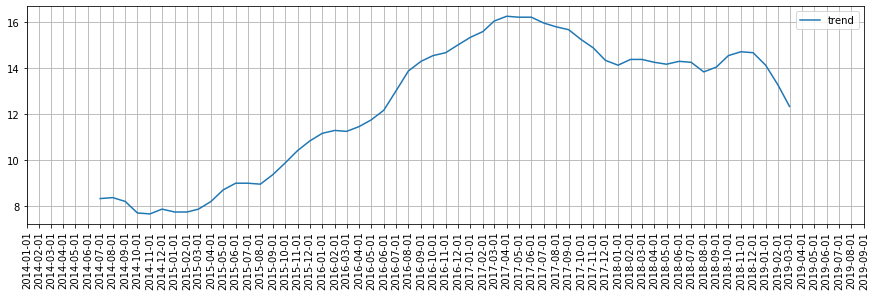

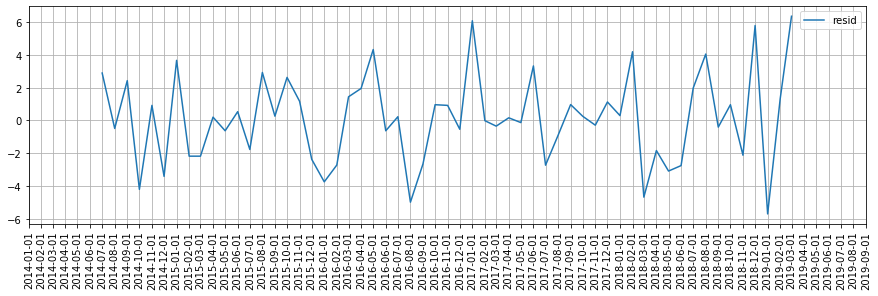



Canton


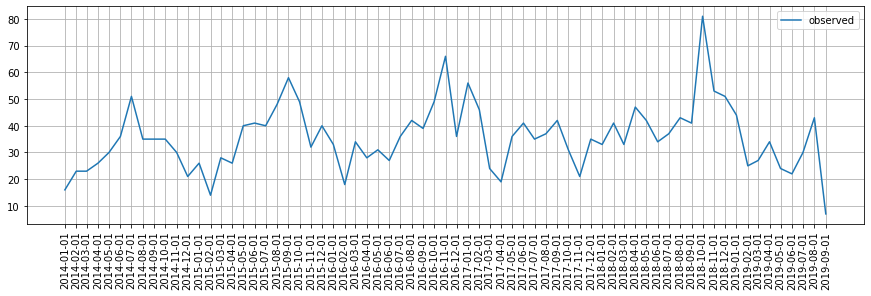

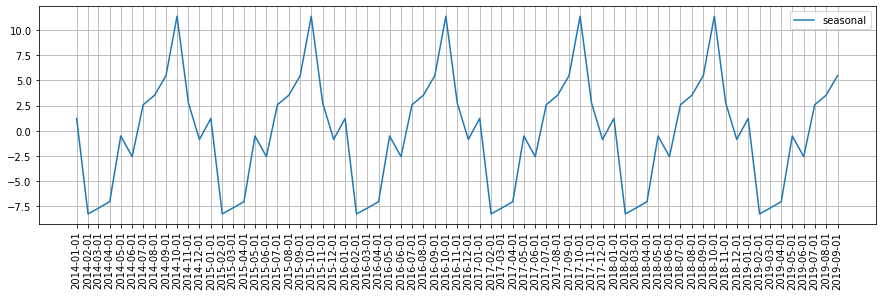

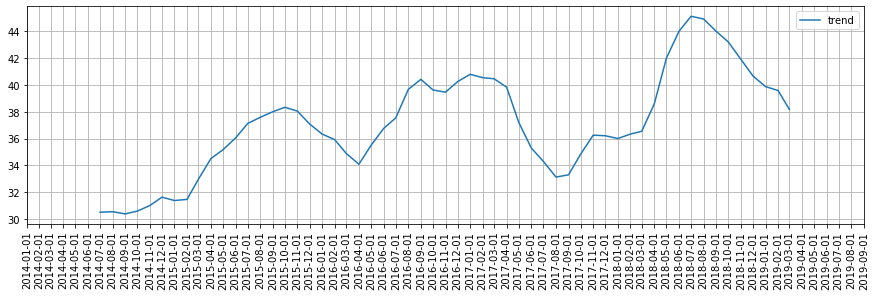

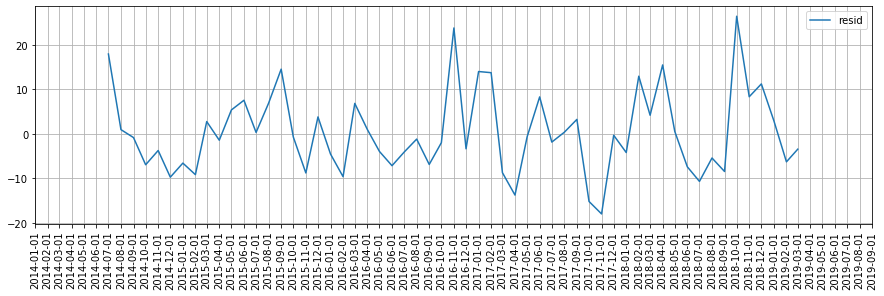



Little Italy


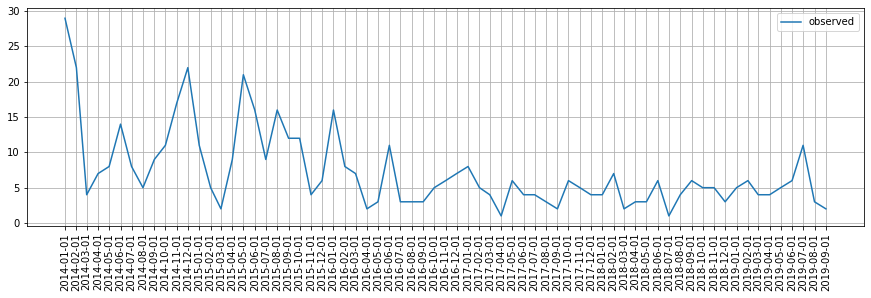

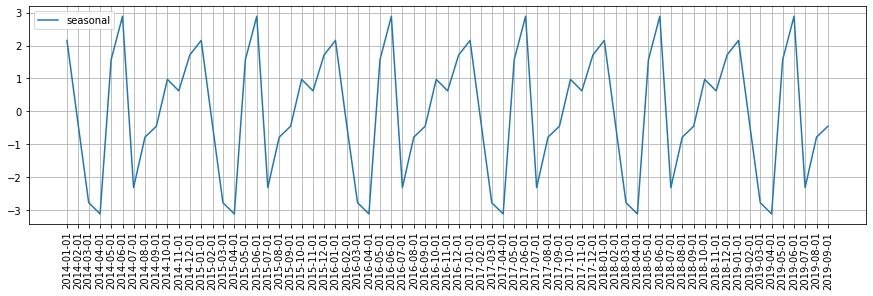

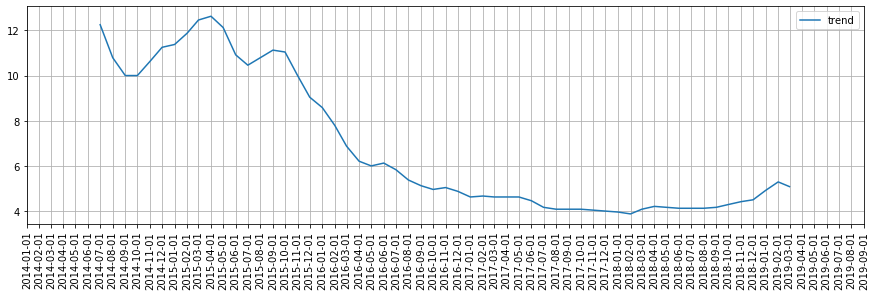

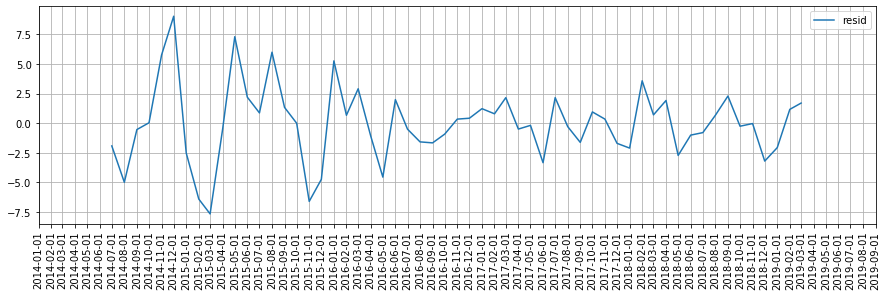



Fells Point


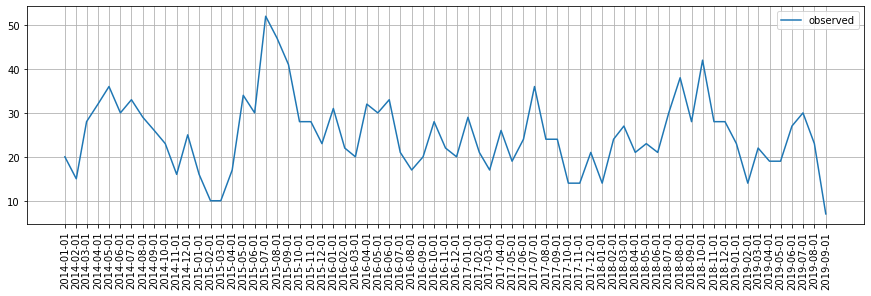

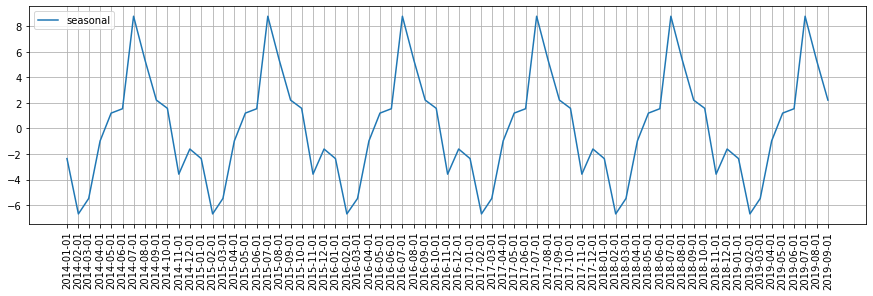

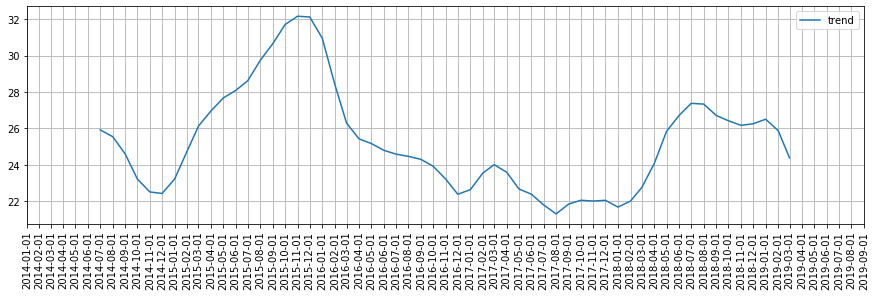

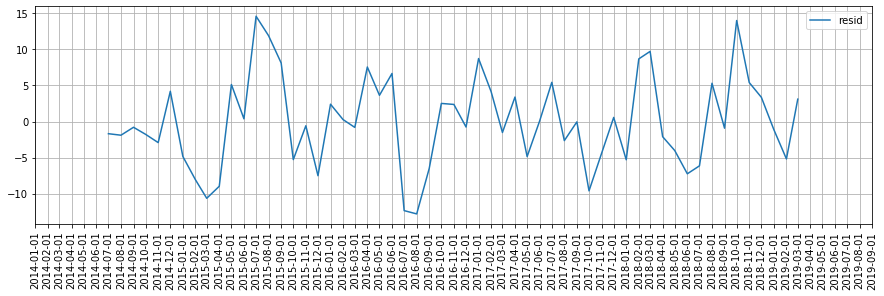



Darley Park


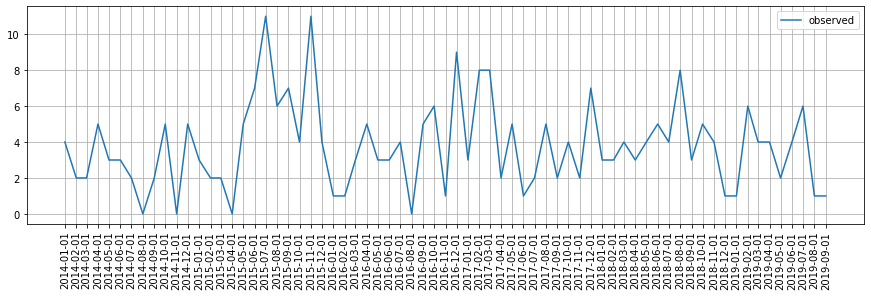

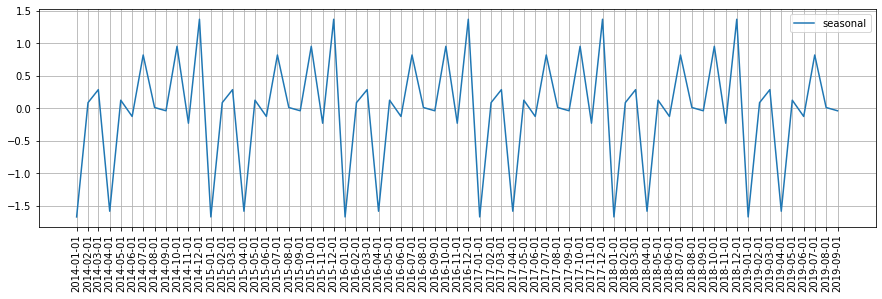

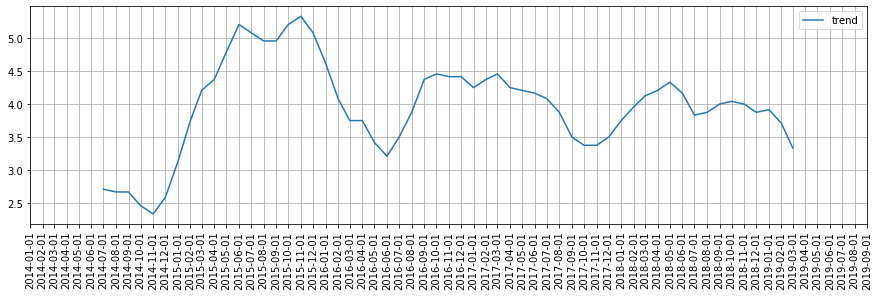

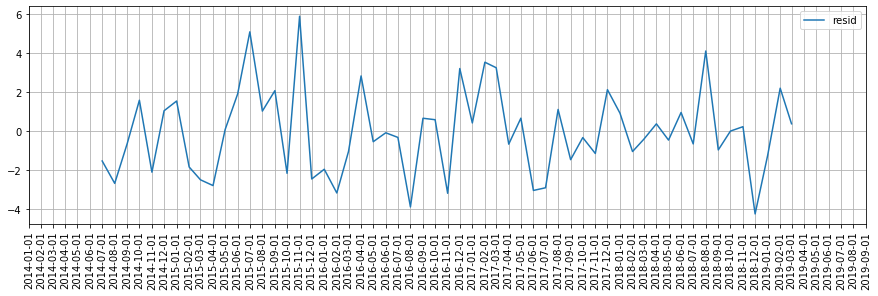



Yale Heights


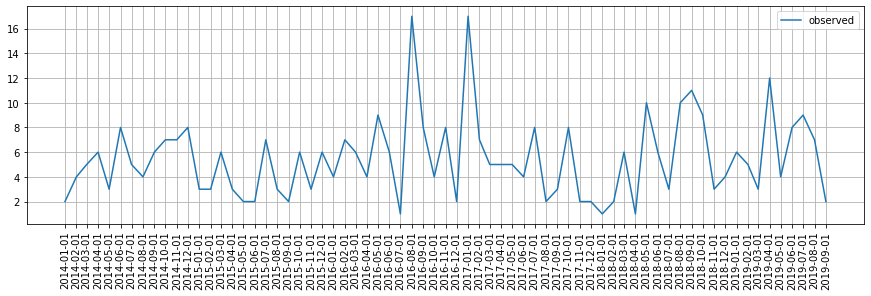

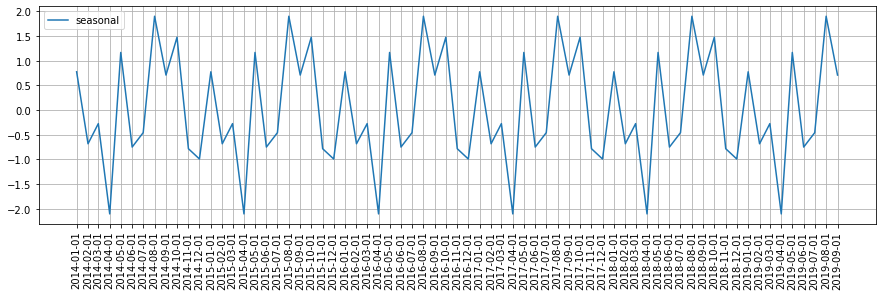

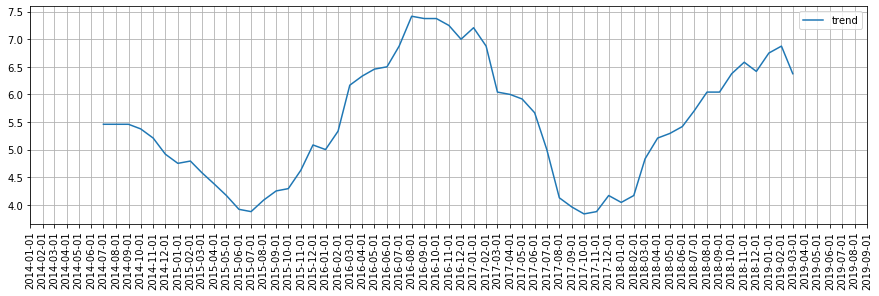

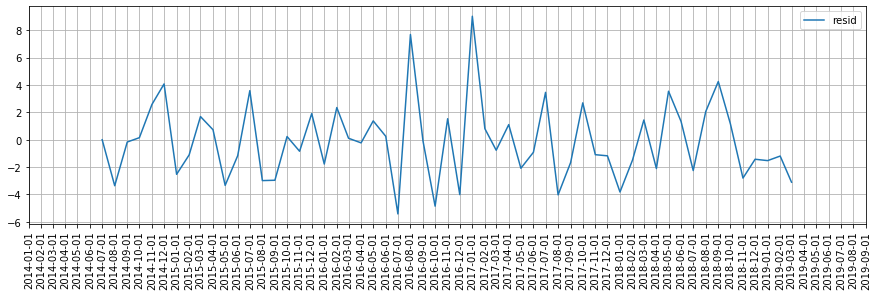



Cherry Hill


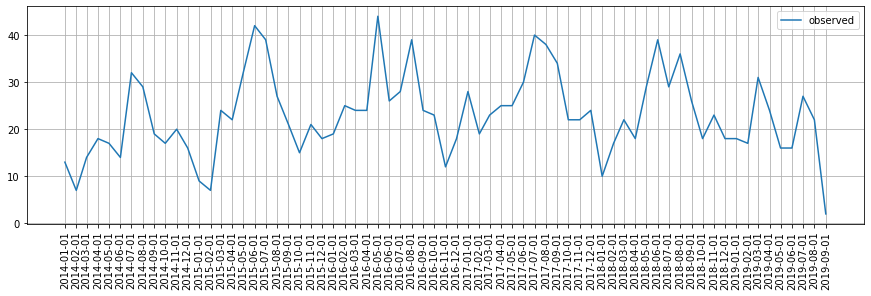

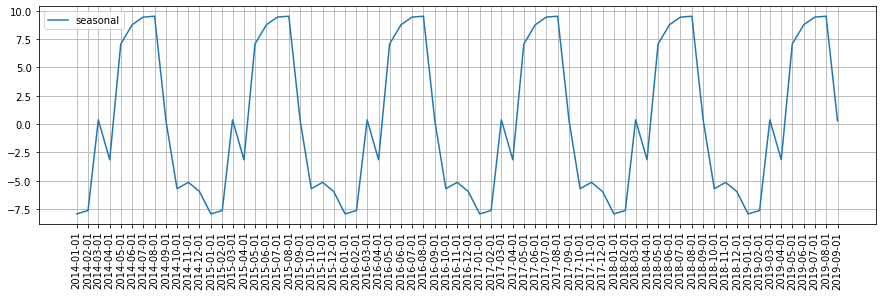

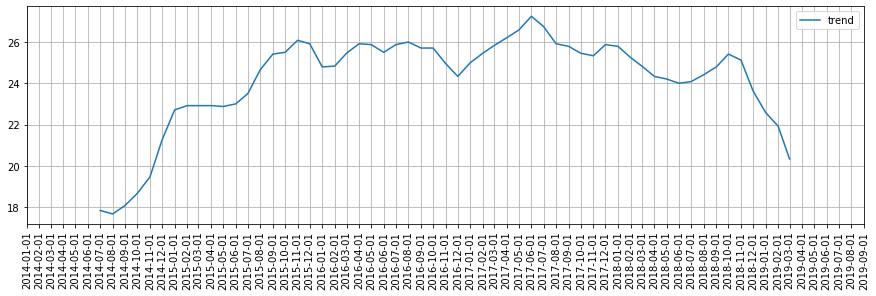

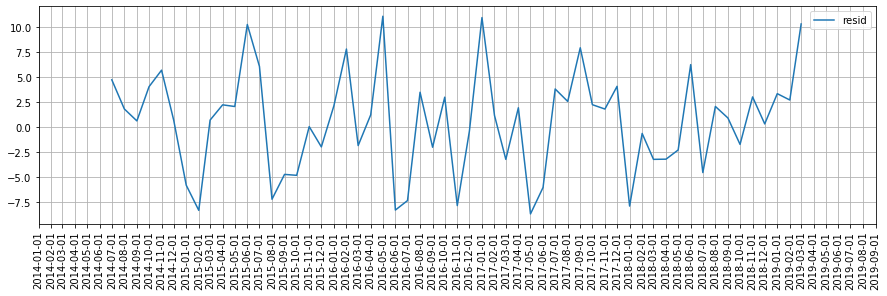



Lakeland


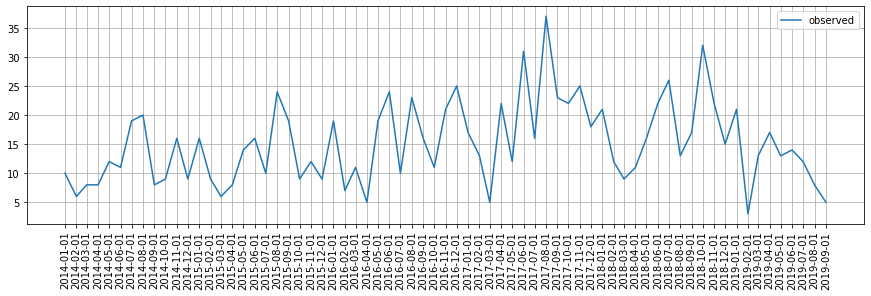

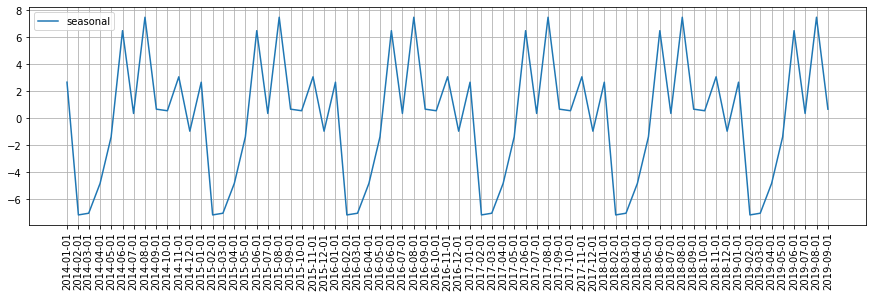

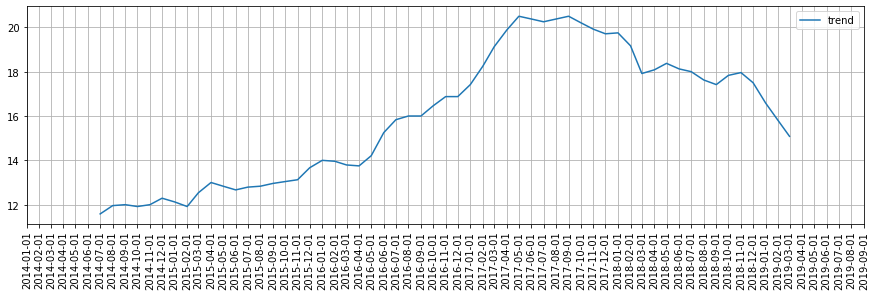

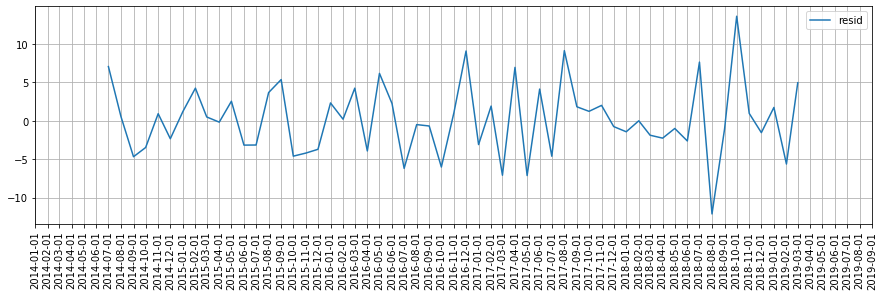



Lauraville


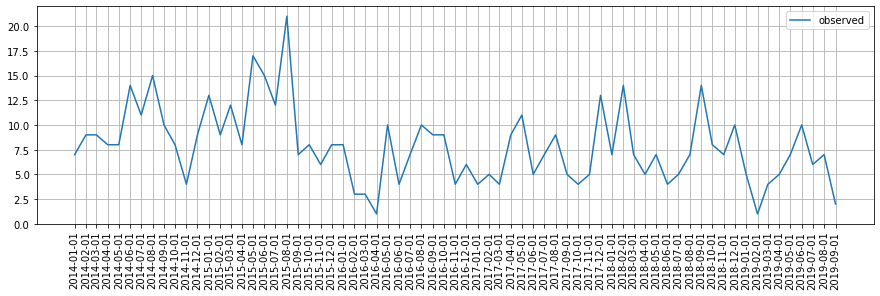

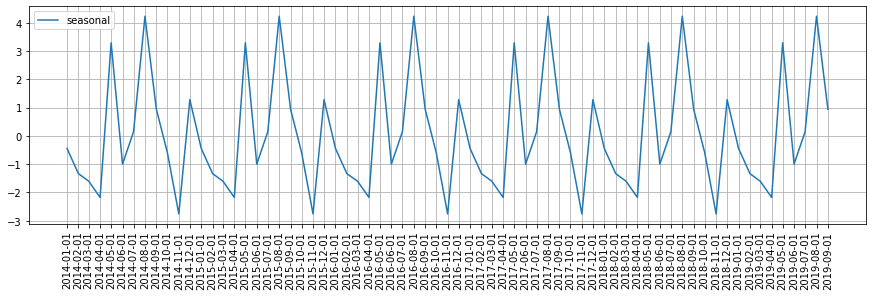

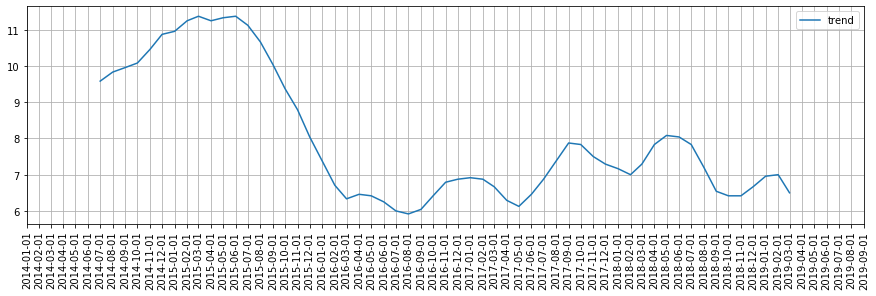

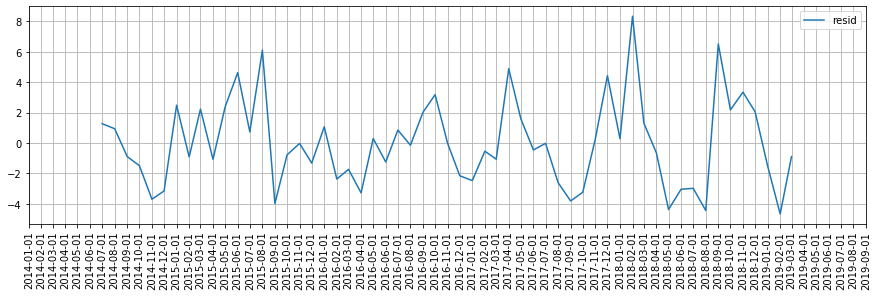



Lake Walker


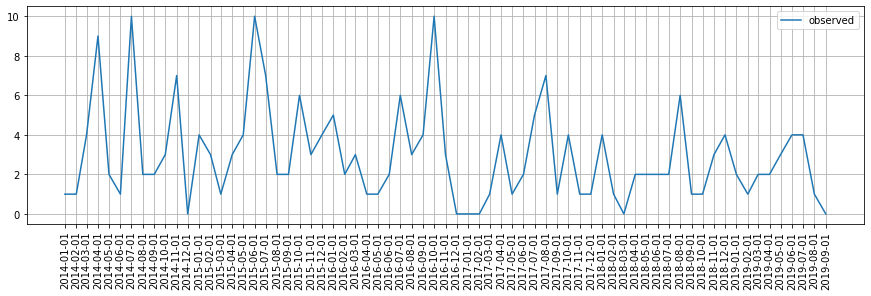

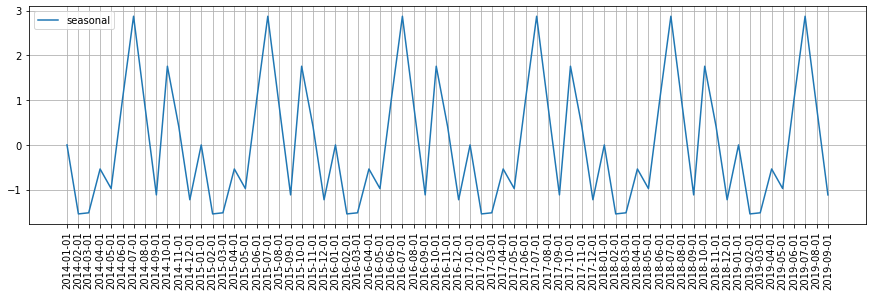

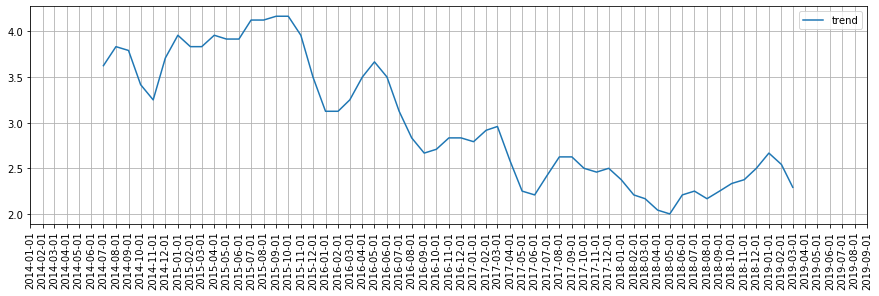

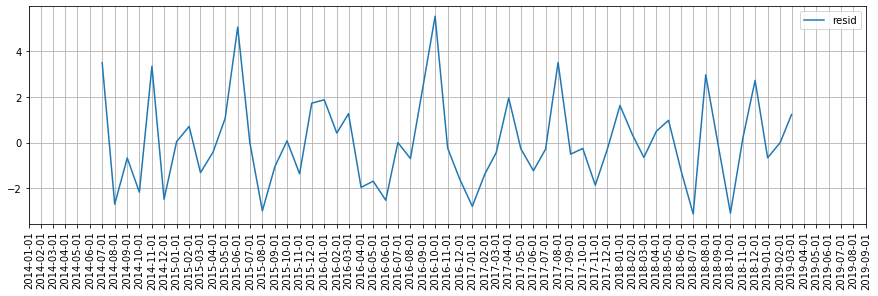



York-Homeland


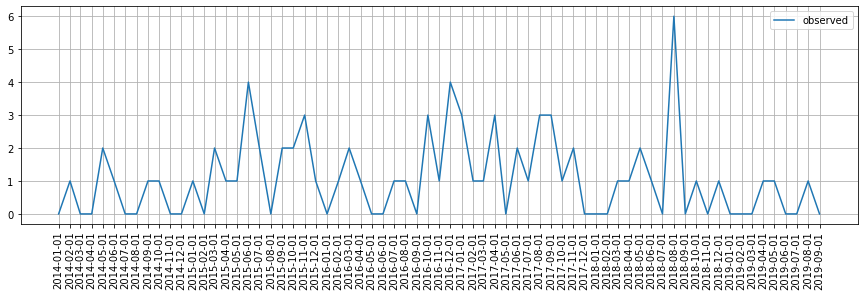

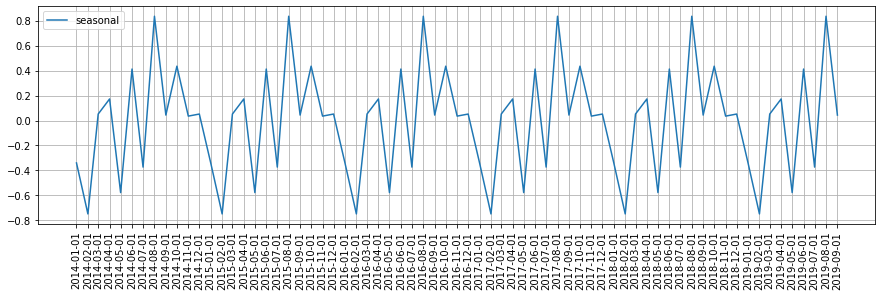

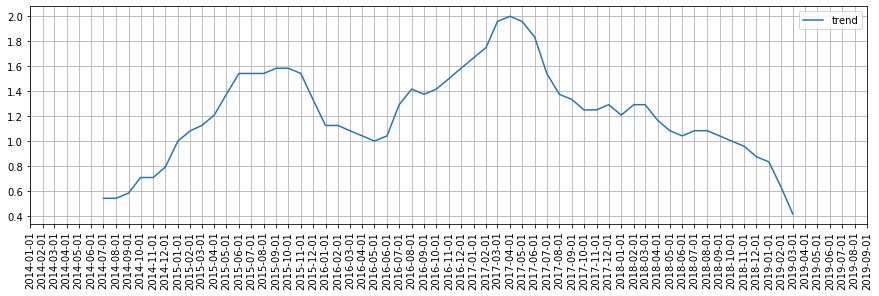

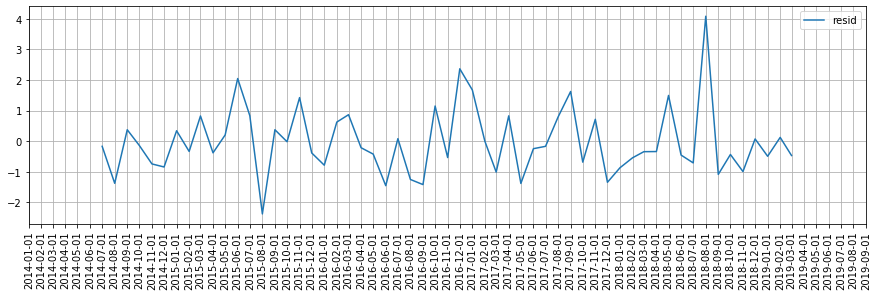



Broadway East


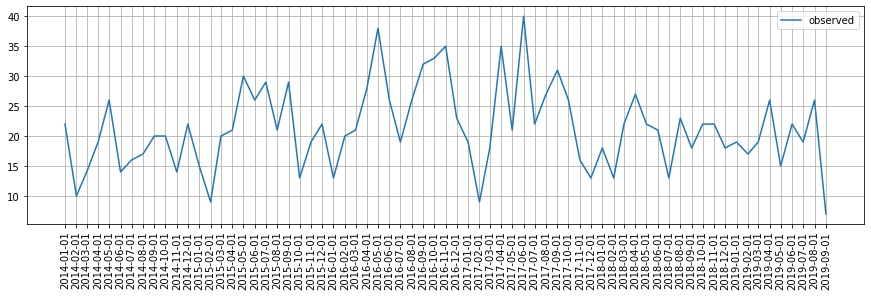

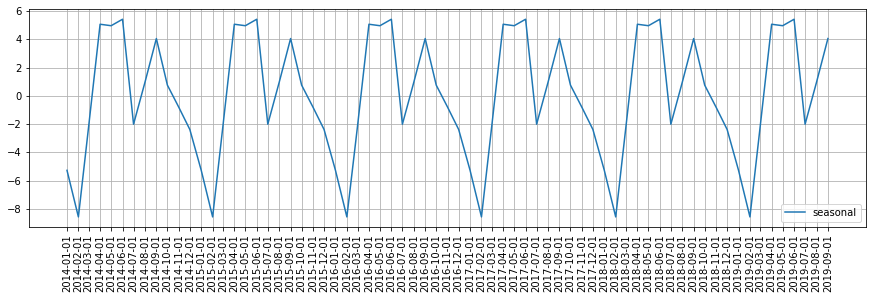

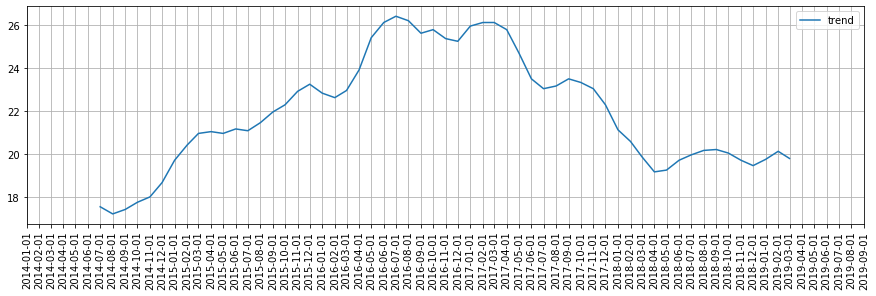

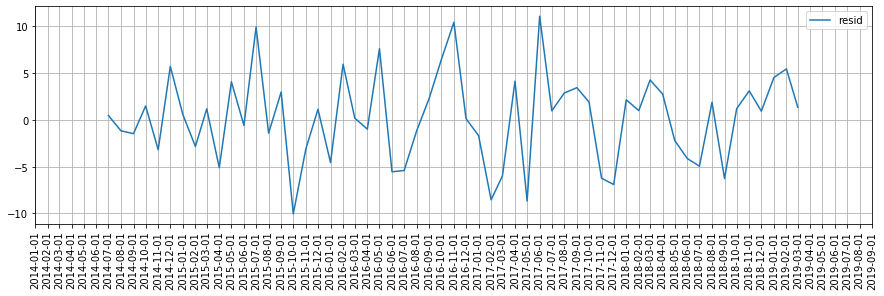



Purnell


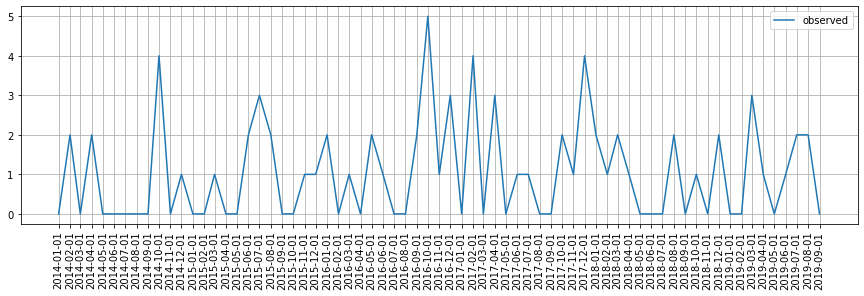

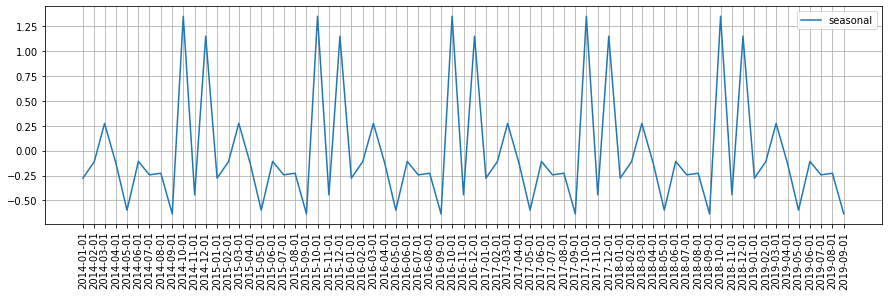

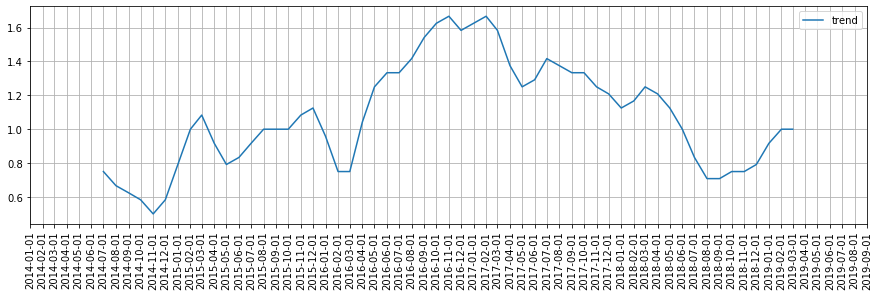

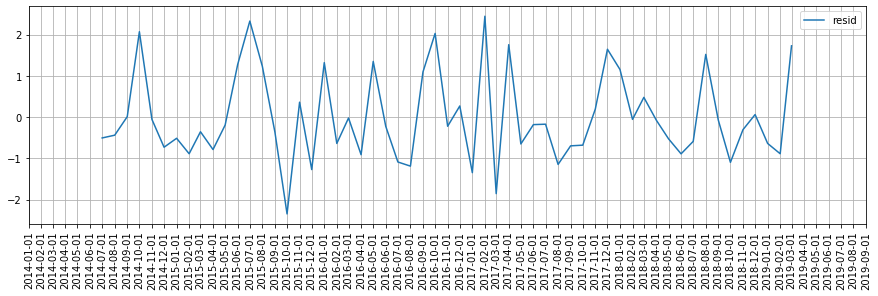



West Arlington


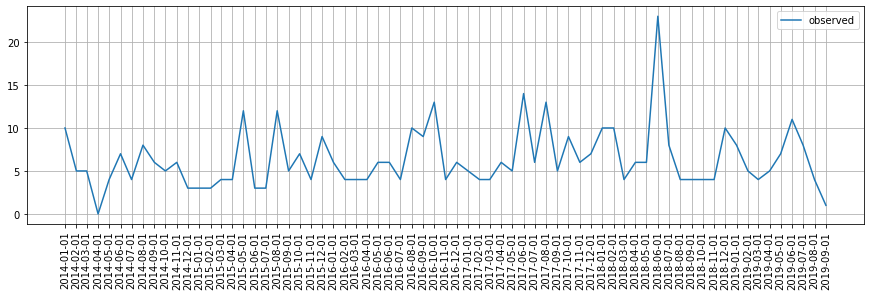

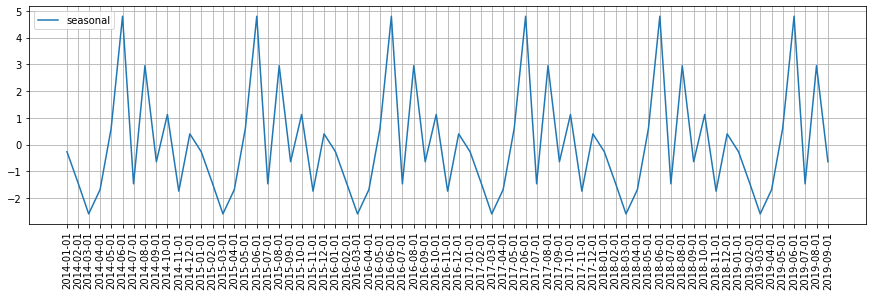

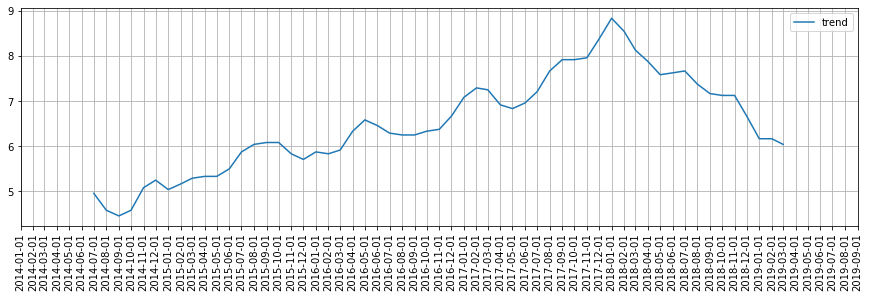

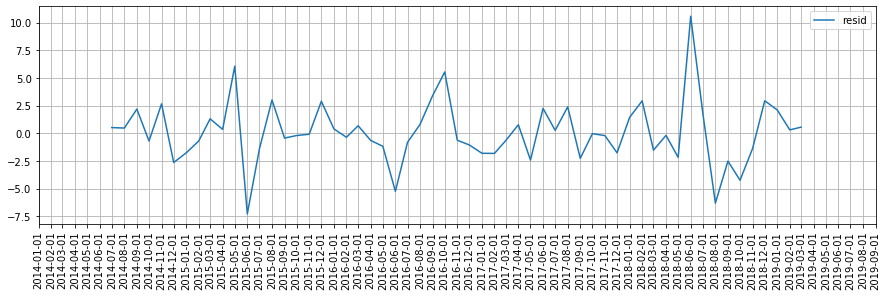



Abell


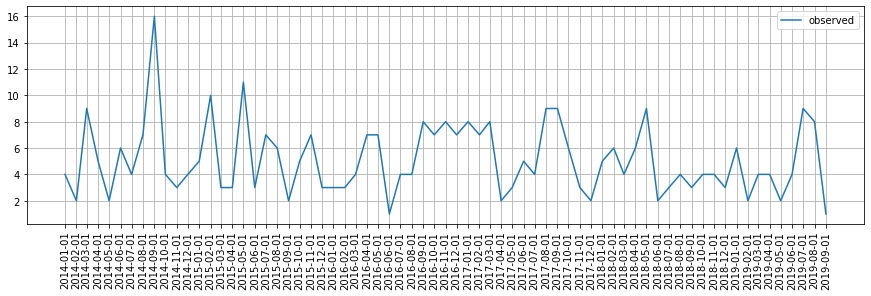

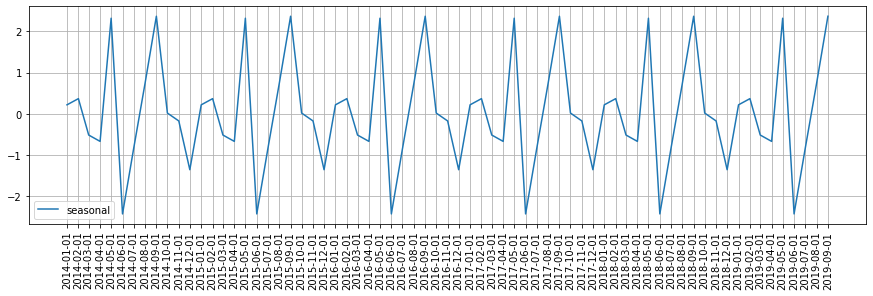

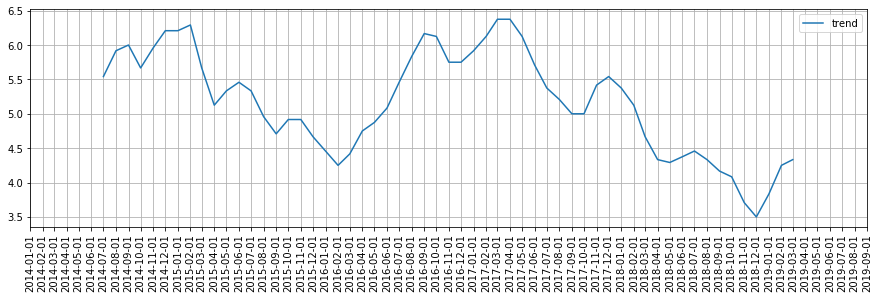

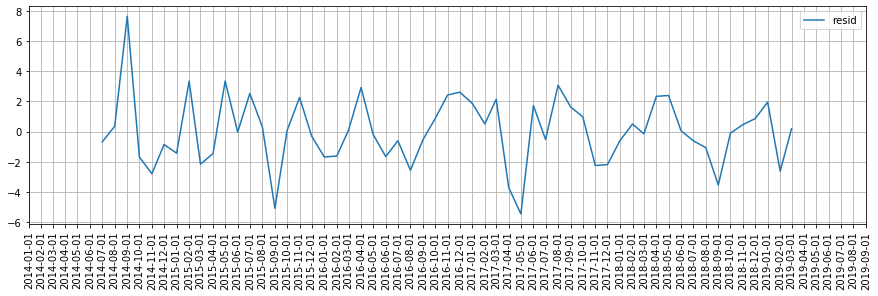



Upton


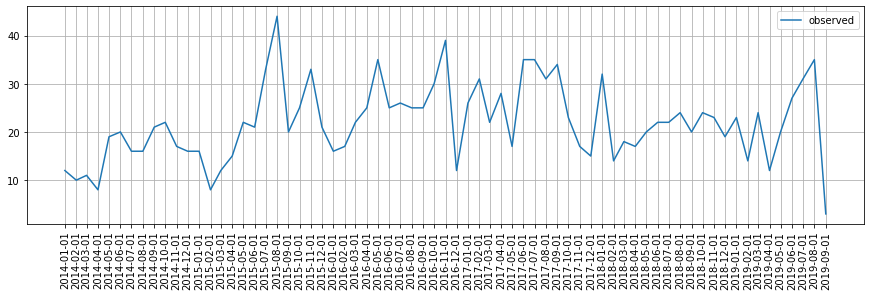

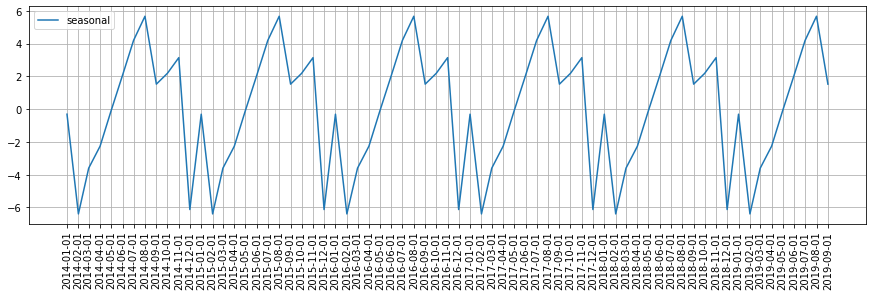

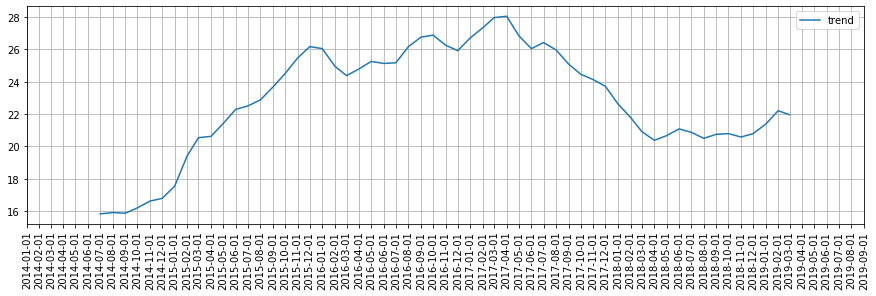

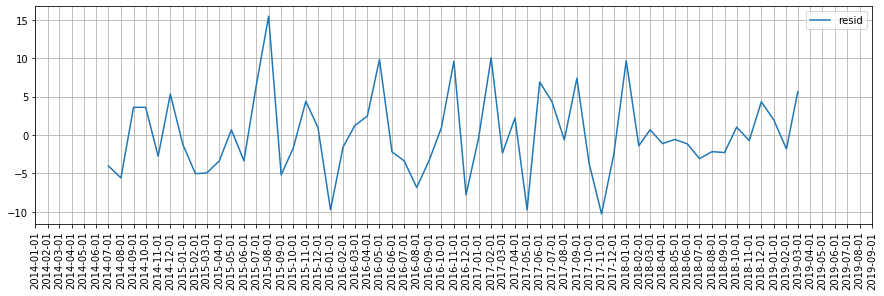



Edmondson Village


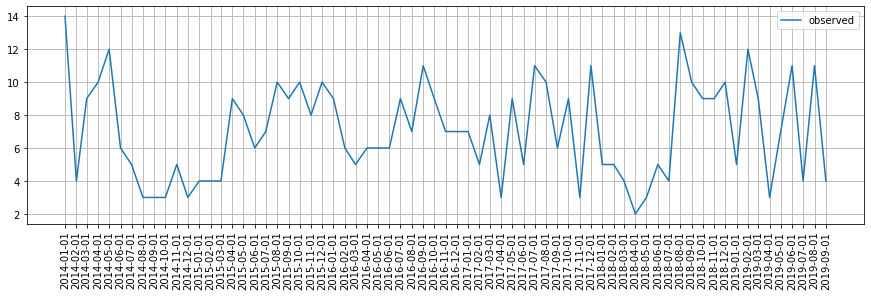

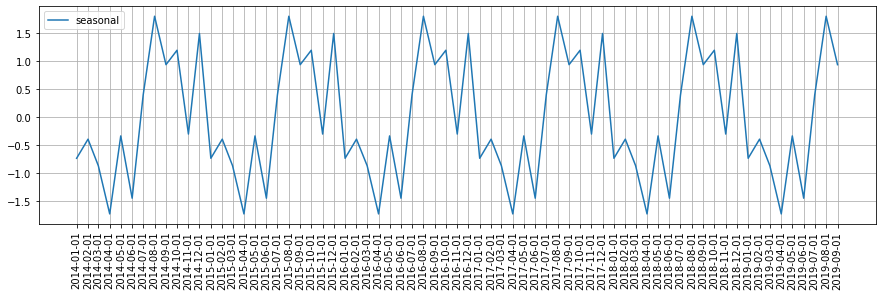

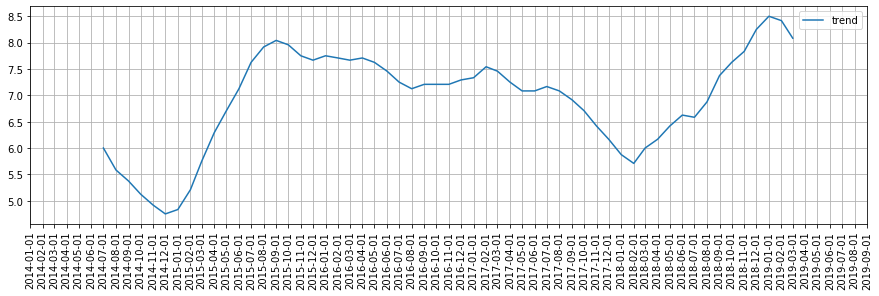

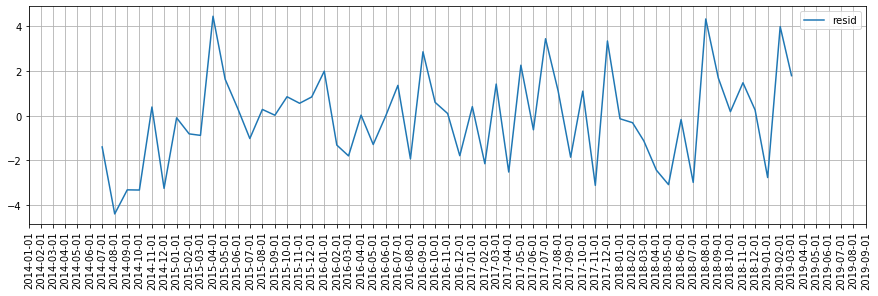



Medfield


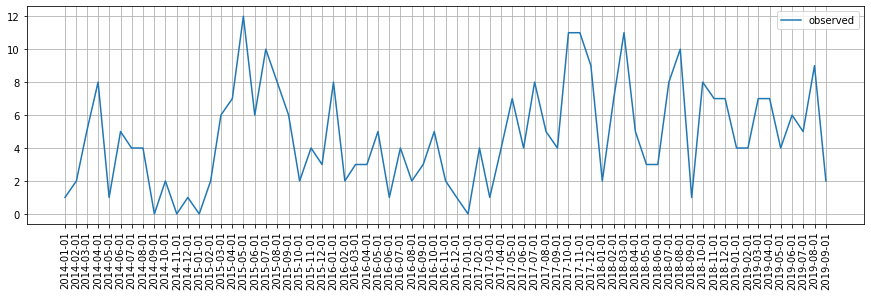

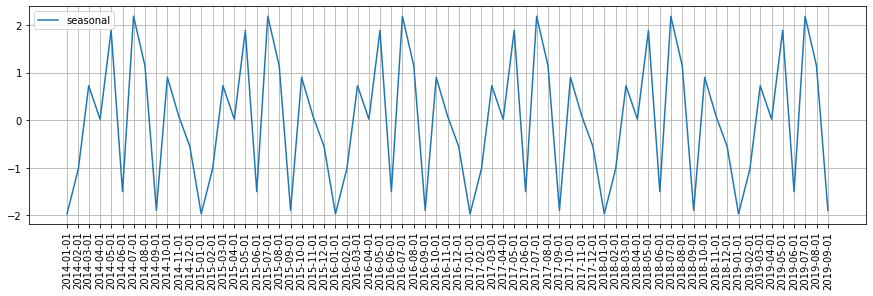

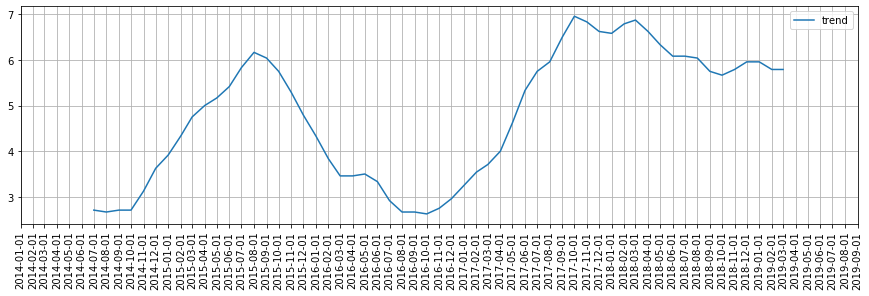

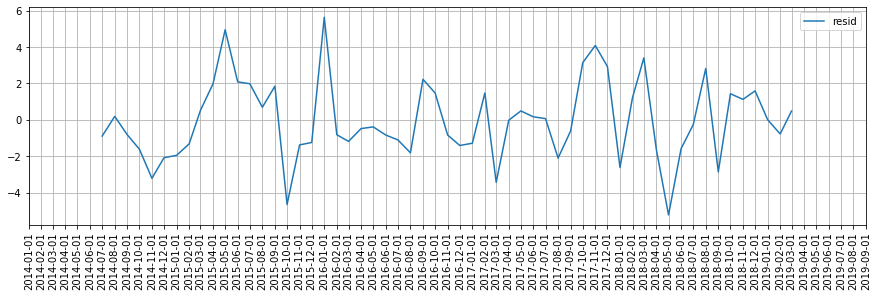



Levindale


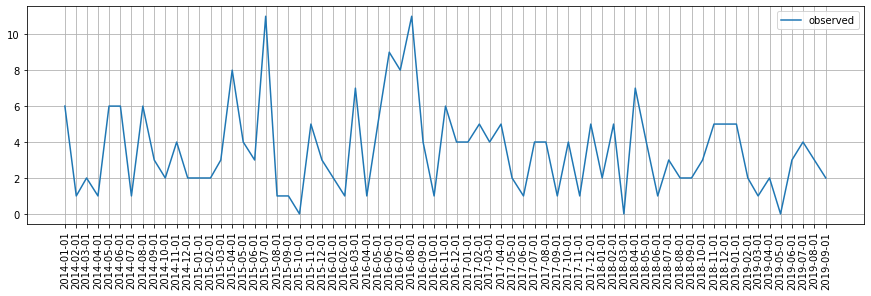

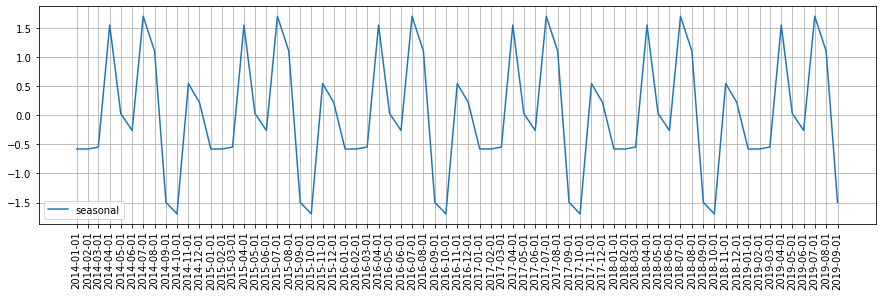

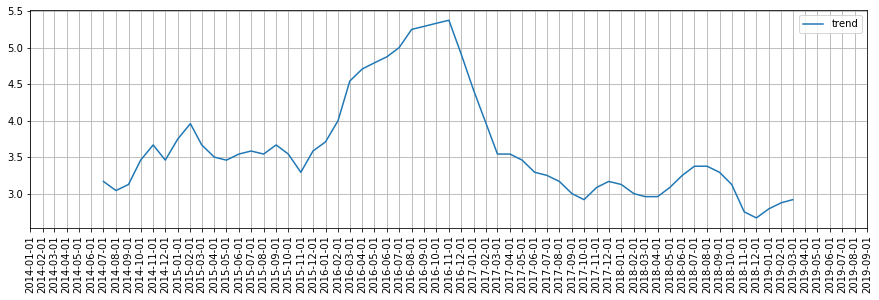

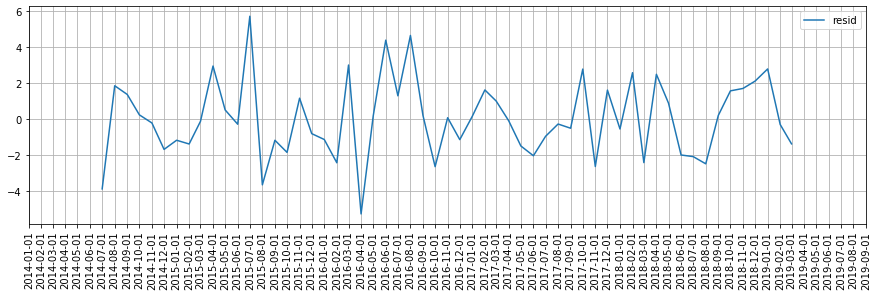



Curtis Bay


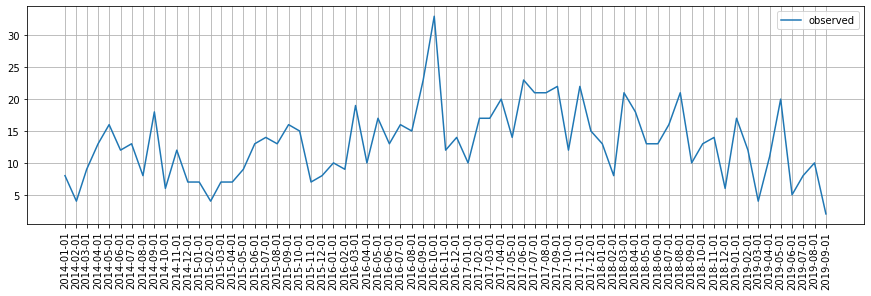

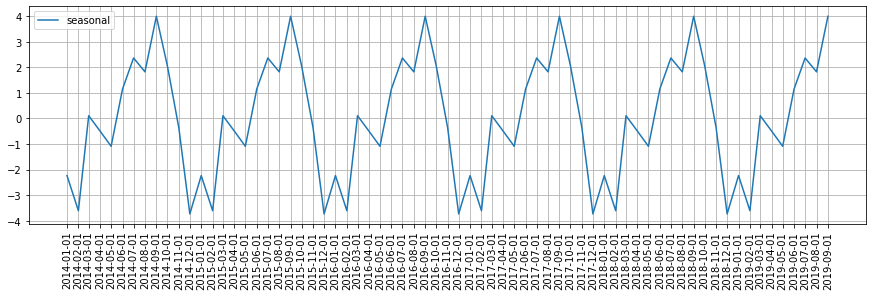

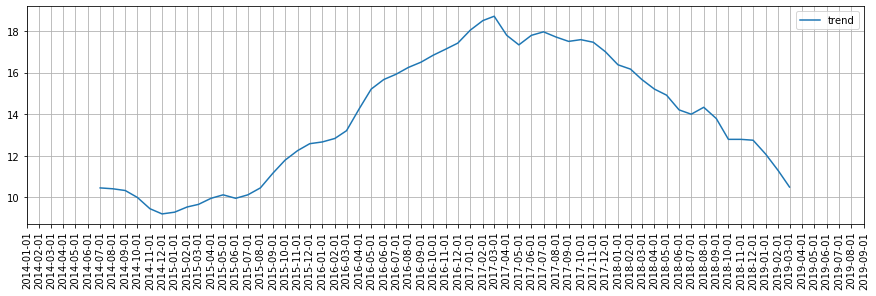

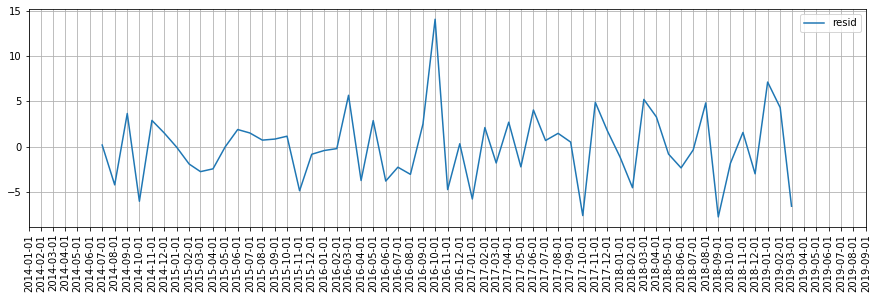



Perkins Homes


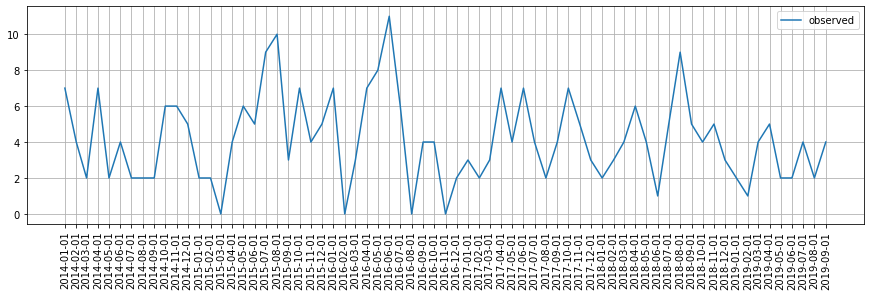

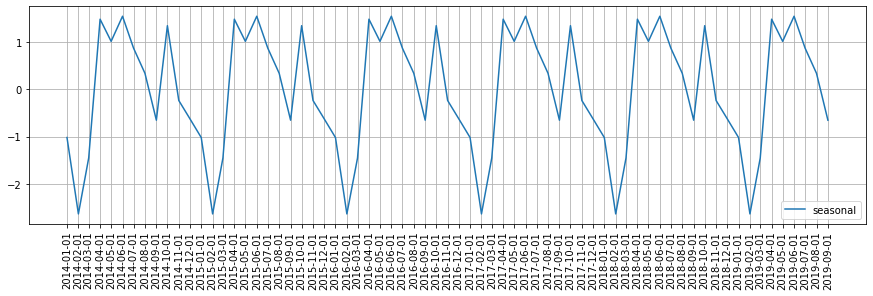

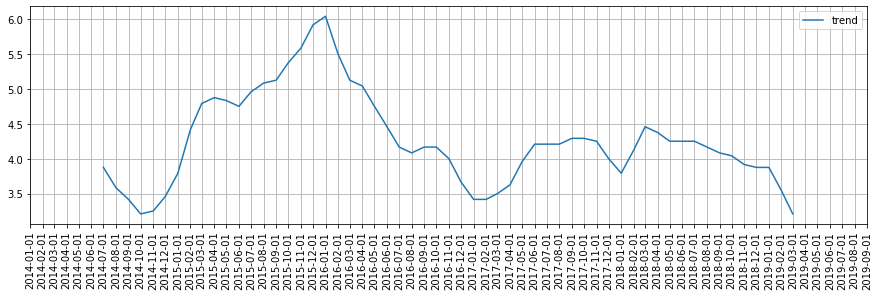

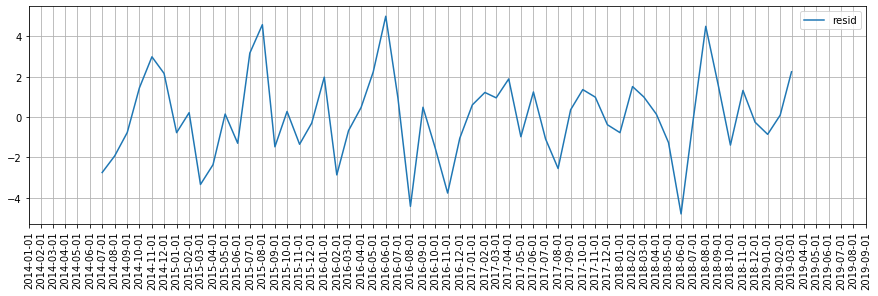



Better Waverly


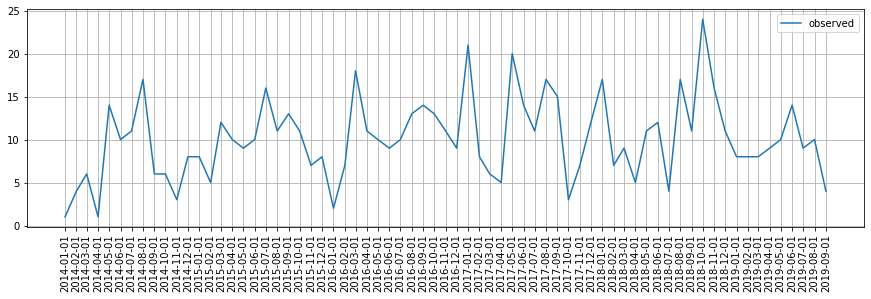

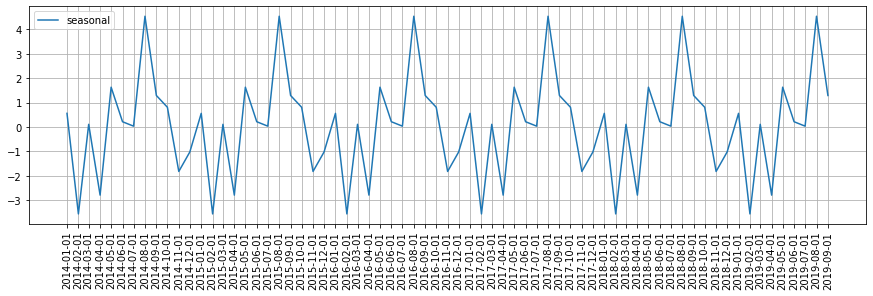

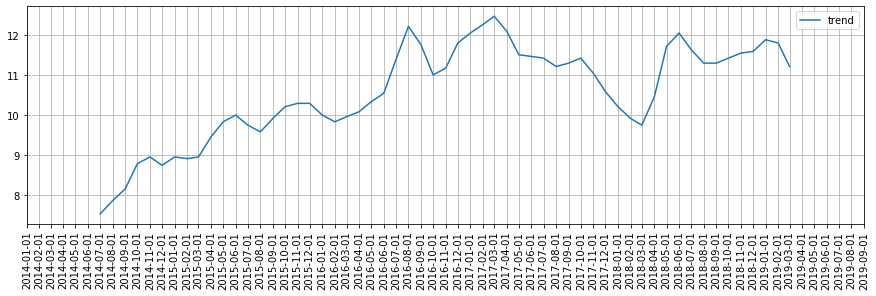

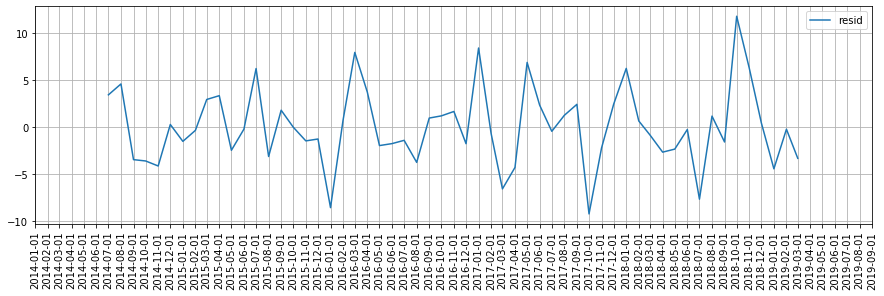



Northwest Community Action


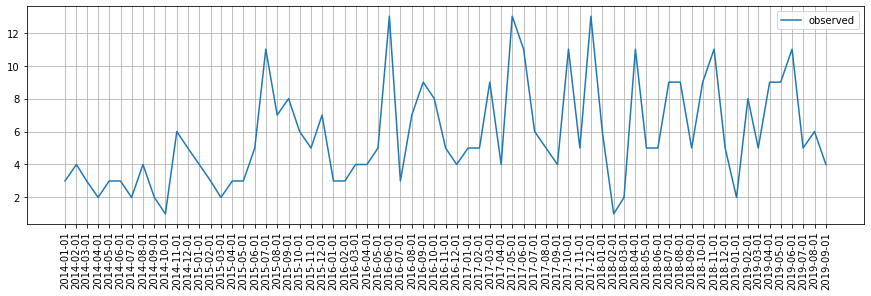

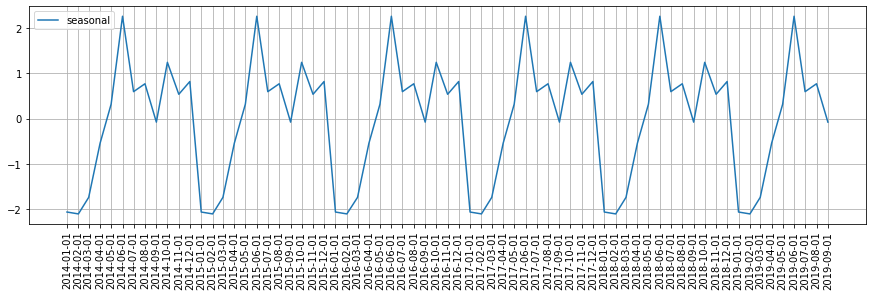

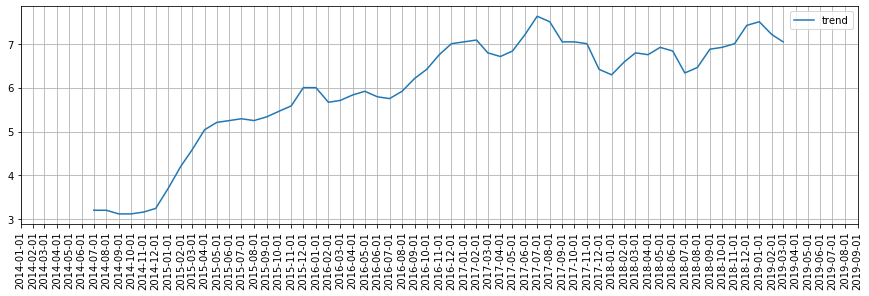

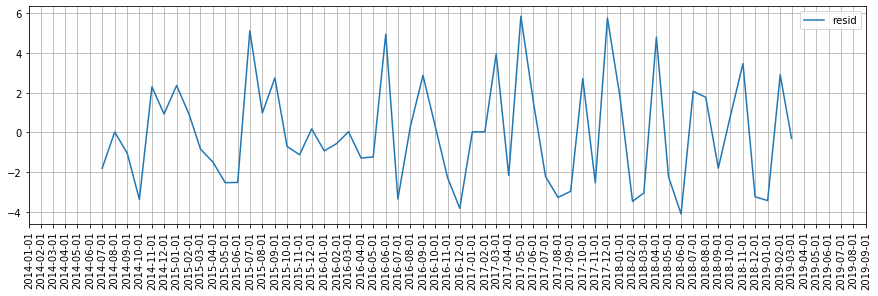



Milton-Montford


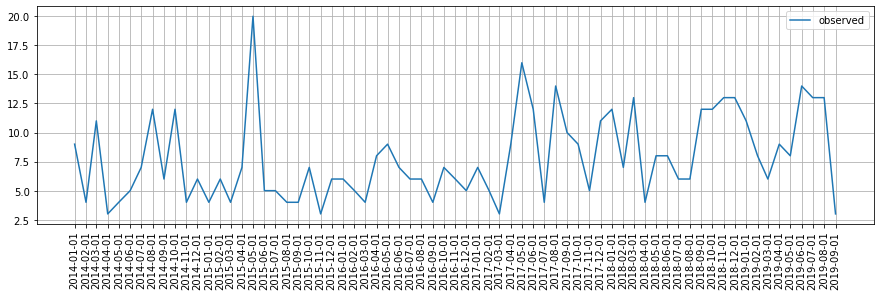

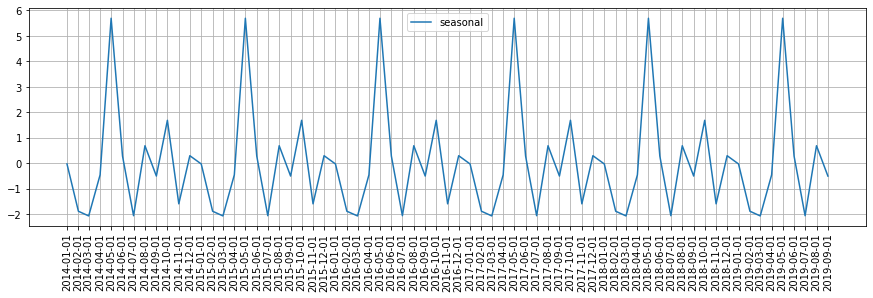

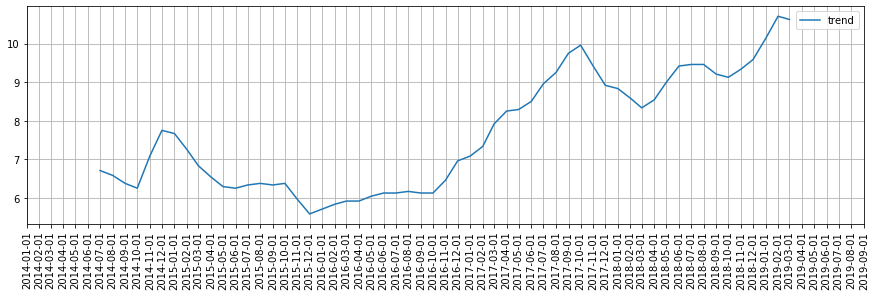

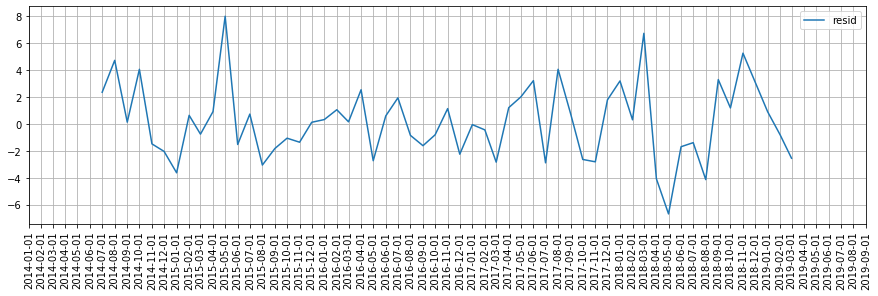



Madison-Eastend


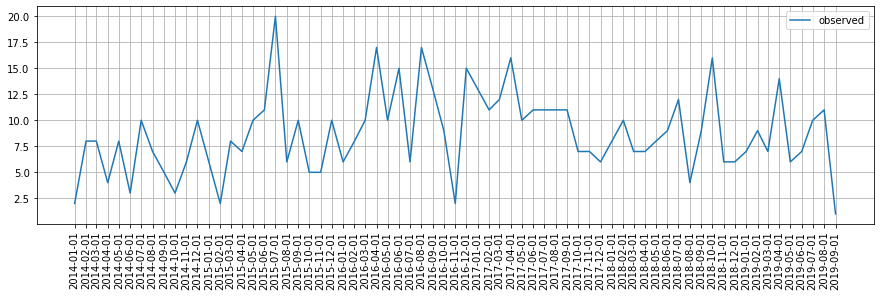

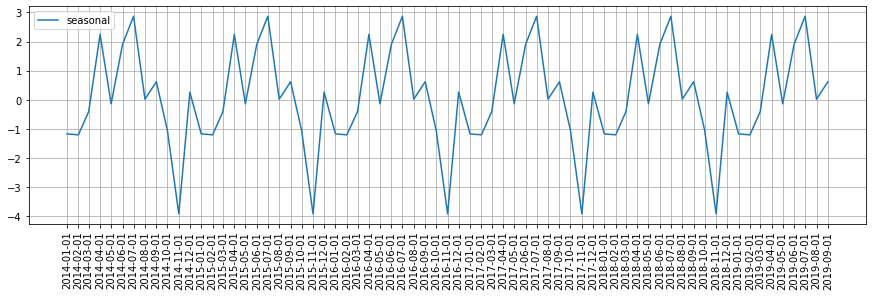

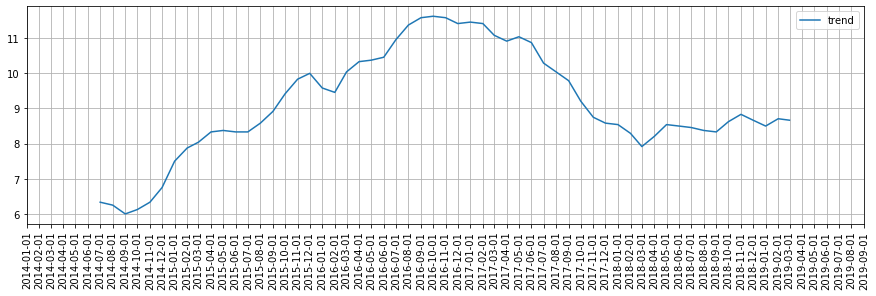

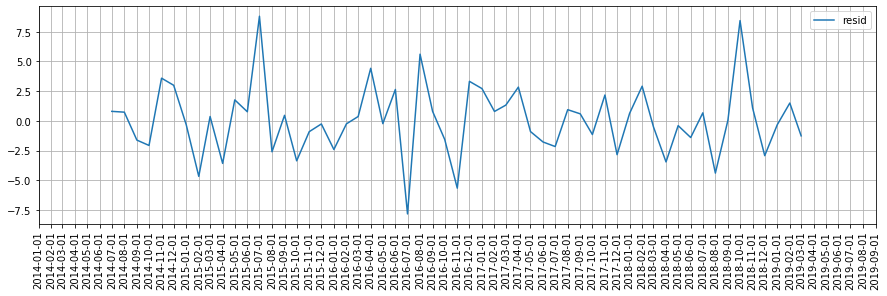



Orangeville


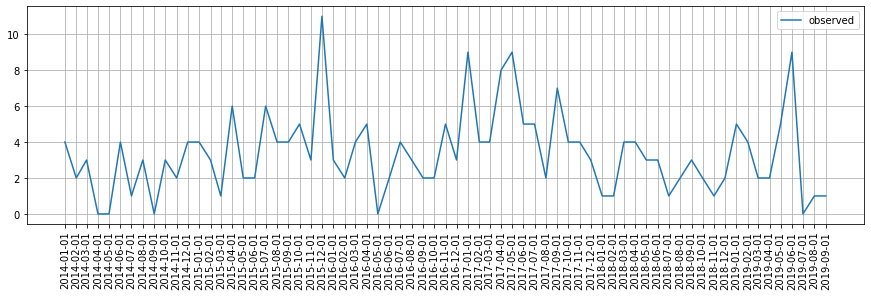

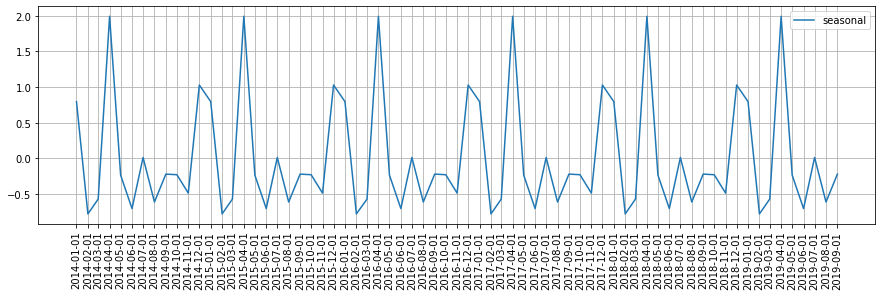

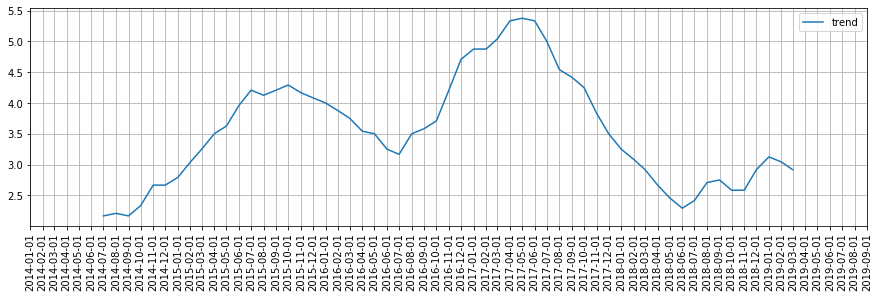

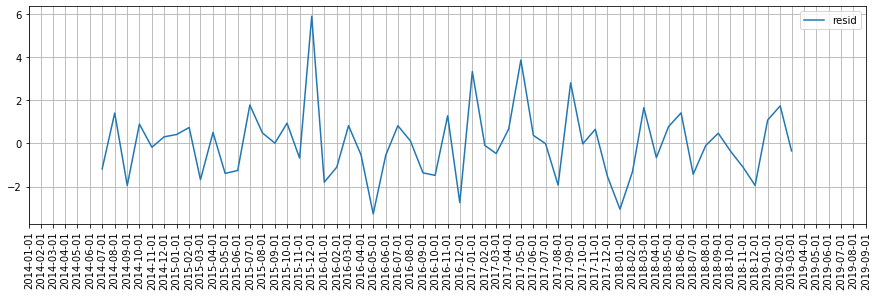



Oliver


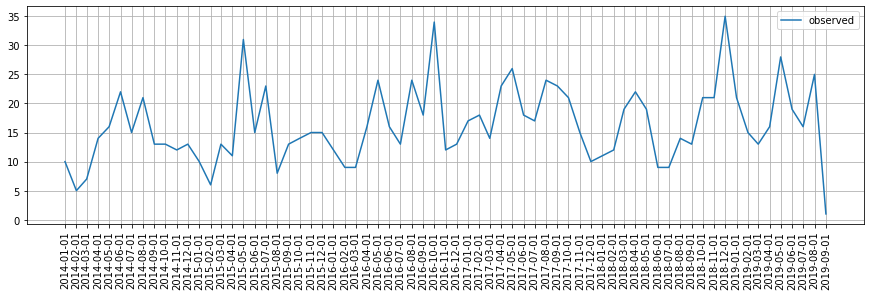

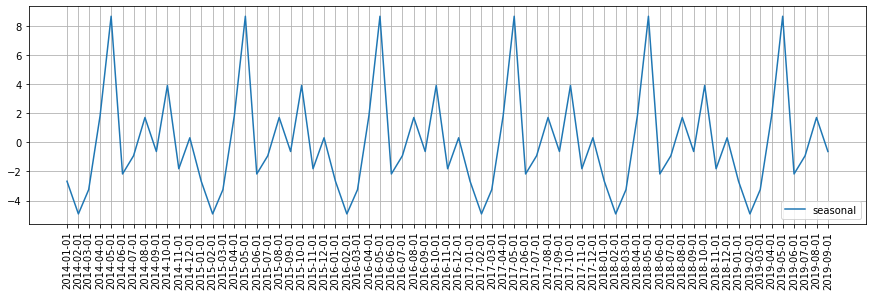

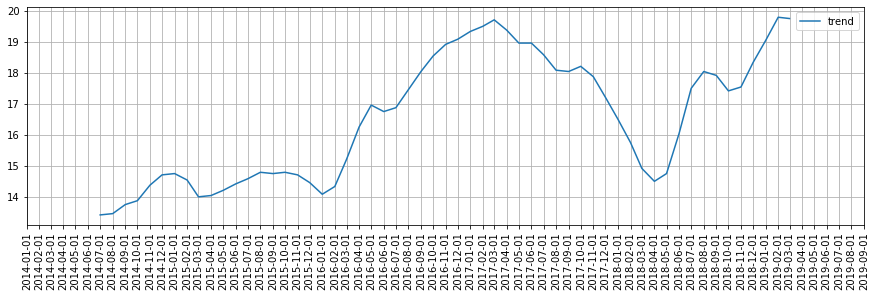

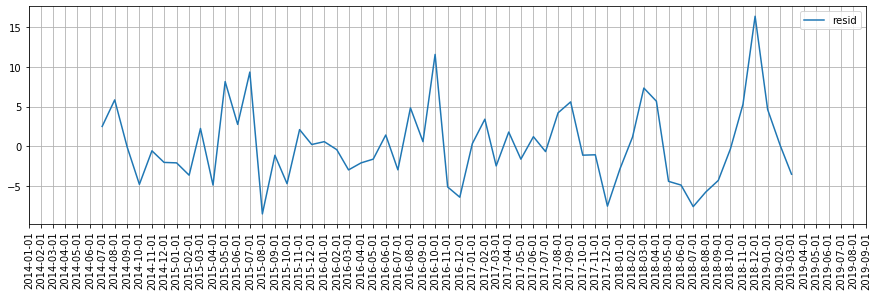



Forest Park


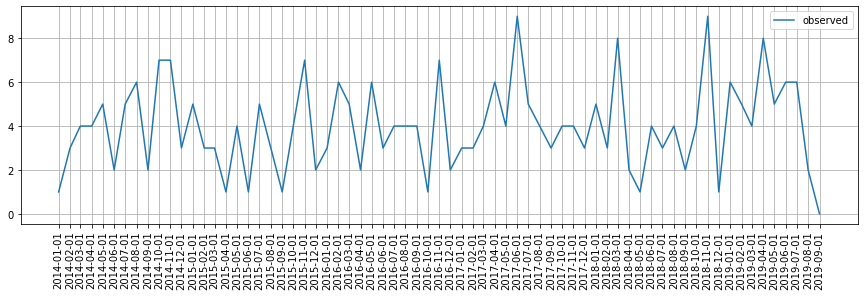

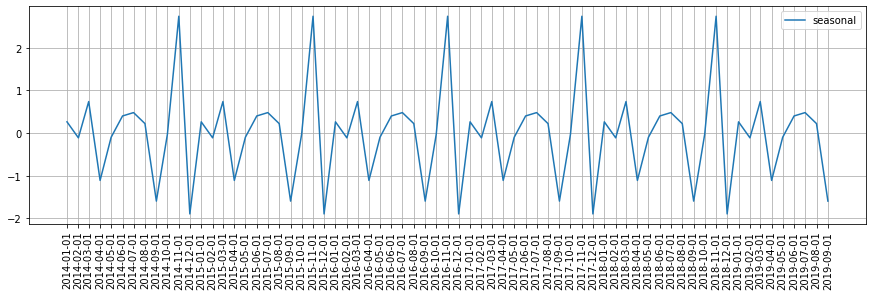

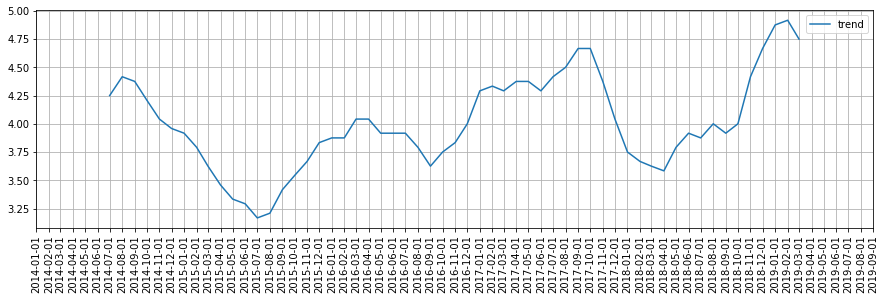

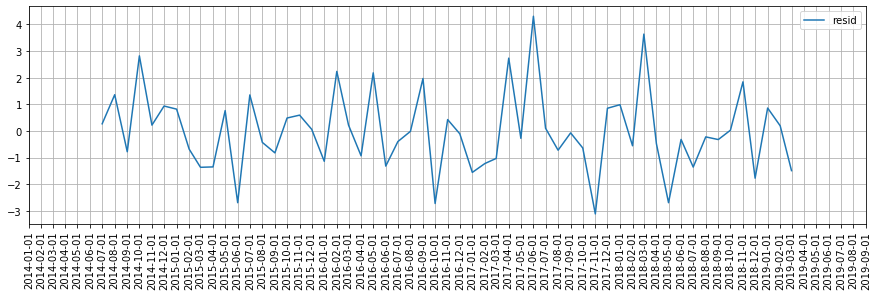



Rosemont


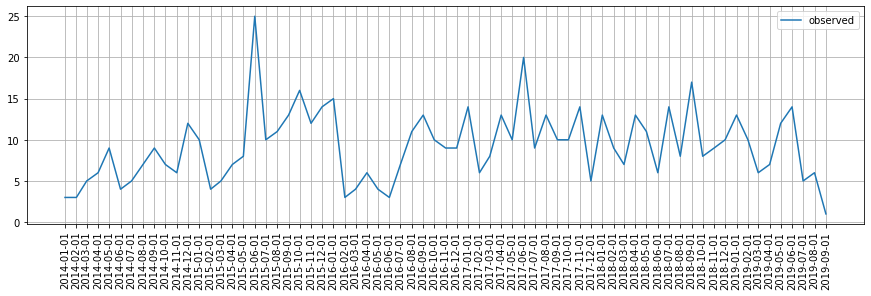

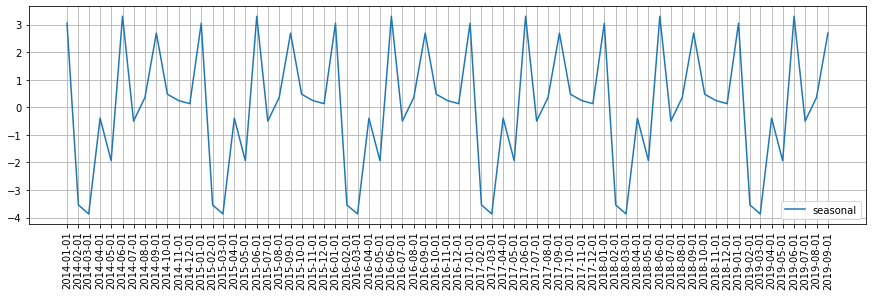

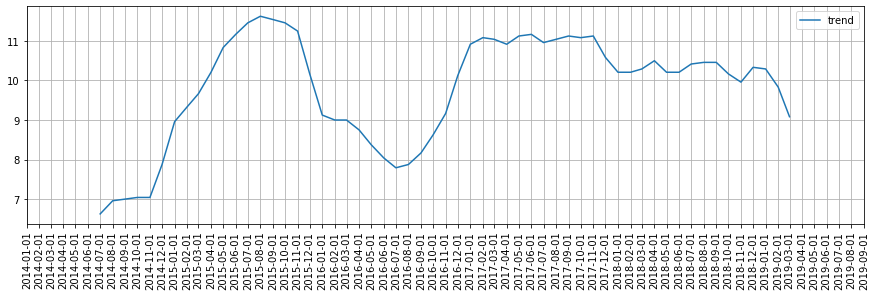

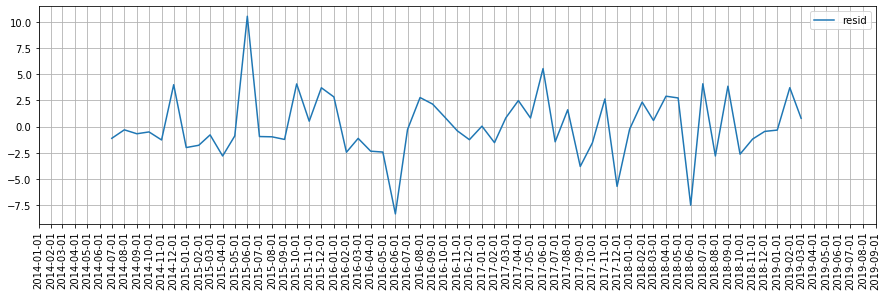



East Baltimore Midway


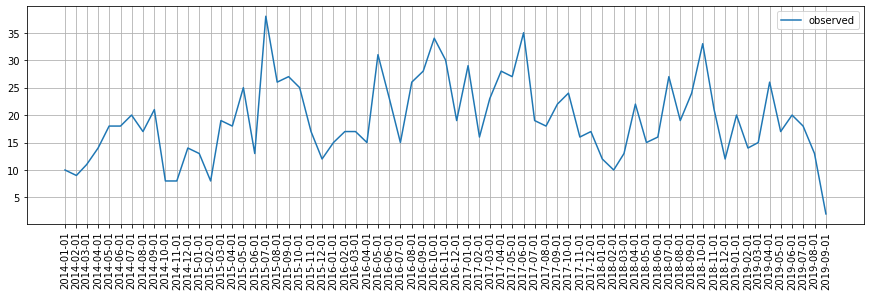

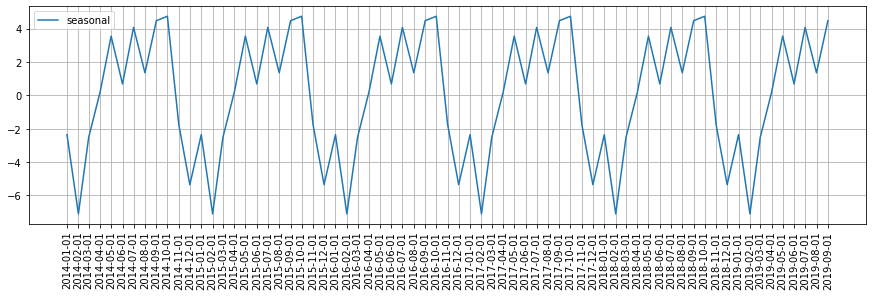

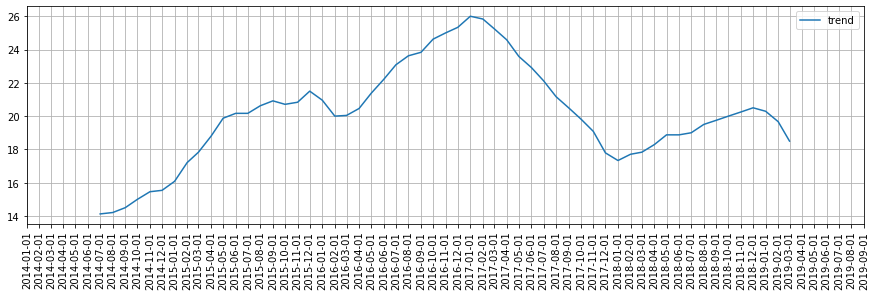

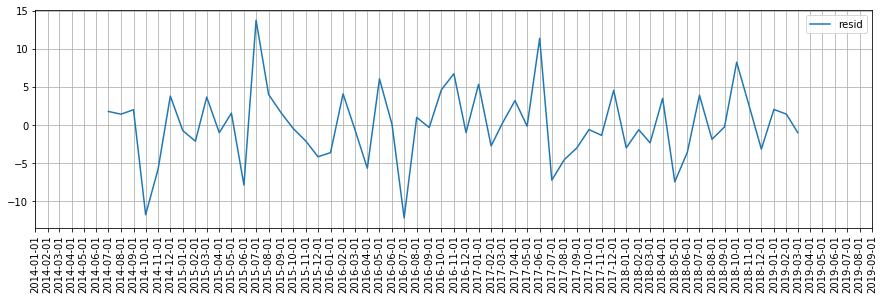



Coldspring


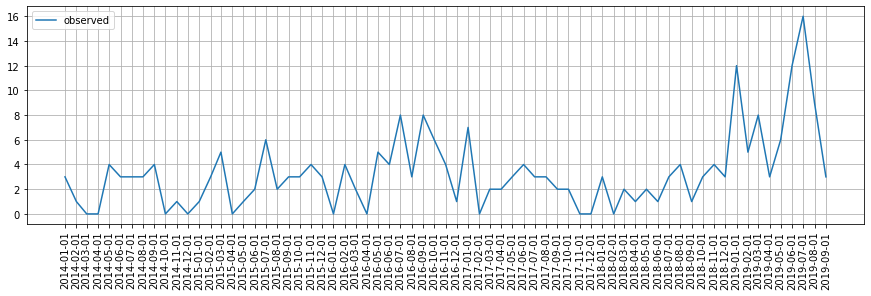

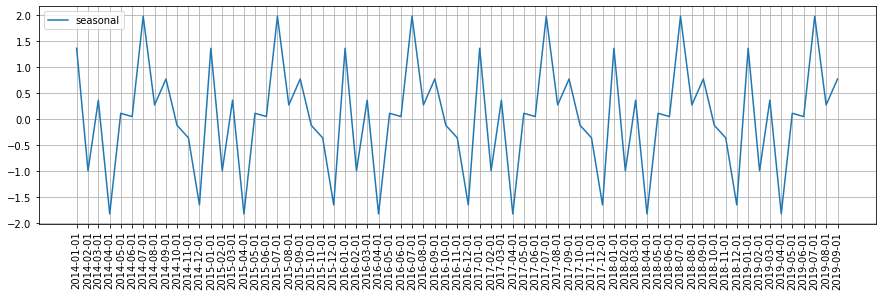

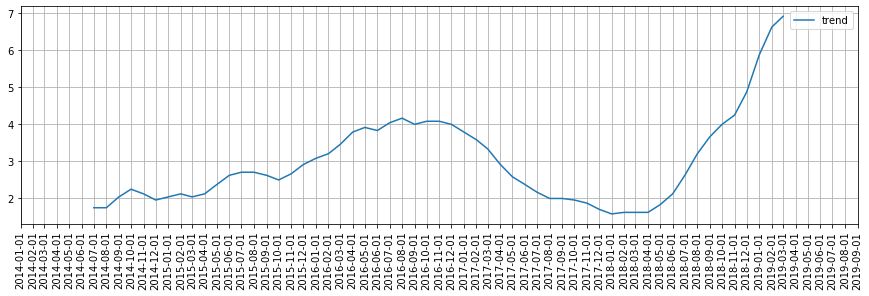

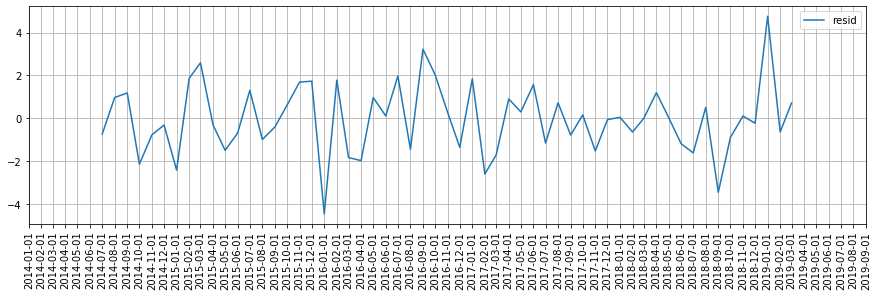



Cedonia


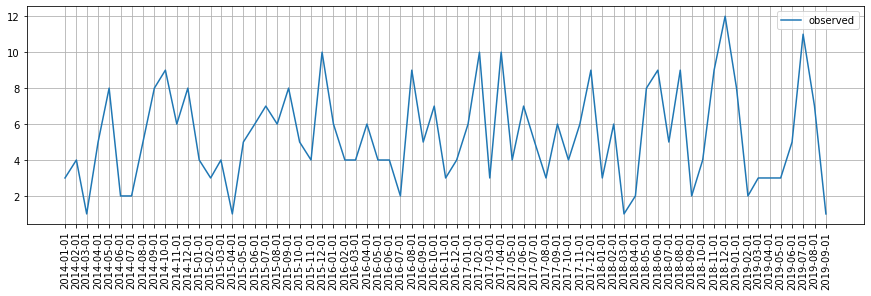

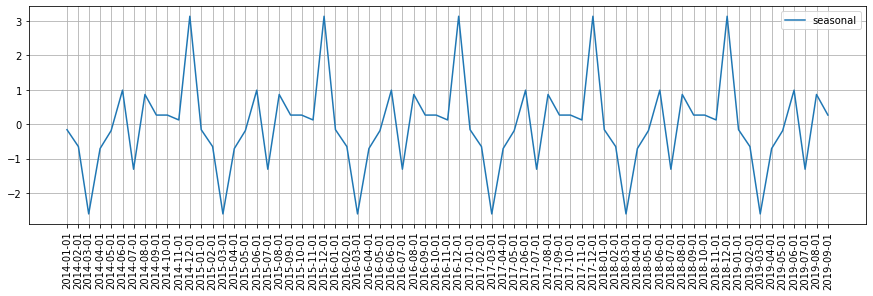

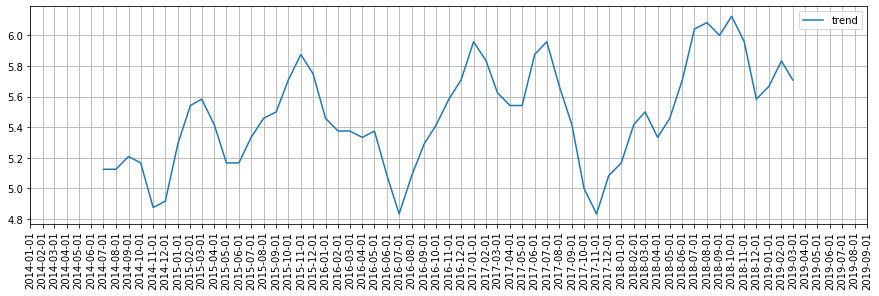

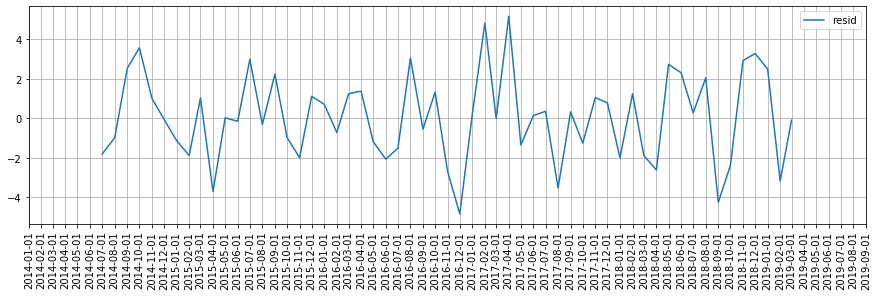



Johnston Square


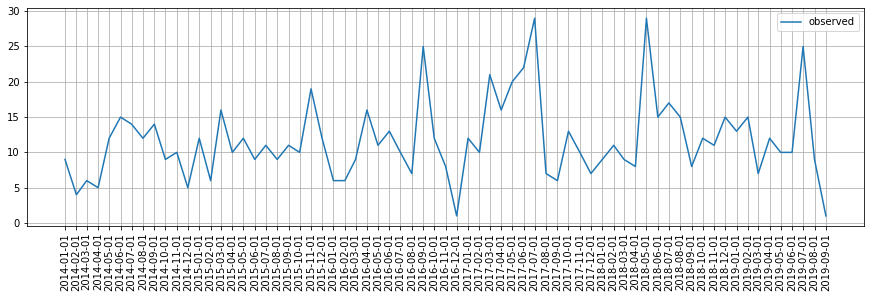

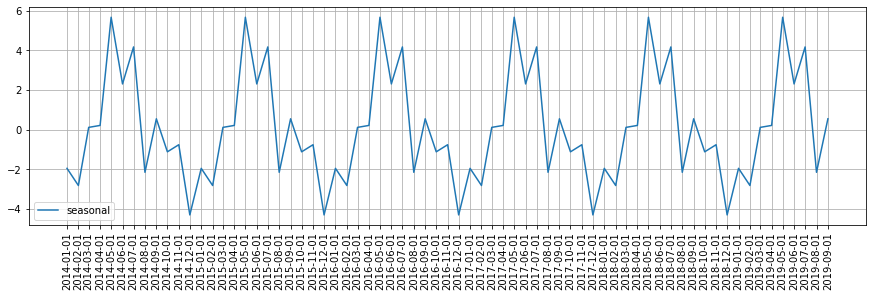

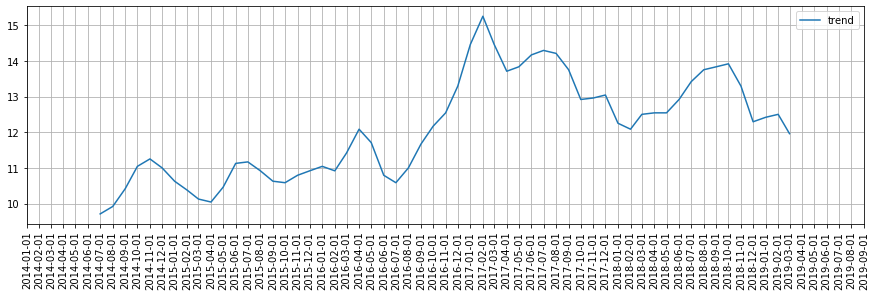

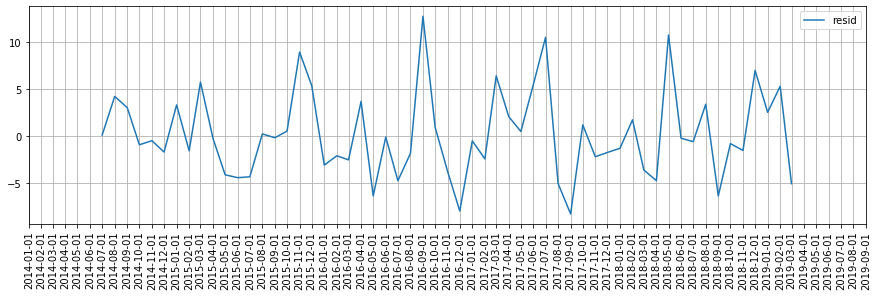



Glenham-Belhar


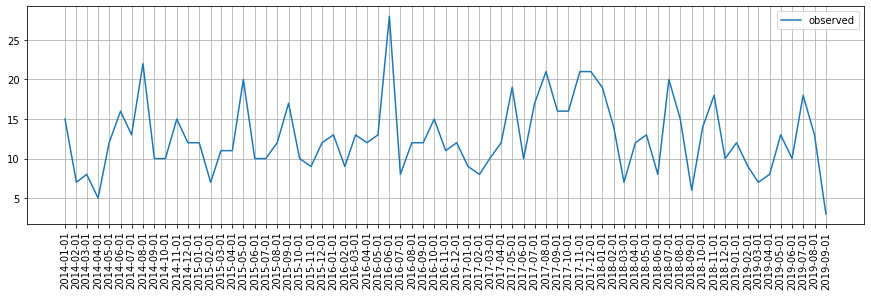

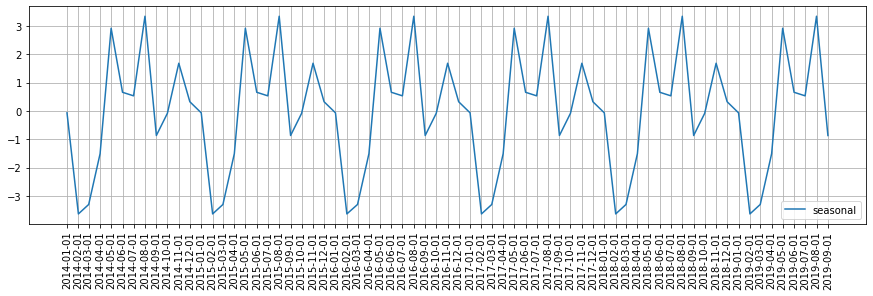

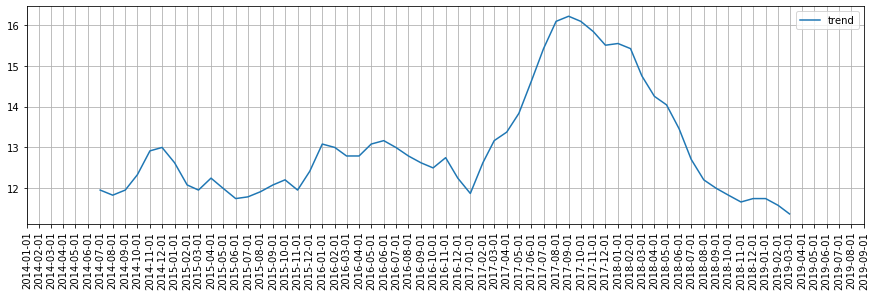

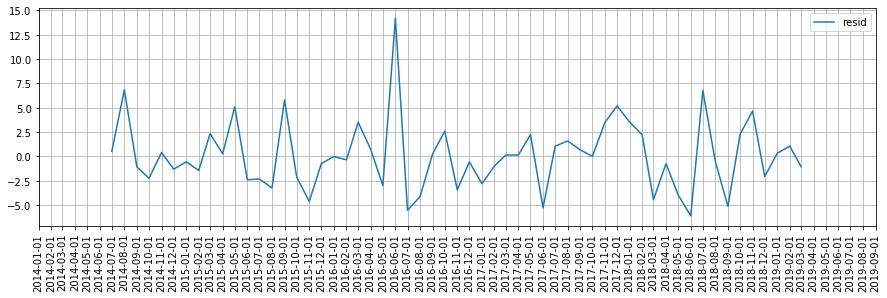



Rosemont Homeowners/Tenants


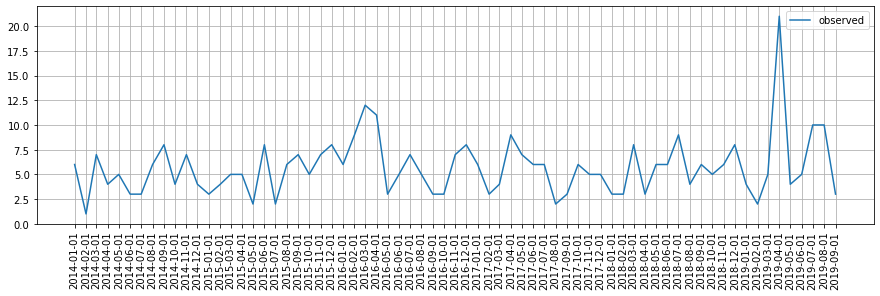

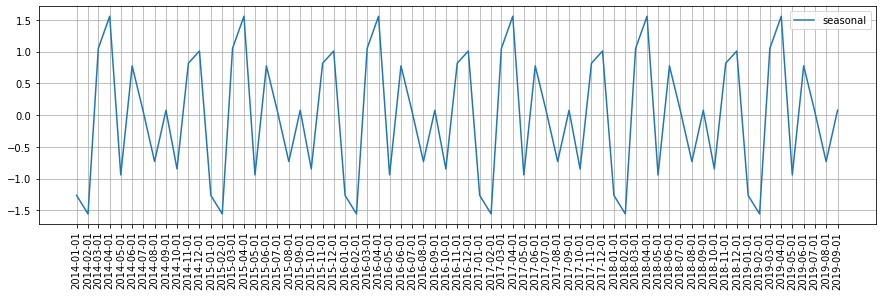

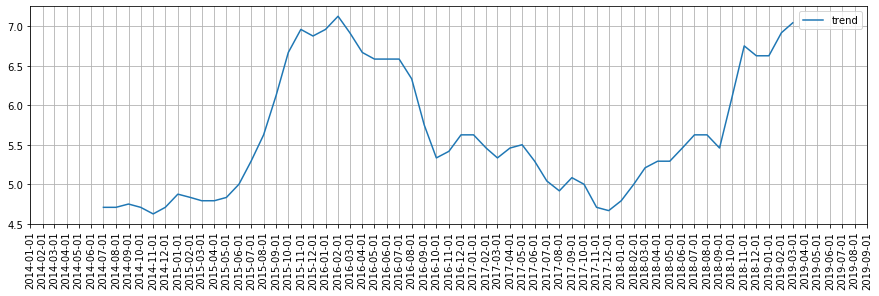

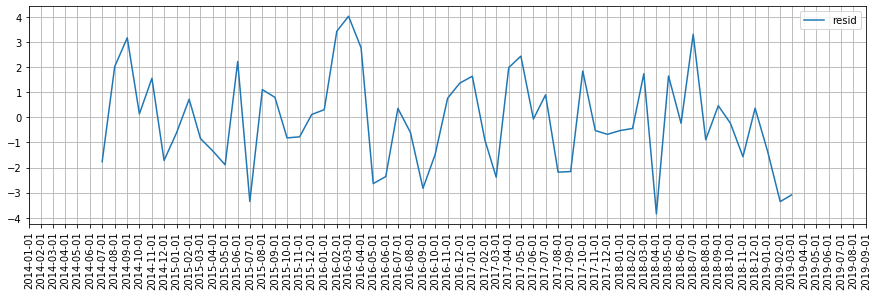



Glen Oaks


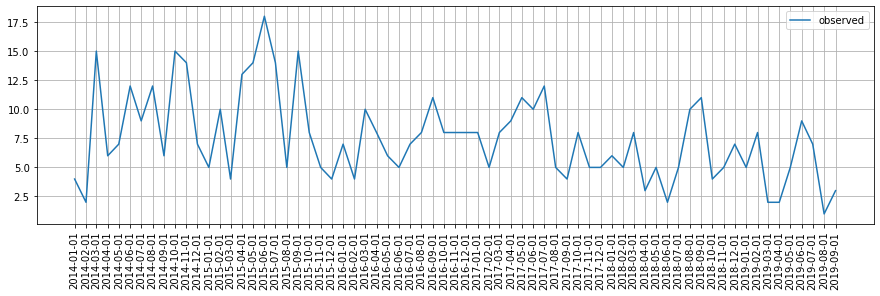

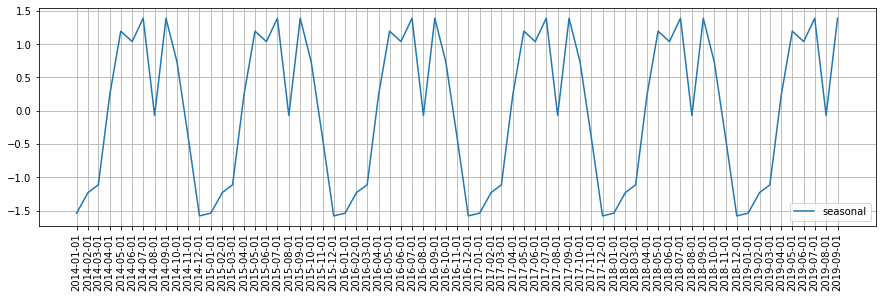

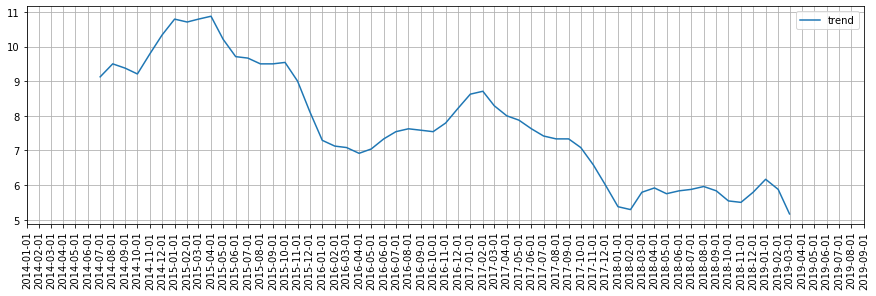

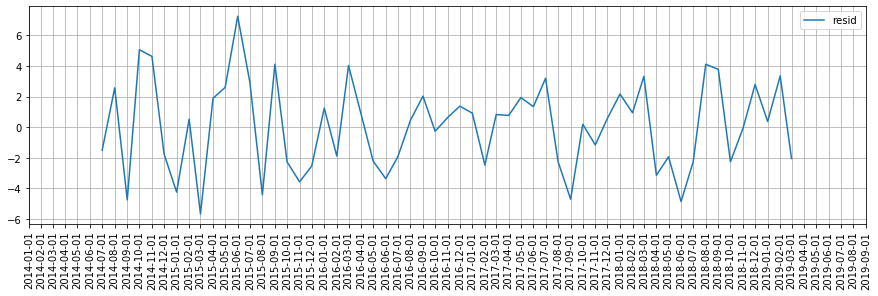



Riverside


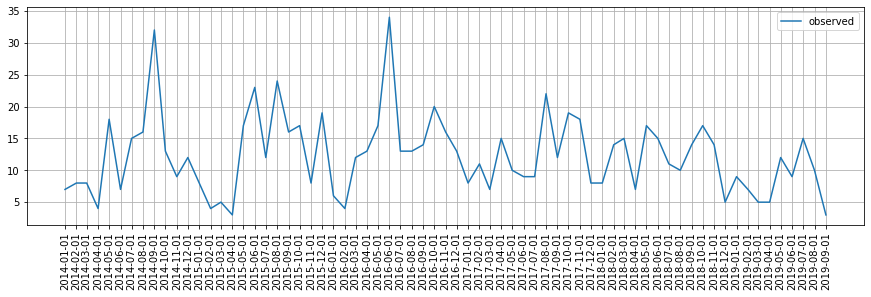

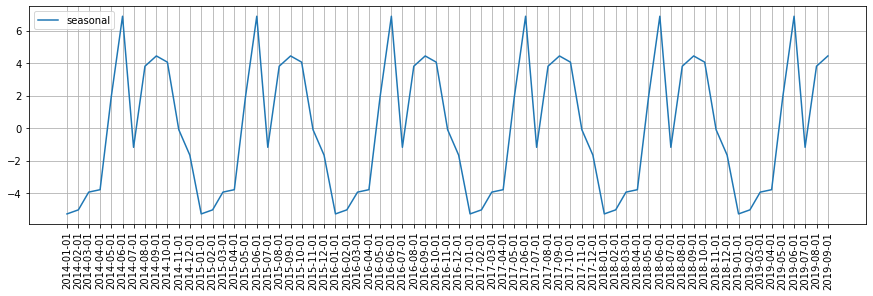

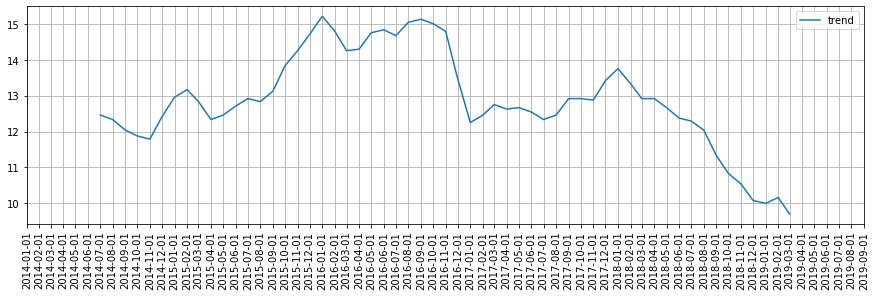

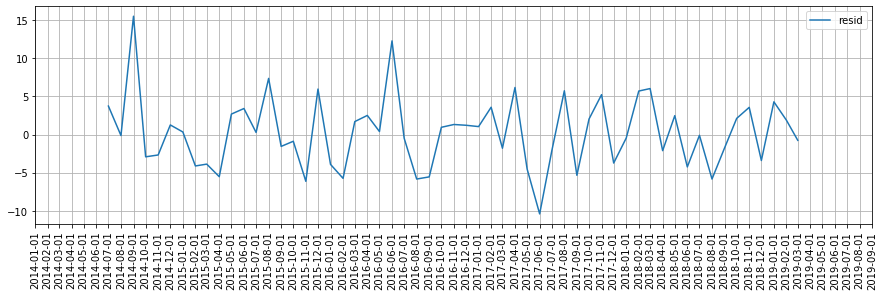



Harlem Park


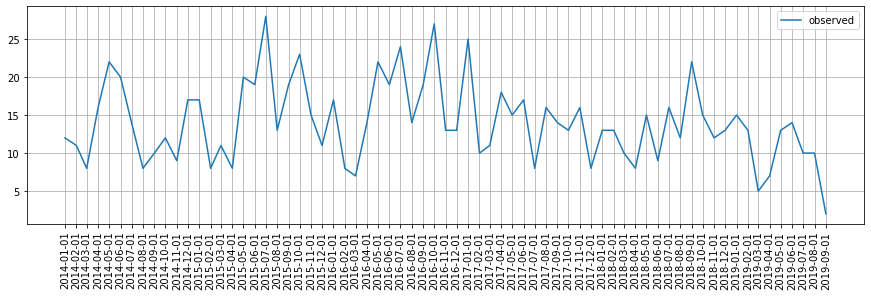

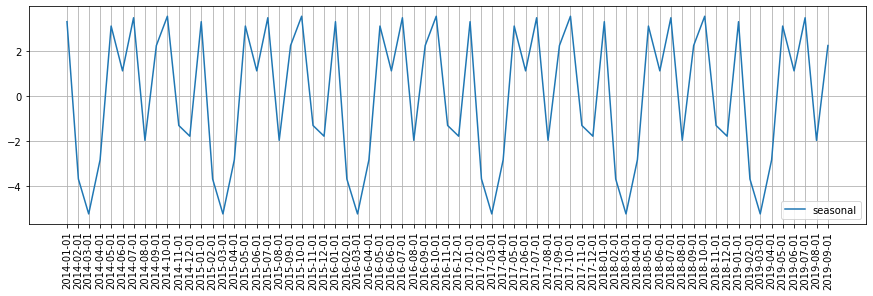

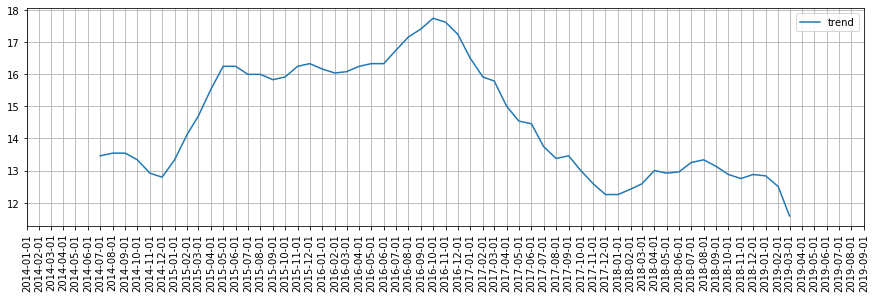

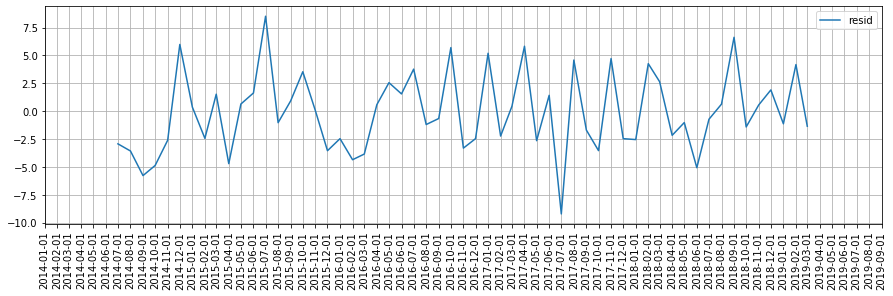



Baltimore Highlands


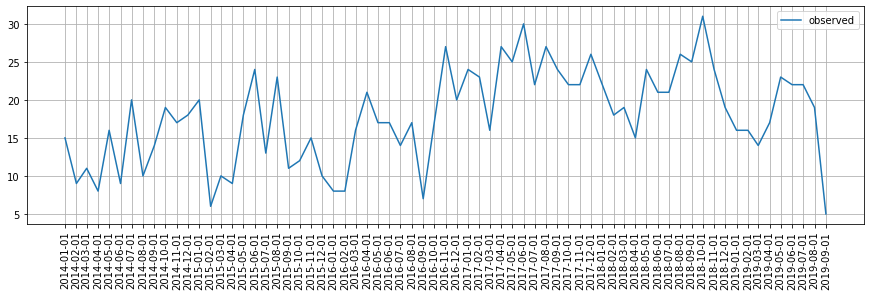

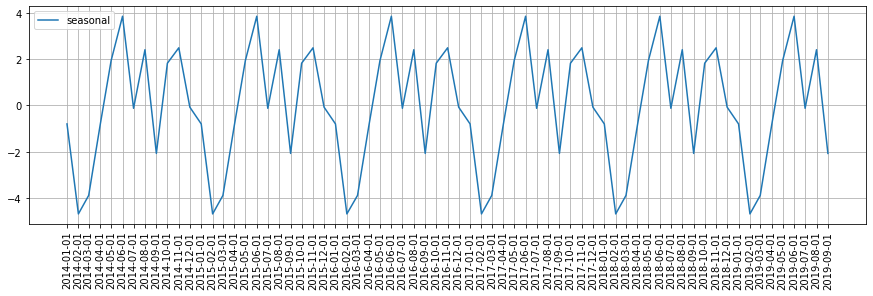

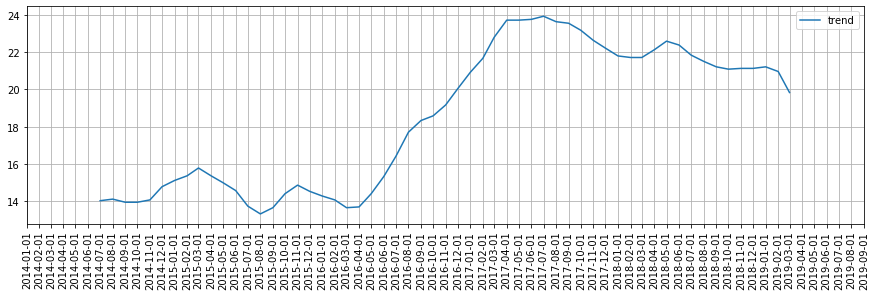

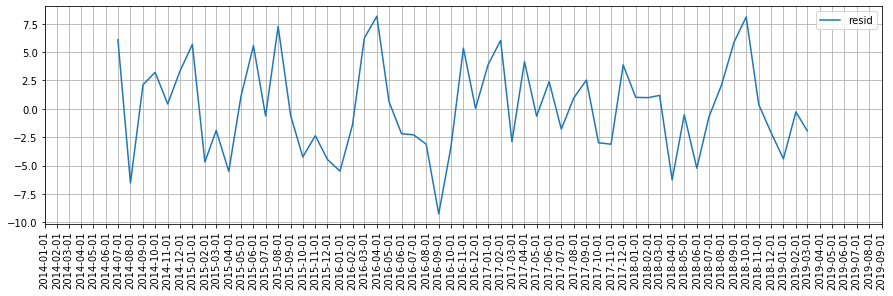



Patterson Place


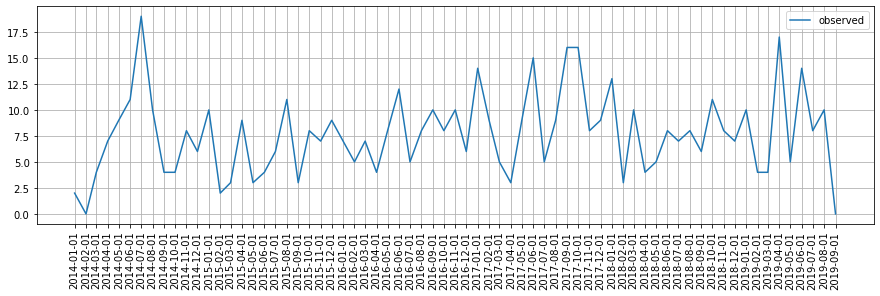

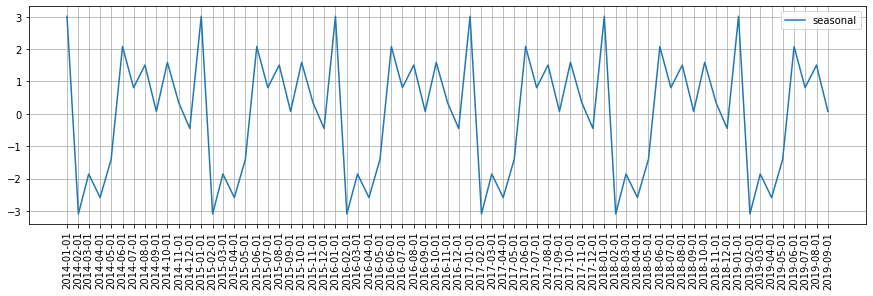

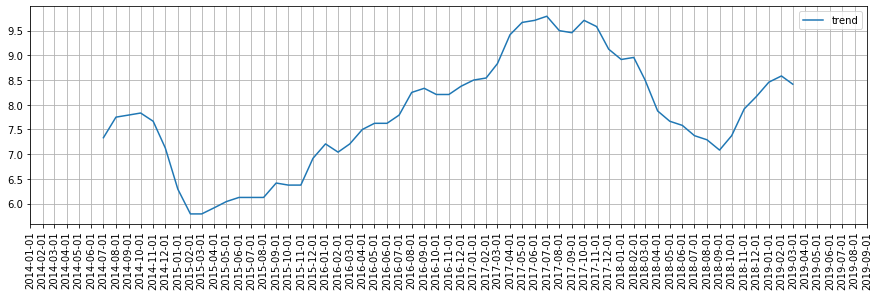

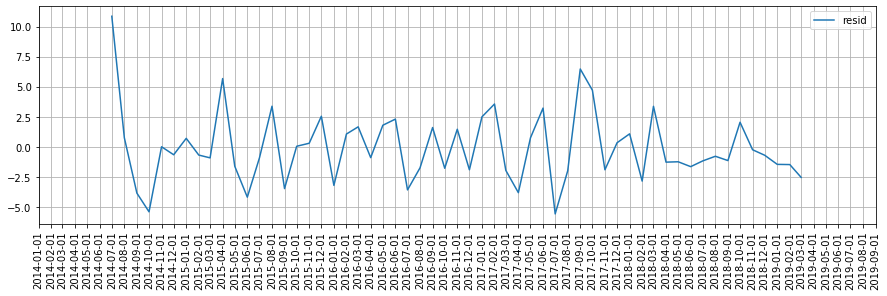



Patterson Park Neighborhood


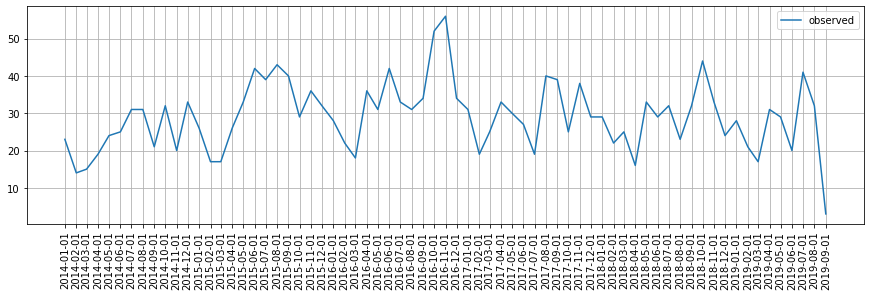

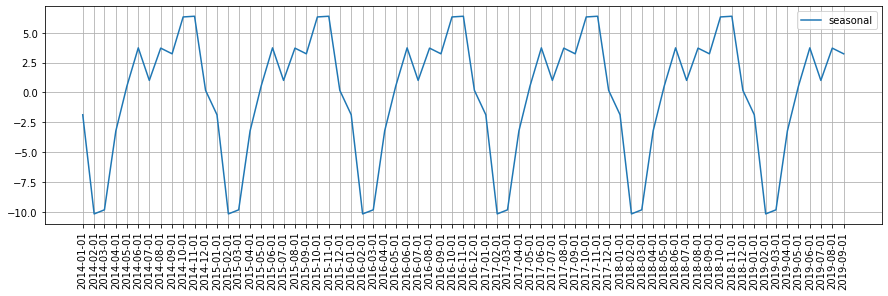

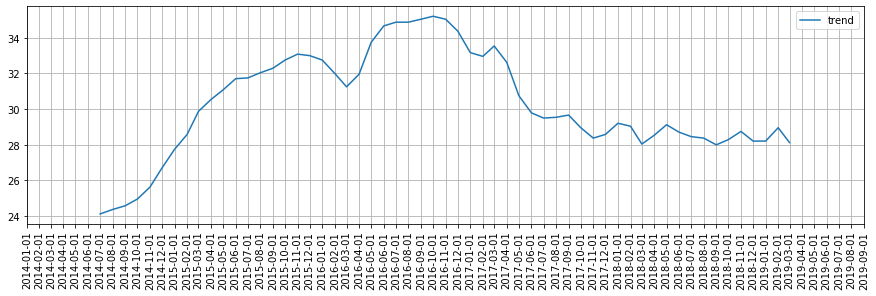

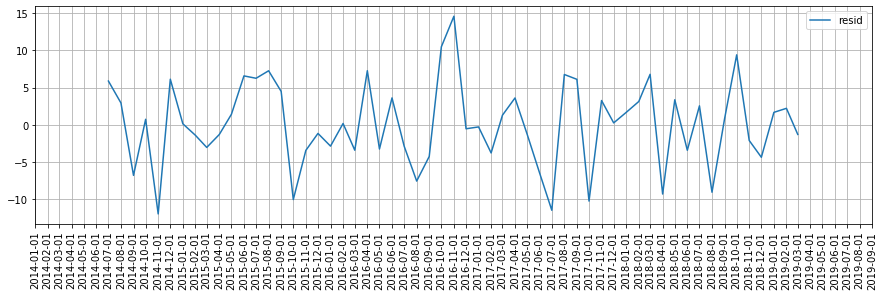



Park Circle


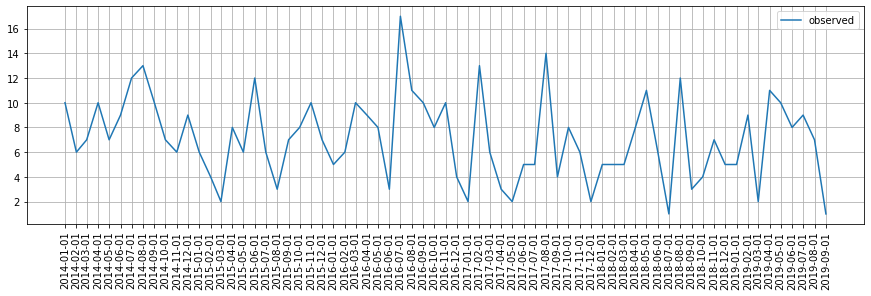

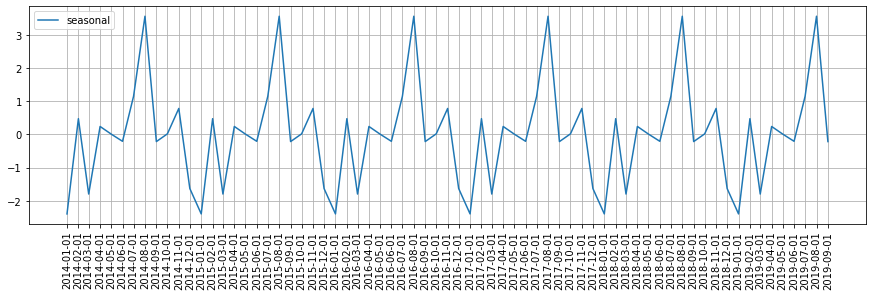

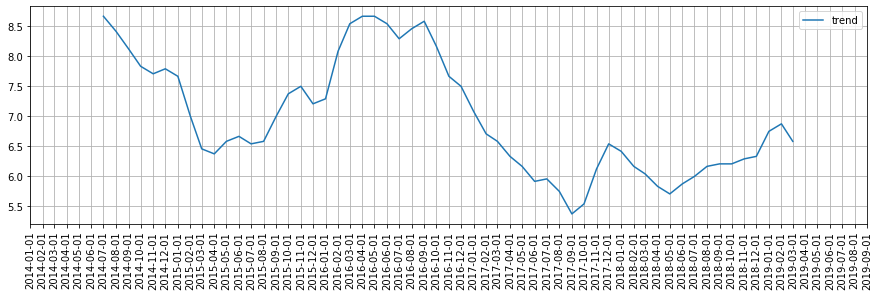

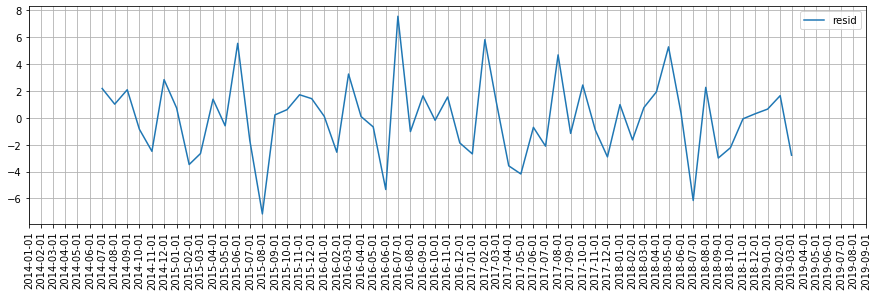



Kresson


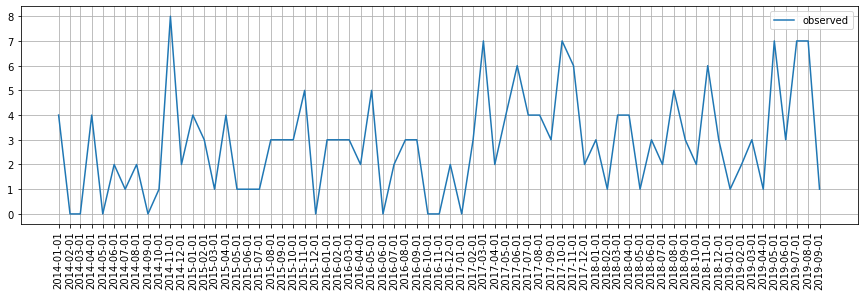

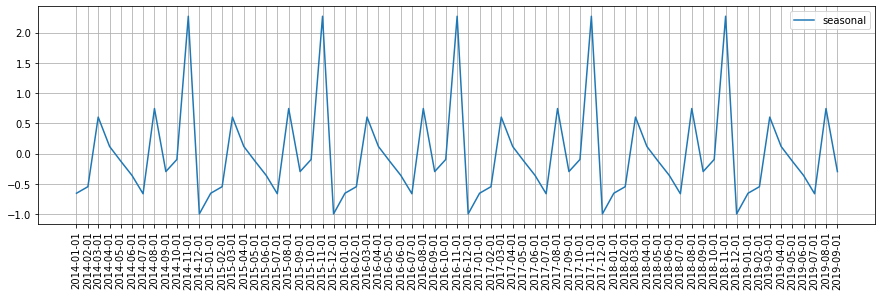

KeyboardInterrupt: 

In [465]:
for neighborhood in count_by_date_indexed.Neighborhood.unique():
    print(neighborhood)
    sliced = count_by_date_indexed[count_by_date_indexed['Neighborhood'] == neighborhood].groupby('Year-Month').sum()
    deomposition = seasonal_decompose(sliced)
    decomplist = [deomposition.observed, deomposition.seasonal, deomposition.trend, deomposition.resid]
    decomplabels = ['observed', 'seasonal', 'trend', 'resid']
    for item, name in zip(decomplist, decomplabels):
        plt.figure(figsize=(15,4))
        plt.plot(item, label=name)
        plt.xticks(item.index, rotation=90)
        plt.grid()
        plt.legend()
        plt.show()
    print('\n')

[Return to contents](#Table-of-Contents)

### Finding neighborhoods with more overall crime

In [69]:
count = 0
for neighborhood in count_by_date_indexed.Neighborhood.unique():
    print(neighborhood)
    sliced = count_by_date_indexed[count_by_date_indexed['Neighborhood'] == neighborhood].groupby('Year-Month').sum()
    if int(sliced.mean()) > 20:
        display(sliced.sort_values(by='Count', ascending=False).head(15))
        count += 1
    else:
        print(f'{neighborhood} mean count is under 20\n')
print(count)

Sandtown-Winchester


,Count
Year-Month,
2015-04-01,73
2017-07-01,49
2015-07-01,49
2017-09-01,48
2017-10-01,47
2015-11-01,46
2016-07-01,43
2014-05-01,43
2015-05-01,41


Downtown


,Count
Year-Month,
2019-08-01,119
2018-07-01,118
2018-06-01,117
2016-06-01,115
2016-05-01,111
2016-09-01,107
2016-10-01,106
2018-10-01,103
2018-09-01,99


Ellwood Park/Monument
Ellwood Park/Monument mean count is under 20

Middle East
Middle East mean count is under 20

Allendale
Allendale mean count is under 20

Pimlico Good Neighbors
Pimlico Good Neighbors mean count is under 20

Reisterstown Station
Reisterstown Station mean count is under 20

Canton


,Count
Year-Month,
2018-10-01,81
2016-11-01,66
2015-09-01,58
2017-01-01,56
2018-11-01,53
2018-12-01,51
2014-07-01,51
2015-10-01,49
2016-10-01,49


Little Italy
Little Italy mean count is under 20

Fells Point


,Count
Year-Month,
2015-07-01,52
2015-08-01,47
2018-10-01,42
2015-09-01,41
2018-08-01,38
2014-05-01,36
2017-07-01,36
2015-05-01,34
2014-07-01,33


Darley Park
Darley Park mean count is under 20

Yale Heights
Yale Heights mean count is under 20

Cherry Hill


,Count
Year-Month,
2016-05-01,44
2015-06-01,42
2017-07-01,40
2016-08-01,39
2018-06-01,39
2015-07-01,39
2017-08-01,38
2018-08-01,36
2017-09-01,34


Lakeland
Lakeland mean count is under 20

Lauraville
Lauraville mean count is under 20

Lake Walker
Lake Walker mean count is under 20

York-Homeland
York-Homeland mean count is under 20

Broadway East


,Count
Year-Month,
2017-06-01,40
2016-05-01,38
2016-11-01,35
2017-04-01,35
2016-10-01,33
2016-09-01,32
2017-09-01,31
2015-05-01,30
2015-09-01,29


Purnell
Purnell mean count is under 20

West Arlington
West Arlington mean count is under 20

Abell
Abell mean count is under 20

Upton


,Count
Year-Month,
2015-08-01,44
2016-11-01,39
2019-08-01,35
2017-07-01,35
2016-05-01,35
2017-06-01,35
2017-09-01,34
2015-07-01,33
2015-11-01,33


Edmondson Village
Edmondson Village mean count is under 20

Medfield
Medfield mean count is under 20

Levindale
Levindale mean count is under 20

Curtis Bay
Curtis Bay mean count is under 20

Perkins Homes
Perkins Homes mean count is under 20

Better Waverly
Better Waverly mean count is under 20

Northwest Community Action
Northwest Community Action mean count is under 20

Milton-Montford
Milton-Montford mean count is under 20

Madison-Eastend
Madison-Eastend mean count is under 20

Orangeville
Orangeville mean count is under 20

Oliver
Oliver mean count is under 20

Forest Park
Forest Park mean count is under 20

Rosemont
Rosemont mean count is under 20

East Baltimore Midway
East Baltimore Midway mean count is under 20

Coldspring
Coldspring mean count is under 20

Cedonia
Cedonia mean count is under 20

Johnston Square
Johnston Square mean count is under 20

Glenham-Belhar
Glenham-Belhar mean count is under 20

Rosemont Homeowners/Tenants
Rosemont Homeowners/Tenants mean count is un

,Count
Year-Month,
2016-11-01,56
2016-10-01,52
2018-10-01,44
2015-08-01,43
2015-06-01,42
2016-06-01,42
2019-07-01,41
2015-09-01,40
2017-08-01,40


Park Circle
Park Circle mean count is under 20

Kresson
Kresson mean count is under 20

Callaway-Garrison
Callaway-Garrison mean count is under 20

Clifton Park
Clifton Park mean count is under 20

Windsor Hills
Windsor Hills mean count is under 20

Coldstream Homestead Montebello


,Count
Year-Month,
2015-12-01,41
2018-08-01,39
2017-05-01,38
2015-05-01,37
2017-01-01,35
2016-05-01,33
2015-11-01,33
2015-10-01,32
2018-01-01,32


Central Park Heights
Central Park Heights mean count is under 20

Charles Village
Charles Village mean count is under 20

Mid-Govans
Mid-Govans mean count is under 20

Langston Hughes
Langston Hughes mean count is under 20

Ashburton
Ashburton mean count is under 20

Dorchester
Dorchester mean count is under 20

West Hills
West Hills mean count is under 20

New Northwood
New Northwood mean count is under 20

Port Covington
Port Covington mean count is under 20

Mount Vernon


,Count
Year-Month,
2018-08-01,34
2015-11-01,34
2017-10-01,34
2019-01-01,33
2016-06-01,32
2019-08-01,32
2016-07-01,31
2015-07-01,31
2019-05-01,29


Westgate
Westgate mean count is under 20

Penrose/Fayette Street Outreach
Penrose/Fayette Street Outreach mean count is under 20

Morrell Park
Morrell Park mean count is under 20

Beechfield
Beechfield mean count is under 20

Brooklyn


,Count
Year-Month,
2017-07-01,76
2017-08-01,71
2017-06-01,70
2016-10-01,67
2017-11-01,61
2018-06-01,60
2018-11-01,60
2016-07-01,59
2017-01-01,59


New Southwest/Mount Clare
New Southwest/Mount Clare mean count is under 20

Waltherson
Waltherson mean count is under 20

Belair-Edison


,Count
Year-Month,
2017-10-01,66
2014-08-01,59
2018-10-01,58
2017-01-01,56
2016-06-01,56
2017-11-01,54
2015-07-01,53
2018-01-01,53
2018-04-01,52


Federal Hill
Federal Hill mean count is under 20

Cedmont
Cedmont mean count is under 20

Hillen
Hillen mean count is under 20

Orangeville Industrial Area
Orangeville Industrial Area mean count is under 20

Cylburn
Cylburn mean count is under 20

Washington Village/Pigtown


,Count
Year-Month,
2018-09-01,42
2018-12-01,39
2014-06-01,37
2017-09-01,34
2014-05-01,33
2018-05-01,33
2019-08-01,33
2014-03-01,32
2014-09-01,32


Bellona-Gittings
Bellona-Gittings mean count is under 20

Jonestown
Jonestown mean count is under 20

Heritage Crossing
Heritage Crossing mean count is under 20

Barclay
Barclay mean count is under 20

Franklin Square
Franklin Square mean count is under 20

Mondawmin
Mondawmin mean count is under 20

Parkview/Woodbrook
Parkview/Woodbrook mean count is under 20

Gay Street
Gay Street mean count is under 20

Saint Josephs
Saint Josephs mean count is under 20

Shipley Hill
Shipley Hill mean count is under 20

Rognel Heights
Rognel Heights mean count is under 20

Mid-Town Belvedere
Mid-Town Belvedere mean count is under 20

Mosher
Mosher mean count is under 20

Westfield
Westfield mean count is under 20

North Harford Road
North Harford Road mean count is under 20

Downtown West
Downtown West mean count is under 20

Graceland Park
Graceland Park mean count is under 20

Hamilton Hills
Hamilton Hills mean count is under 20

Frankford


,Count
Year-Month,
2019-07-01,93
2017-05-01,77
2017-10-01,76
2019-08-01,66
2017-07-01,63
2017-11-01,63
2015-09-01,60
2015-08-01,59
2016-10-01,57


University Of Maryland
University Of Maryland mean count is under 20

Edgewood
Edgewood mean count is under 20

Kernewood
Kernewood mean count is under 20

Evesham Park
Evesham Park mean count is under 20

Glen
Glen mean count is under 20

Broening Manor
Broening Manor mean count is under 20

Canton Industrial Area
Canton Industrial Area mean count is under 20

Arlington
Arlington mean count is under 20

Greenmount West
Greenmount West mean count is under 20

Care
Care mean count is under 20

Franklintown Road
Franklintown Road mean count is under 20

Highlandtown
Highlandtown mean count is under 20

Bayview
Bayview mean count is under 20

Hanlon-Longwood
Hanlon-Longwood mean count is under 20

Millhill
Millhill mean count is under 20

Hampden
Hampden mean count is under 20

Parklane
Parklane mean count is under 20

Garwyn Oaks
Garwyn Oaks mean count is under 20

North Roland Park/Poplar Hill
North Roland Park/Poplar Hill mean count is under 20

Greenspring
Greenspring mean count is un

,Count
Year-Month,
2016-10-01,38
2018-10-01,34
2018-12-01,33
2017-07-01,32
2015-05-01,32
2017-01-01,31
2019-05-01,31
2017-06-01,29
2018-03-01,28


Woodbourne Heights
Woodbourne Heights mean count is under 20

Bridgeview/Greenlawn
Bridgeview/Greenlawn mean count is under 20

Concerned Citizens Of Forest Park
Concerned Citizens Of Forest Park mean count is under 20

Washington Hill
Washington Hill mean count is under 20

Madison Park
Madison Park mean count is under 20

Union Square
Union Square mean count is under 20

Hollins Market
Hollins Market mean count is under 20

Fairfield Area
Fairfield Area mean count is under 20

Wrenlane
Wrenlane mean count is under 20

Midtown-Edmondson
Midtown-Edmondson mean count is under 20

Armistead Gardens
Armistead Gardens mean count is under 20

Brewers Hill
Brewers Hill mean count is under 20

Wilhelm Park
Wilhelm Park mean count is under 20

Howard Park
Howard Park mean count is under 20

Lucille Park
Lucille Park mean count is under 20

Wyman Park
Wyman Park mean count is under 20

Uplands
Uplands mean count is under 20

Cross Keys
Cross Keys mean count is under 20

Easterwood
Easterwood me

[Return to contents](#Table-of-Contents)

### Make a DataFrame for Downtown with date and time information to try to find out what I can from it

In [71]:
neighborhoods_out = {}
total_out = {}
dates = {}
times = {}

for date in df.CrimeDate.unique():
    for time in df.TimeSlot.unique():
        total_out[f'{date}_{time}'] = df[(df['Inside/Outside'] == 'O') & (df['Neighborhood'] == 'Downtown') & (df['CrimeDate'] == date) & (df['TimeSlot'] == time)]['Count'].sum()
        neighborhoods_out[f'{date}_{time}'] = 'Downtown'
        dates[f'{date}_{time}'] = date
        times[f'{date}_{time}'] = time
downtown_datetime = pd.DataFrame()
downtown_datetime['Neighborhood'] = neighborhoods_out.values()
downtown_datetime['Count'] = total_out.values()
downtown_datetime['Date'] = dates.values()
downtown_datetime['TimeSlot'] = times.values()

In [72]:
downtown_datetime.head()

,Neighborhood,Count,Date,TimeSlot
0,Downtown,0,09/07/2019,06:00:00
1,Downtown,1,09/07/2019,15:00:00
2,Downtown,0,09/07/2019,21:00:00
3,Downtown,0,09/07/2019,00:00:00
4,Downtown,0,09/07/2019,18:00:00


Look into this neighborhood by month

In [73]:
downtown_month = count_by_date_indexed[count_by_date_indexed['Neighborhood'] == 'Downtown'].groupby('Year-Month').sum()

In [90]:
downtown_month.head()

,Count
Year-Month,
2014-01-01,48
2014-02-01,39
2014-03-01,53
2014-04-01,66
2014-05-01,70


In [91]:
downtown_month.describe()

,Count
count,69.000000
mean,70.420290
std,21.957449
min,19.000000
25%,55.000000
50%,66.000000
75%,84.000000
max,119.000000


In [92]:
downtown_month.sort_values(by='Count', ascending=False)

,Count
Year-Month,
2019-08-01,119
2018-07-01,118
2018-06-01,117
2016-06-01,115
2016-05-01,111
...,...
2015-01-01,44
2016-02-01,43
2014-02-01,39


Plotting the overall crime by month to find months to look further into to see if I can find events that cause crime to spike

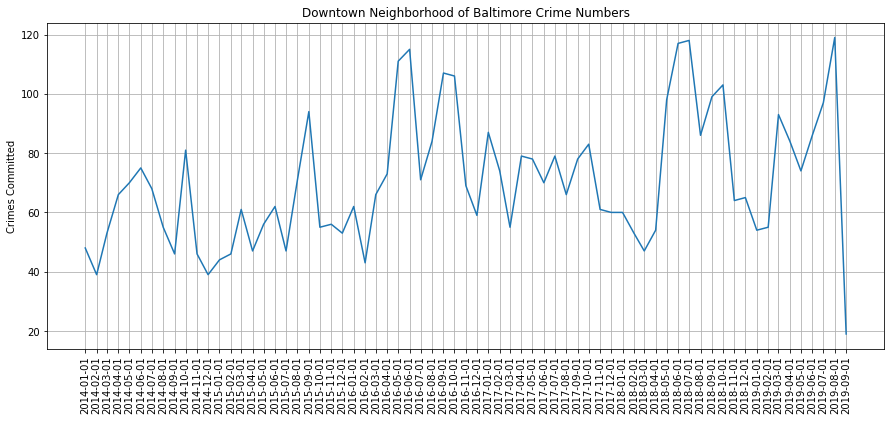

In [432]:
plt.figure(figsize=(15,6))
plt.plot(downtown_month)
plt.xticks(downtown_month.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

In [99]:
testing = downtown_datetime.copy()

In [100]:
downtown_datetime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17128 entries, 0 to 17127
Data columns (total 4 columns):
Neighborhood    17128 non-null object
Count           17128 non-null int64
Date            17128 non-null object
TimeSlot        17128 non-null object
dtypes: int64(1), object(3)
memory usage: 535.4+ KB


In [101]:
testing['DateTime'] = [f'{date} {time}' for date, time in zip(testing.Date, testing.TimeSlot)]

In [102]:
testing.head()

,Neighborhood,Count,Date,TimeSlot,DateTime
0,Downtown,0,09/07/2019,06:00:00,09/07/2019 06:00:00
1,Downtown,1,09/07/2019,15:00:00,09/07/2019 15:00:00
2,Downtown,0,09/07/2019,21:00:00,09/07/2019 21:00:00
3,Downtown,0,09/07/2019,00:00:00,09/07/2019 00:00:00
4,Downtown,0,09/07/2019,18:00:00,09/07/2019 18:00:00


In [103]:
testing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17128 entries, 0 to 17127
Data columns (total 5 columns):
Neighborhood    17128 non-null object
Count           17128 non-null int64
Date            17128 non-null object
TimeSlot        17128 non-null object
DateTime        17128 non-null object
dtypes: int64(1), object(4)
memory usage: 669.2+ KB


In [104]:
testing.describe()

,Count
count,17128.000000
mean,0.283746
std,0.611436
min,0.000000
25%,0.000000
50%,0.000000
75%,0.000000
max,14.000000


In [105]:
testing['DateTime'] = pd.to_datetime(testing['DateTime'], format='%m/%d/%Y %H:%M:%S')

In [106]:
testing['Date'] = pd.to_datetime(testing['Date'], format='%m/%d/%Y')

In [107]:
testing.head()

,Neighborhood,Count,Date,TimeSlot,DateTime
0,Downtown,0,2019-09-07,06:00:00,2019-09-07 06:00:00
1,Downtown,1,2019-09-07,15:00:00,2019-09-07 15:00:00
2,Downtown,0,2019-09-07,21:00:00,2019-09-07 21:00:00
3,Downtown,0,2019-09-07,00:00:00,2019-09-07 00:00:00
4,Downtown,0,2019-09-07,18:00:00,2019-09-07 18:00:00


In [108]:
downtown_datetime_indexed = testing.set_index('DateTime')

In [109]:
downtown_datetime_indexed.head()

,Neighborhood,Count,Date,TimeSlot
DateTime,,,,
2019-09-07 06:00:00,Downtown,0,2019-09-07,06:00:00
2019-09-07 15:00:00,Downtown,1,2019-09-07,15:00:00
2019-09-07 21:00:00,Downtown,0,2019-09-07,21:00:00
2019-09-07 00:00:00,Downtown,0,2019-09-07,00:00:00
2019-09-07 18:00:00,Downtown,0,2019-09-07,18:00:00


Only continuous data from 2014 and on so sliced from 2014 and on only

In [110]:
downtown_datetime_indexed['2014':'2019']

,Neighborhood,Count,Date,TimeSlot
DateTime,,,,
2019-09-07 06:00:00,Downtown,0,2019-09-07,06:00:00
2019-09-07 15:00:00,Downtown,1,2019-09-07,15:00:00
2019-09-07 21:00:00,Downtown,0,2019-09-07,21:00:00
2019-09-07 00:00:00,Downtown,0,2019-09-07,00:00:00
2019-09-07 18:00:00,Downtown,0,2019-09-07,18:00:00
...,...,...,...,...
2014-01-01 00:00:00,Downtown,1,2014-01-01,00:00:00
2014-01-01 18:00:00,Downtown,1,2014-01-01,18:00:00
2014-01-01 12:00:00,Downtown,0,2014-01-01,12:00:00


In [144]:
downtown_datetime_indexed.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 16608 entries, 2019-09-07 06:00:00 to 2014-01-01 09:00:00
Data columns (total 4 columns):
Neighborhood    16608 non-null object
y               16608 non-null int64
Date            16608 non-null datetime64[ns]
TimeSlot        16608 non-null object
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 648.8+ KB


In [111]:
downtown_datetime_indexed = downtown_datetime_indexed['2014':'2019']

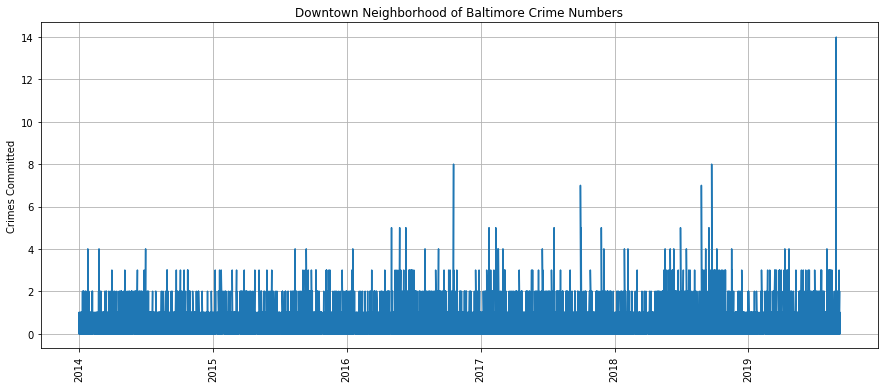

In [431]:
plt.figure(figsize=(15,6))
plt.plot(downtown_datetime_indexed.y)
plt.xticks(rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

[Return to contents](#Table-of-Contents)

### Zeroing in on a few months in which there were spikes of crime

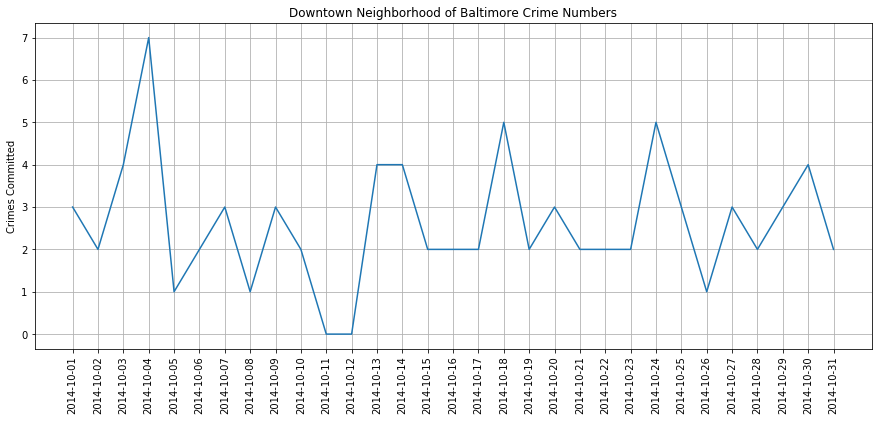

In [424]:
sliced = downtown_datetime_indexed['2014-10'].groupby('Date').sum()
plt.figure(figsize=(15,6))
plt.plot(sliced)
plt.xticks(sliced.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

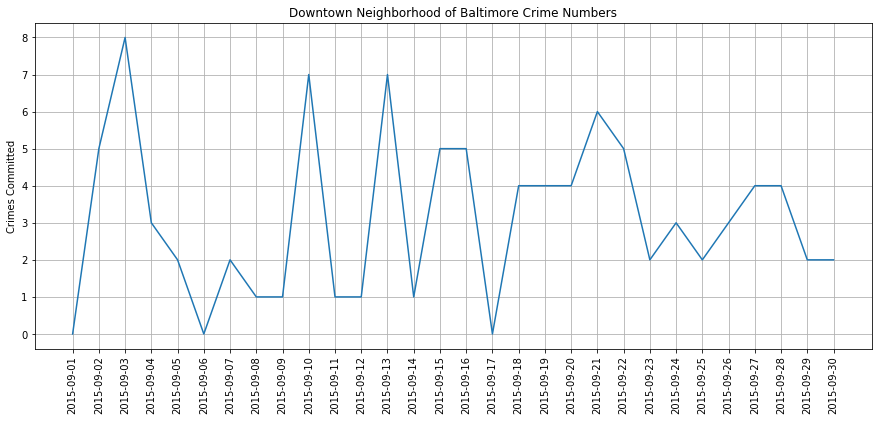

In [434]:
sliced = downtown_datetime_indexed['2015-09'].groupby('Date').sum()
plt.figure(figsize=(15,6))
plt.plot(sliced)
plt.xticks(sliced.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

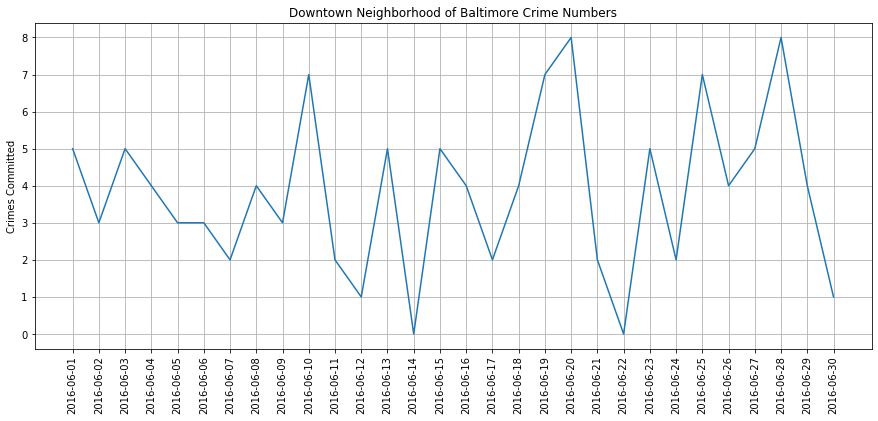

In [435]:
sliced = downtown_datetime_indexed['2016-06'].groupby('Date').sum()
plt.figure(figsize=(15,6))
plt.plot(sliced)
plt.xticks(sliced.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

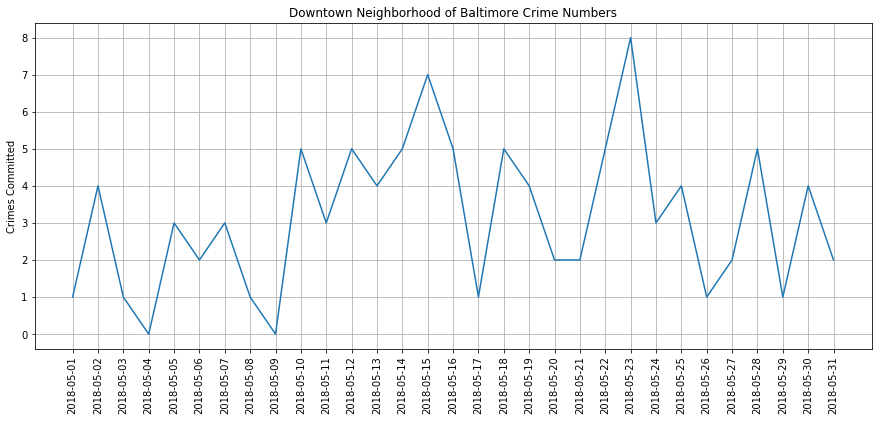

In [436]:
sliced = downtown_datetime_indexed['2018-05'].groupby('Date').sum()
plt.figure(figsize=(15,6))
plt.plot(sliced)
plt.xticks(sliced.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

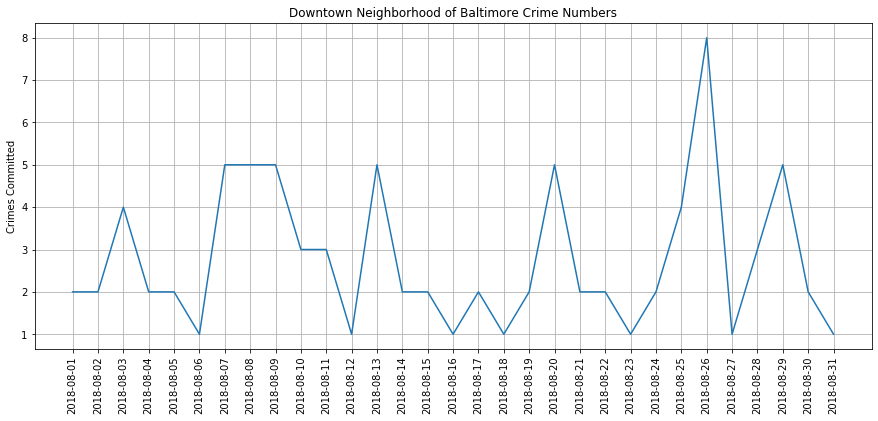

In [437]:
sliced = downtown_datetime_indexed['2018-08'].groupby('Date').sum()
plt.figure(figsize=(15,6))
plt.plot(sliced)
plt.xticks(sliced.index, rotation=90)
plt.ylabel('Crimes Committed')
plt.title('Downtown Neighborhood of Baltimore Crime Numbers')
plt.grid()
plt.show()

I have been unable to find specific events that effect crime in this area

[Return to contents](#Table-of-Contents)

### Using FaceBook Prophet to see what trends I can find

In [118]:
downtown_datetime_indexed.rename(columns= {'Count':'y'}, inplace=True)

In [119]:
downtown_datetime_indexed.columns

Index(['Neighborhood', 'y', 'Date', 'TimeSlot'], dtype='object')

In [120]:
downtown_datetime_indexed.head()

,Neighborhood,y,Date,TimeSlot
DateTime,,,,
2019-09-07 06:00:00,Downtown,0,2019-09-07,06:00:00
2019-09-07 15:00:00,Downtown,1,2019-09-07,15:00:00
2019-09-07 21:00:00,Downtown,0,2019-09-07,21:00:00
2019-09-07 00:00:00,Downtown,0,2019-09-07,00:00:00
2019-09-07 18:00:00,Downtown,0,2019-09-07,18:00:00


In [121]:
proph_ts = downtown_datetime_indexed.groupby('Date').sum()

In [122]:
proph_ts.head()

,y
Date,
2014-01-01,2
2014-01-02,1
2014-01-03,0
2014-01-04,1
2014-01-05,2


In [123]:
proph_ts['ds'] = proph_ts.index

In [124]:
proph_ts.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2076 entries, 2014-01-01 to 2019-09-07
Data columns (total 2 columns):
y     2076 non-null int64
ds    2076 non-null datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 48.7 KB


In [125]:
proph_ts.head()

,y,ds
Date,,
2014-01-01,2,2014-01-01
2014-01-02,1,2014-01-02
2014-01-03,0,2014-01-03
2014-01-04,1,2014-01-04
2014-01-05,2,2014-01-05


In [126]:
proph_ts.rename(columns={'Count': 'y'}, inplace=True)

In [136]:
model = proph()
model.add_country_holidays(country_name='US')

In [137]:
model.fit(proph_ts)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [138]:
predicted = model.predict(proph_ts)

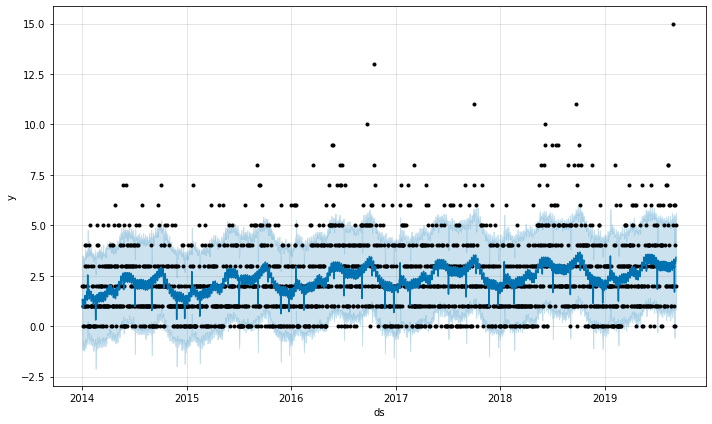

In [139]:
model.plot(predicted);

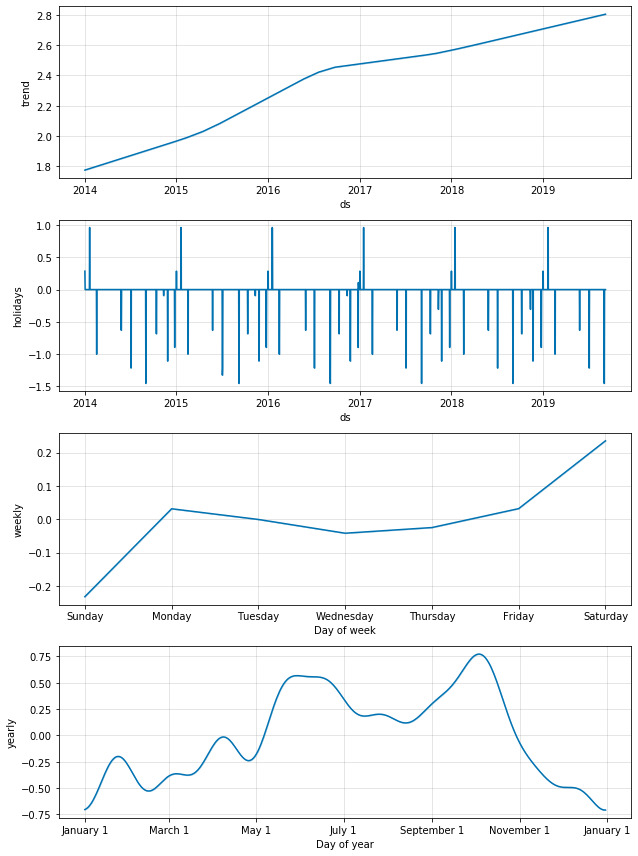

In [140]:
model.plot_components(predicted);

Besides an overall rising trend there is little I am able to infer from this that adds to what I have already seen

[Return to contents](#Table-of-Contents)

# Modeling

classify crime type for a few neighborhoods

In [170]:
df.groupby(['Neighborhood']).sum().drop(['Longitude', 'Latitude'], axis=1).sort_values(by='Count', ascending=False).head()

,Count
Neighborhood,
Downtown,8961
Frankford,6509
Belair-Edison,5929
Brooklyn,5076
Canton,3964


In [211]:
top_5_neighborhoods = df[(df['Neighborhood'] == 'Downtown') | (df['Neighborhood'] == 'Frankford') | (df['Neighborhood'] == 'Belair-Edison') | (df['Neighborhood'] == 'Brooklyn') | (df['Neighborhood'] == 'Canton')].copy()

In [212]:
top_5_neighborhoods.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,DateTime,Count
1,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET,15:00:00,2019-09-07 15:00:00,1
7,09/07/2019,01:12:00,6D,800 S ROBINSON ST,LARCENY FROM AUTO,O,none,232.0,SOUTHEAST,Canton,-76.572059,39.282955,STREET,00:00:00,2019-09-07 00:00:00,1
9,09/07/2019,15:00:00,6D,2500 HUDSON ST,LARCENY FROM AUTO,O,none,232.0,SOUTHEAST,Canton,-76.580759,39.282044,STREET,15:00:00,2019-09-07 15:00:00,1
11,09/07/2019,14:40:00,3AF,HOWARD ST & W SARATOGA ST,ROBBERY - STREET,O,FIREARM,111.0,CENTRAL,Downtown,-76.619666,39.292899,ALLEY,12:00:00,2019-09-07 12:00:00,1
31,09/07/2019,16:00:00,4E,200 E BALTIMORE ST,COMMON ASSAULT,I,none,111.0,CENTRAL,Downtown,-76.611856,39.289637,OTHER - INSIDE,15:00:00,2019-09-07 15:00:00,1


In [206]:
top_5_neighborhoods.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30439 entries, 1 to 273798
Data columns (total 14 columns):
CrimeTime         30439 non-null object
CrimeCode         30439 non-null object
Location          30439 non-null object
Description       30439 non-null object
Inside/Outside    30439 non-null object
Weapon            30439 non-null object
Post              30439 non-null object
District          30439 non-null object
Neighborhood      30439 non-null object
Longitude         30439 non-null float64
Latitude          30439 non-null float64
Premise           30439 non-null object
TimeSlot          30439 non-null object
Count             30439 non-null int64
dtypes: float64(2), int64(1), object(11)
memory usage: 3.5+ MB


In [215]:
le = LabelEncoder()

In [308]:
x = top_5_neighborhoods.drop(['Description', 'CrimeCode'], axis=1).apply(le.fit_transform)
y = top_5_neighborhoods.Description

In [309]:
x.head()

,CrimeDate,CrimeTime,Location,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,DateTime,Count
1,1504,964,698,1,2,0,0,3,345,4781,93,5,12868,0
7,1504,72,2515,1,5,14,4,2,5045,2947,93,0,12866,0
9,1504,875,514,1,5,14,4,2,3483,2674,93,5,12868,0
11,1504,855,2699,1,1,0,0,3,227,4758,0,4,12867,0
31,1504,935,356,0,5,0,0,3,878,4247,61,5,12868,0


In [310]:
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=.2)

In [311]:
clf = RandomForestClassifier()
param_grid = {
    "n_estimators": [10,50,100],
    "criterion": ["gini", "entropy"],
    "max_depth": [1, 2, 5, 10],
    "min_samples_leaf": [10, 11, 12, 15],
    "min_impurity_decrease": [.0001, .001, .01]
}
gs_tree = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy',  n_jobs=-1, verbose=2, return_train_score=True)
gs_tree.fit(X_train, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   21.4s
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:   54.5s
[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done 997 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done 1440 out of 1440 | elapsed:  7.1min finished


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

In [312]:
rf_gs = pd.DataFrame(gs_tree.cv_results_)
rf_gs.head(1)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_impurity_decrease,param_min_samples_leaf,param_n_estimators,params,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.113985,0.019929,0.0164,0.001023,gini,1,0.0001,10,10,"{'criterion': 'gini', 'max_depth': 1, 'min_imp...",...,0.283027,0.044763,256,0.329945,0.230568,0.294867,0.329826,0.230513,0.283144,0.044813


In [313]:
rf_gs.sort_values(by=['mean_test_score'], ascending=False).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_impurity_decrease,param_min_samples_leaf,param_n_estimators,params,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
254,9.004000,0.096089,0.156200,0.014756,entropy,10,0.0001,10,100,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.523264,0.005397,1,0.583385,0.581682,0.585780,0.579839,0.582080,0.582553,0.001973
113,5.648011,0.422997,0.238790,0.063430,gini,10,0.0001,11,100,"{'criterion': 'gini', 'max_depth': 10, 'min_im...",...,0.523182,0.005994,2,0.579174,0.577010,0.582290,0.573474,0.579207,0.578231,0.002913
256,4.610200,0.147324,0.079599,0.002153,entropy,10,0.0001,11,50,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.523100,0.008692,3,0.581228,0.578858,0.580441,0.574809,0.583055,0.579678,0.002785
257,9.389000,0.200540,0.199400,0.079333,entropy,10,0.0001,11,100,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.522771,0.005772,4,0.583847,0.577010,0.582700,0.578248,0.581465,0.580654,0.002612
112,2.376198,0.535047,0.114401,0.021564,gini,10,0.0001,11,50,"{'criterion': 'gini', 'max_depth': 10, 'min_im...",...,0.522278,0.005335,5,0.578969,0.571825,0.578131,0.574860,0.576538,0.576065,0.002544


In [321]:
rf = RandomForestClassifier(criterion='entropy', max_depth=10, min_impurity_decrease=.0001, min_samples_leaf=10, n_estimators=100, n_jobs=-1)

In [322]:
rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='entropy',
                       max_depth=10, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0001, min_impurity_split=None,
                       min_samples_leaf=10, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=None, verbose=0,
                       warm_start=False)

In [323]:
pred = rf.predict(X_test)

In [324]:
print(classification_report(pred, y_test))

                      precision    recall  f1-score   support

        AGG. ASSAULT       0.87      0.67      0.76       747
               ARSON       0.00      0.00      0.00         0
          AUTO THEFT       0.39      0.32      0.35       560
            BURGLARY       0.66      0.52      0.58       994
      COMMON ASSAULT       0.32      0.50      0.39       657
            HOMICIDE       0.00      0.00      0.00         0
             LARCENY       0.57      0.51      0.54      1609
   LARCENY FROM AUTO       0.64      0.54      0.58      1107
                RAPE       0.00      0.00      0.00         0
ROBBERY - CARJACKING       0.00      0.00      0.00         0
ROBBERY - COMMERCIAL       0.45      0.76      0.57        98
 ROBBERY - RESIDENCE       0.00      0.00      0.00         0
    ROBBERY - STREET       0.37      0.52      0.43       315
            SHOOTING       0.02      1.00      0.03         1

            accuracy                           0.52      6088
      

C:\Users\lraic\Anaconda3\envs\capstone-env\lib\site-packages\sklearn\metrics\classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [325]:
df.Description.unique()

array(['COMMON ASSAULT', 'AGG. ASSAULT', 'SHOOTING', 'AUTO THEFT',
       'LARCENY', 'LARCENY FROM AUTO', 'ROBBERY - STREET', 'BURGLARY',
       'HOMICIDE', 'ROBBERY - COMMERCIAL', 'ROBBERY - CARJACKING',
       'ROBBERY - RESIDENCE', 'RAPE', 'ARSON'], dtype=object)

[Text(0.5, 0, 'COMMON ASSAULT'),
 Text(1.5, 0, 'AGG. ASSAULT'),
 Text(2.5, 0, 'SHOOTING'),
 Text(3.5, 0, 'AUTO THEFT'),
 Text(4.5, 0, 'LARCENY'),
 Text(5.5, 0, 'LARCENY FROM AUTO'),
 Text(6.5, 0, 'ROBBERY - STREET'),
 Text(7.5, 0, 'BURGLARY'),
 Text(8.5, 0, 'HOMICIDE'),
 Text(9.5, 0, 'ROBBERY - COMMERCIAL'),
 Text(10.5, 0, 'ROBBERY - CARJACKING'),
 Text(11.5, 0, 'ROBBERY - RESIDENCE'),
 Text(12.5, 0, 'RAPE'),
 Text(13.5, 0, 'ARSON')]

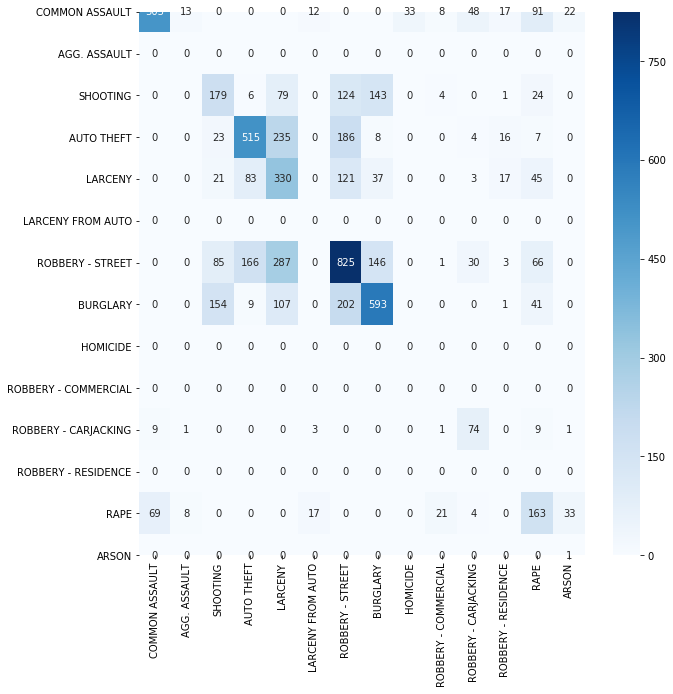

In [326]:
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(confusion_matrix(pred, y_test), cmap='Blues', annot=True, ax=ax, fmt='0')
ax.set_yticklabels(df.Description.unique(), rotation=0)
ax.set_xticklabels(df.Description.unique(), rotation=90)

In [327]:
pd.DataFrame(rf.feature_importances_, index=x.columns)

,0
CrimeDate,0.019782
CrimeTime,0.035860
Location,0.037225
Inside/Outside,0.171722
Weapon,0.428980
Post,0.029988
District,0.014863
Neighborhood,0.010668
Longitude,0.042582
Latitude,0.043412


Conclusion:  
Accuracy is not good for predicting the crime happening from the information I have

Trying to predict where a crime is occuring, not based on geographical features

In [280]:
top_5_neighborhoods.columns

Index(['CrimeDate', 'CrimeTime', 'CrimeCode', 'Location', 'Description',
       'Inside/Outside', 'Weapon', 'Post', 'District', 'Neighborhood',
       'Longitude', 'Latitude', 'Premise', 'TimeSlot', 'DateTime', 'Count'],
      dtype='object')

In [295]:
x2 = top_5_neighborhoods.drop(['Neighborhood', 'Location', 'Longitude', 'Latitude', 'District', 'Post'], axis=1).apply(le.fit_transform)
y2 = top_5_neighborhoods.Neighborhood

In [296]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(x2,y2, test_size=.2)

In [297]:
clf = RandomForestClassifier()
param_grid = {
    "n_estimators": [10,50,100],
    "criterion": ["gini", "entropy"],
    "max_depth": [1, 2, 5, 10],
    "min_samples_leaf": [10, 11, 12, 15],
    "min_impurity_decrease": [.0001, .001, .01]
}
gs_tree2 = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy',  n_jobs=-1, verbose=2, return_train_score=True)
gs_tree2.fit(X_train2, y_train2)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   11.2s
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:   31.1s
[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 997 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done 1440 out of 1440 | elapsed:  4.7min finished


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

In [298]:
rf_gs2 = pd.DataFrame(gs_tree.cv_results_)
rf_gs2.head(1)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_impurity_decrease,param_min_samples_leaf,param_n_estimators,params,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.113594,0.013246,0.0204,0.005164,gini,1,0.0001,10,10,"{'criterion': 'gini', 'max_depth': 1, 'min_imp...",...,0.386185,0.063448,270,0.331211,0.403224,0.36331,0.501386,0.33111,0.386048,0.063467


In [299]:
rf_gs2.sort_values(by=['mean_test_score'], ascending=False).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_impurity_decrease,param_min_samples_leaf,param_n_estimators,params,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
253,4.080083,0.239811,0.091200,0.006177,entropy,10,0.0001,10,50,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.952856,0.005472,1,0.963952,0.965500,0.959706,0.956374,0.958586,0.960824,0.003397
254,8.190963,0.345837,0.200414,0.027295,entropy,10,0.0001,10,100,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.952692,0.003299,2,0.956866,0.962162,0.963813,0.962790,0.963718,0.961870,0.002575
257,7.822883,0.270886,0.188402,0.023483,entropy,10,0.0001,11,100,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.952076,0.003690,3,0.960563,0.959852,0.959912,0.956118,0.959920,0.959273,0.001599
259,4.064156,0.368055,0.120304,0.030764,entropy,10,0.0001,12,50,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.951583,0.000899,4,0.959587,0.958466,0.958834,0.962071,0.954275,0.958647,0.002522
256,4.533450,0.288081,0.103599,0.032781,entropy,10,0.0001,11,50,"{'criterion': 'entropy', 'max_depth': 10, 'min...",...,0.951460,0.005470,5,0.960357,0.965448,0.960271,0.963662,0.948168,0.959581,0.006040


In [314]:
rf2 = RandomForestClassifier(criterion='entropy', max_depth=10, min_impurity_decrease=.0001, min_samples_leaf=10, n_estimators=100, n_jobs=-1)

In [315]:
rf2.fit(X_train2, y_train2)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='entropy',
                       max_depth=10, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0001, min_impurity_split=None,
                       min_samples_leaf=10, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=None, verbose=0,
                       warm_start=False)

In [316]:
pred2 = rf2.predict(X_test2)

In [317]:
print(classification_report(pred2, y_test2))

               precision    recall  f1-score   support

Belair-Edison       0.41      0.37      0.39      1336
     Brooklyn       0.13      0.37      0.19       355
       Canton       0.26      0.36      0.30       584
     Downtown       0.77      0.52      0.63      2686
    Frankford       0.39      0.44      0.41      1127

     accuracy                           0.45      6088
    macro avg       0.39      0.41      0.38      6088
 weighted avg       0.54      0.45      0.48      6088



In [318]:
top_5_neighborhoods.Neighborhood.unique()

array(['Downtown', 'Canton', 'Brooklyn', 'Belair-Edison', 'Frankford'],
      dtype=object)

[Text(0.5, 0, 'Downtown'),
 Text(1.5, 0, 'Canton'),
 Text(2.5, 0, 'Brooklyn'),
 Text(3.5, 0, 'Belair-Edison'),
 Text(4.5, 0, 'Frankford')]

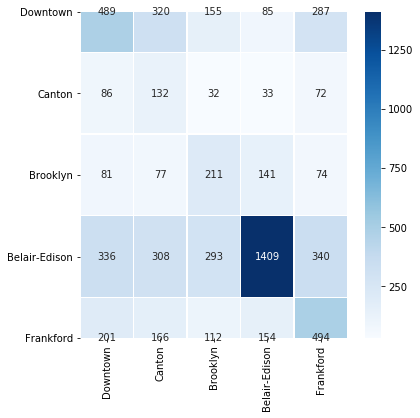

In [319]:
fig, ax = plt.subplots(figsize=(6,6))
ax = sns.heatmap(confusion_matrix(pred2, y_test2), cmap='Blues', annot=True, ax=ax, fmt='0', linewidths=.5)
ax.set_yticklabels(top_5_neighborhoods.Neighborhood.unique(), rotation=0)
ax.set_xticklabels(top_5_neighborhoods.Neighborhood.unique(), rotation=90)

In [320]:
pd.DataFrame(rf2.feature_importances_, index=x2.columns)

,0
CrimeDate,0.083472
CrimeTime,0.097495
CrimeCode,0.178126
Description,0.108116
Inside/Outside,0.059910
Weapon,0.036794
Premise,0.291097
TimeSlot,0.037551
DateTime,0.107439
Count,0.000000


Conclusion:
Accuracy is not good for predicting the crime happening from the information I have

[Return to contents](#Table-of-Contents)

**Preparing data for my Dashboard**

In [332]:
df_datetime.head()

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,Count
DateTime,,,,,,,,,,,,,,,
2019-09-07 06:00:00,09/07/2019,08:53:00,4E,1000 N MOUNT ST,COMMON ASSAULT,I,none,743.0,WESTERN,Sandtown-Winchester,-76.644485,39.300357,ROW/TOWNHOUSE-OCC,06:00:00,1
2019-09-07 15:00:00,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET,15:00:00,1
2019-09-07 21:00:00,09/07/2019,23:22:33,9S,2900 JEFFERSON ST,SHOOTING,O,FIREARM,224.0,SOUTHEAST,Ellwood Park/Monument,-76.576075,39.297009,STREET,21:00:00,1
2019-09-07 21:00:00,09/07/2019,22:59:00,7A,1100 N PATTERSON PARK AVE,AUTO THEFT,O,none,322.0,EASTERN,Middle East,-76.585487,39.303928,STREET,21:00:00,1
2019-09-07 00:00:00,09/07/2019,00:15:00,6G,100 ALLENDALE ST,LARCENY,I,none,843.0,SOUTHWEST,Allendale,-76.678216,39.290278,ROW/TOWNHOUSE-OCC,00:00:00,1


In [406]:
df_from_2014 = df.copy()

In [407]:
for index, row in df_from_2014[df_from_2014['Neighborhood'] == 'Care'].iterrows():
    df_from_2014.at[index, 'Neighborhood'] = 'CARE'

In [408]:
df_from_2014[df_from_2014['Neighborhood'] == 'CARE']

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,DateTime,Count
172,09/05/2019,17:51:00,3B,2200 E MONUMENT ST,ROBBERY - STREET,I,none,321.0,EASTERN,CARE,-76.585862,39.298666,ROW/TOWNHOUSE-OCC,15:00:00,2019-09-05 15:00:00,1
560,09/02/2019,13:04:00,3K,2000 JEFFERSON ST,ROBBERY - RESIDENCE,I,none,321.0,EASTERN,CARE,-76.588233,39.296461,ROW/TOWNHOUSE-OCC,12:00:00,2019-09-02 12:00:00,1
822,08/31/2019,02:29:00,6D,2100 ORLEANS ST,LARCENY FROM AUTO,I,none,321.0,EASTERN,CARE,-76.587214,39.295443,ROW/TOWNHOUSE-OCC,00:00:00,2019-08-31 00:00:00,1
1090,08/29/2019,15:00:00,5A,600 N COLLINGTON AVE,BURGLARY,I,none,321.0,EASTERN,CARE,-76.586601,39.298340,ROW/TOWNHOUSE-VAC,15:00:00,2019-08-29 15:00:00,1
1173,08/28/2019,05:00:00,6D,FAYETTE ST & N CHESTER ST,LARCENY FROM AUTO,I,none,321.0,EASTERN,CARE,-76.587564,39.294185,ROW/TOWNHOUSE-OCC,03:00:00,2019-08-28 03:00:00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273177,01/06/2014,10:00:00,5A,200 N CHESTER ST,BURGLARY,I,none,321.0,EASTERN,CARE,-76.587638,39.294868,ROW/TOWNHOUSE-OCC,09:00:00,2014-01-06 09:00:00,1
273202,01/05/2014,14:00:00,6D,400 N COLLINGTON AV,LARCENY FROM AUTO,O,none,321.0,EASTERN,CARE,-76.586512,39.295847,STREET,12:00:00,2014-01-05 12:00:00,1
273321,01/04/2014,13:30:00,5C,2100 ORLEANS ST,BURGLARY,I,none,321.0,EASTERN,CARE,-76.587548,39.295387,ROW/TOWNHOUSE-OCC,12:00:00,2014-01-04 12:00:00,1
273338,01/04/2014,13:30:00,5C,2100 ORLEANS ST,BURGLARY,I,none,321.0,EASTERN,CARE,-76.586899,39.295462,ROW/TOWNHOUSE-OCC,12:00:00,2014-01-04 12:00:00,1


In [409]:
df_from_2014 = df_from_2014.set_index('DateTime')

In [410]:
df_from_2014 = df_from_2014['2014':]

In [413]:
df_from_2014['DateTime'] = df_from_2014.index

In [415]:
df_from_2014

,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Premise,TimeSlot,Count,DateTime
DateTime,,,,,,,,,,,,,,,,
2019-09-07 06:00:00,09/07/2019,08:53:00,4E,1000 N MOUNT ST,COMMON ASSAULT,I,none,743.0,WESTERN,Sandtown-Winchester,-76.644485,39.300357,ROW/TOWNHOUSE-OCC,06:00:00,1,2019-09-07 06:00:00
2019-09-07 15:00:00,09/07/2019,16:29:00,4D,300 PARK AVE,AGG. ASSAULT,O,HANDS,111.0,CENTRAL,Downtown,-76.618155,39.292978,STREET,15:00:00,1,2019-09-07 15:00:00
2019-09-07 21:00:00,09/07/2019,23:22:33,9S,2900 JEFFERSON ST,SHOOTING,O,FIREARM,224.0,SOUTHEAST,Ellwood Park/Monument,-76.576075,39.297009,STREET,21:00:00,1,2019-09-07 21:00:00
2019-09-07 21:00:00,09/07/2019,22:59:00,7A,1100 N PATTERSON PARK AVE,AUTO THEFT,O,none,322.0,EASTERN,Middle East,-76.585487,39.303928,STREET,21:00:00,1,2019-09-07 21:00:00
2019-09-07 00:00:00,09/07/2019,00:15:00,6G,100 ALLENDALE ST,LARCENY,I,none,843.0,SOUTHWEST,Allendale,-76.678216,39.290278,ROW/TOWNHOUSE-OCC,00:00:00,1,2019-09-07 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-01-01 12:00:00,01/01/2014,12:09:00,3K,4000 BAREVA RD,ROBBERY - RESIDENCE,I,none,643.0,NORTHWEST,East Arlington,-76.671166,39.334231,ROW/TOWNHOUSE-OCC,12:00:00,1,2014-01-01 12:00:00
2014-01-01 03:00:00,01/01/2014,05:52:00,4B,2200 GOUGH ST,AGG. ASSAULT,O,KNIFE,212.0,SOUTHEAST,Upper Fells Point,-76.585945,39.287979,STREET,03:00:00,1,2014-01-01 03:00:00
2014-01-01 03:00:00,01/01/2014,05:52:00,4B,2200 GOUGH ST,AGG. ASSAULT,O,KNIFE,212.0,SOUTHEAST,Upper Fells Point,-76.585945,39.287979,STREET,03:00:00,1,2014-01-01 03:00:00


In [414]:
df_from_2014.to_csv('Baltimore_crime_for_dashboard.csv', index = False)

In [467]:
len(df.Neighborhood.unique())

278